# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

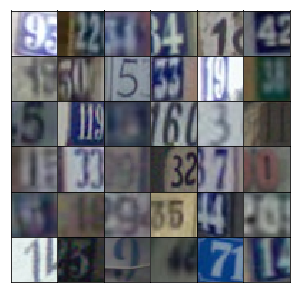

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(x1 * alpha, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(x2 * alpha, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(x3 * alpha, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha* x1 , x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha* bn2 , bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha* bn2 , bn2)
        
        
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4543... Generator Loss: 0.6166
Epoch 1/25... Discriminator Loss: 0.3323... Generator Loss: 2.1881
Epoch 1/25... Discriminator Loss: 0.2423... Generator Loss: 1.8801
Epoch 1/25... Discriminator Loss: 0.1284... Generator Loss: 3.0645
Epoch 1/25... Discriminator Loss: 0.1146... Generator Loss: 3.0582
Epoch 1/25... Discriminator Loss: 0.0781... Generator Loss: 3.2568
Epoch 1/25... Discriminator Loss: 0.1267... Generator Loss: 2.9301
Epoch 1/25... Discriminator Loss: 0.1698... Generator Loss: 2.9303
Epoch 1/25... Discriminator Loss: 0.1312... Generator Loss: 3.1357
Epoch 1/25... Discriminator Loss: 0.1059... Generator Loss: 6.3989


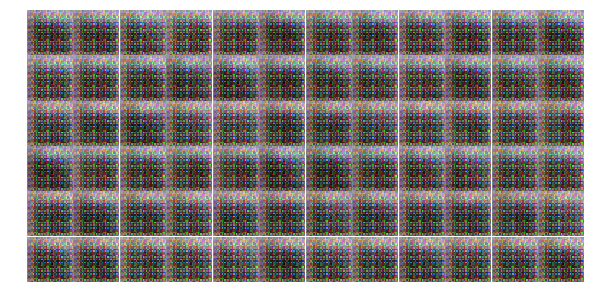

Epoch 1/25... Discriminator Loss: 0.0663... Generator Loss: 3.4424
Epoch 1/25... Discriminator Loss: 0.3580... Generator Loss: 3.7727
Epoch 1/25... Discriminator Loss: 0.5324... Generator Loss: 1.6252
Epoch 1/25... Discriminator Loss: 0.5305... Generator Loss: 1.7262
Epoch 1/25... Discriminator Loss: 0.8431... Generator Loss: 0.8899
Epoch 1/25... Discriminator Loss: 0.5261... Generator Loss: 2.6131
Epoch 1/25... Discriminator Loss: 0.4785... Generator Loss: 2.8068
Epoch 1/25... Discriminator Loss: 0.3498... Generator Loss: 1.6869
Epoch 1/25... Discriminator Loss: 0.4109... Generator Loss: 1.7149
Epoch 1/25... Discriminator Loss: 0.3697... Generator Loss: 1.6940


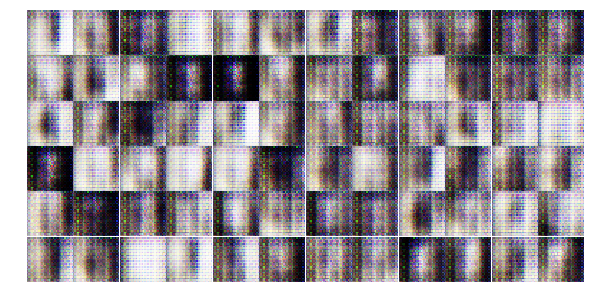

Epoch 1/25... Discriminator Loss: 0.1942... Generator Loss: 2.5666
Epoch 1/25... Discriminator Loss: 0.5152... Generator Loss: 1.9506
Epoch 1/25... Discriminator Loss: 1.1664... Generator Loss: 0.6517
Epoch 1/25... Discriminator Loss: 0.7552... Generator Loss: 4.9803
Epoch 1/25... Discriminator Loss: 1.0239... Generator Loss: 1.0187
Epoch 1/25... Discriminator Loss: 0.5272... Generator Loss: 2.5563
Epoch 1/25... Discriminator Loss: 0.4235... Generator Loss: 4.4586
Epoch 1/25... Discriminator Loss: 0.8080... Generator Loss: 0.9893
Epoch 1/25... Discriminator Loss: 0.9910... Generator Loss: 0.7936
Epoch 1/25... Discriminator Loss: 0.7991... Generator Loss: 1.3451


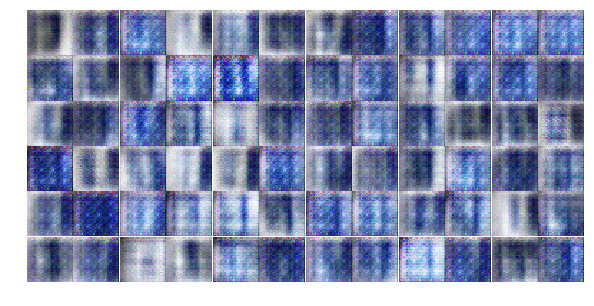

Epoch 1/25... Discriminator Loss: 0.7867... Generator Loss: 1.5175
Epoch 1/25... Discriminator Loss: 0.9318... Generator Loss: 1.0171
Epoch 1/25... Discriminator Loss: 1.1857... Generator Loss: 1.0639
Epoch 1/25... Discriminator Loss: 0.5437... Generator Loss: 1.7009
Epoch 1/25... Discriminator Loss: 0.3961... Generator Loss: 2.8429
Epoch 1/25... Discriminator Loss: 1.3127... Generator Loss: 0.4731
Epoch 1/25... Discriminator Loss: 0.3348... Generator Loss: 2.0767
Epoch 1/25... Discriminator Loss: 0.6003... Generator Loss: 2.2522
Epoch 1/25... Discriminator Loss: 0.5207... Generator Loss: 1.6198
Epoch 1/25... Discriminator Loss: 0.5686... Generator Loss: 1.9034


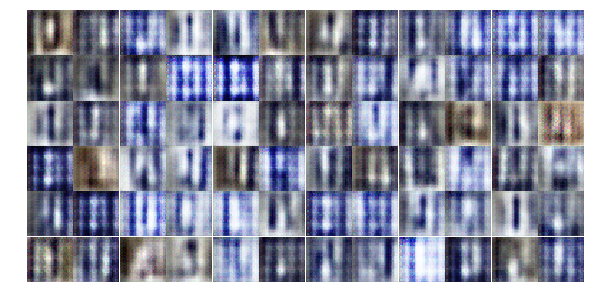

Epoch 1/25... Discriminator Loss: 0.3871... Generator Loss: 2.3589
Epoch 1/25... Discriminator Loss: 0.8663... Generator Loss: 1.0940
Epoch 1/25... Discriminator Loss: 0.7204... Generator Loss: 1.2583
Epoch 1/25... Discriminator Loss: 1.1502... Generator Loss: 0.7295
Epoch 1/25... Discriminator Loss: 0.7801... Generator Loss: 1.1862
Epoch 1/25... Discriminator Loss: 0.9926... Generator Loss: 0.9866
Epoch 1/25... Discriminator Loss: 0.5916... Generator Loss: 1.5722
Epoch 1/25... Discriminator Loss: 0.8796... Generator Loss: 1.1298
Epoch 1/25... Discriminator Loss: 0.8783... Generator Loss: 0.8081
Epoch 1/25... Discriminator Loss: 0.9806... Generator Loss: 1.3845


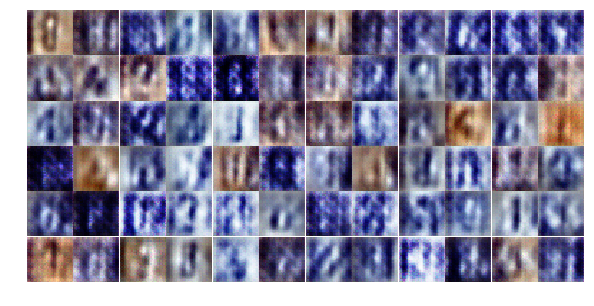

Epoch 1/25... Discriminator Loss: 0.8758... Generator Loss: 0.9116
Epoch 1/25... Discriminator Loss: 0.6676... Generator Loss: 1.2006
Epoch 1/25... Discriminator Loss: 0.8026... Generator Loss: 1.7002
Epoch 1/25... Discriminator Loss: 1.2096... Generator Loss: 0.7110
Epoch 1/25... Discriminator Loss: 0.8856... Generator Loss: 1.2931
Epoch 1/25... Discriminator Loss: 1.0071... Generator Loss: 1.3764
Epoch 1/25... Discriminator Loss: 0.8144... Generator Loss: 1.5579
Epoch 2/25... Discriminator Loss: 0.7567... Generator Loss: 1.3804
Epoch 2/25... Discriminator Loss: 0.7127... Generator Loss: 1.5909
Epoch 2/25... Discriminator Loss: 0.9546... Generator Loss: 0.9225


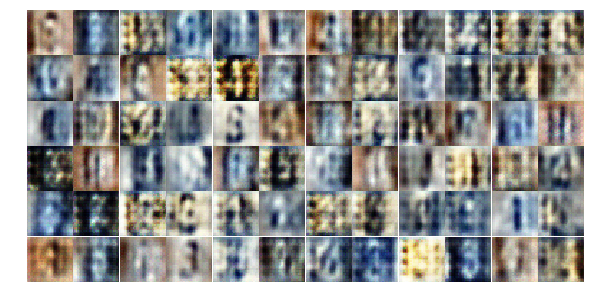

Epoch 2/25... Discriminator Loss: 1.0381... Generator Loss: 1.2538
Epoch 2/25... Discriminator Loss: 0.9321... Generator Loss: 1.0341
Epoch 2/25... Discriminator Loss: 1.1087... Generator Loss: 0.9123
Epoch 2/25... Discriminator Loss: 1.2200... Generator Loss: 1.0876
Epoch 2/25... Discriminator Loss: 1.3225... Generator Loss: 0.9027
Epoch 2/25... Discriminator Loss: 0.7034... Generator Loss: 1.4304
Epoch 2/25... Discriminator Loss: 0.8836... Generator Loss: 1.1331
Epoch 2/25... Discriminator Loss: 0.9020... Generator Loss: 1.2294
Epoch 2/25... Discriminator Loss: 1.2524... Generator Loss: 0.5332
Epoch 2/25... Discriminator Loss: 0.7984... Generator Loss: 1.1380


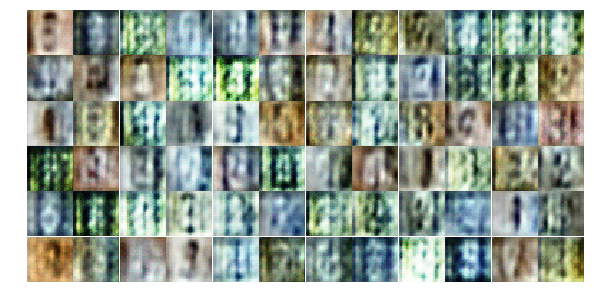

Epoch 2/25... Discriminator Loss: 1.0361... Generator Loss: 0.7859
Epoch 2/25... Discriminator Loss: 0.7869... Generator Loss: 1.2447
Epoch 2/25... Discriminator Loss: 0.6973... Generator Loss: 2.0567
Epoch 2/25... Discriminator Loss: 1.0866... Generator Loss: 0.8233
Epoch 2/25... Discriminator Loss: 1.0984... Generator Loss: 1.0384
Epoch 2/25... Discriminator Loss: 1.4423... Generator Loss: 0.6046
Epoch 2/25... Discriminator Loss: 1.1684... Generator Loss: 0.8147
Epoch 2/25... Discriminator Loss: 1.0765... Generator Loss: 1.0248
Epoch 2/25... Discriminator Loss: 0.9856... Generator Loss: 1.0425
Epoch 2/25... Discriminator Loss: 1.4802... Generator Loss: 0.5677


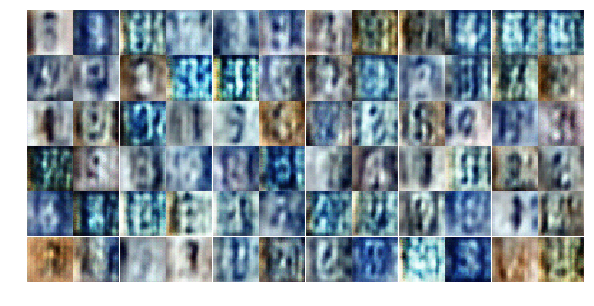

Epoch 2/25... Discriminator Loss: 1.1274... Generator Loss: 0.7482
Epoch 2/25... Discriminator Loss: 1.4612... Generator Loss: 0.5726
Epoch 2/25... Discriminator Loss: 1.1020... Generator Loss: 1.0082
Epoch 2/25... Discriminator Loss: 1.0218... Generator Loss: 1.2871
Epoch 2/25... Discriminator Loss: 1.1411... Generator Loss: 1.1210
Epoch 2/25... Discriminator Loss: 1.1293... Generator Loss: 1.2783
Epoch 2/25... Discriminator Loss: 1.0042... Generator Loss: 1.2018
Epoch 2/25... Discriminator Loss: 1.0452... Generator Loss: 0.8386
Epoch 2/25... Discriminator Loss: 1.1986... Generator Loss: 0.8079
Epoch 2/25... Discriminator Loss: 1.3645... Generator Loss: 0.9050


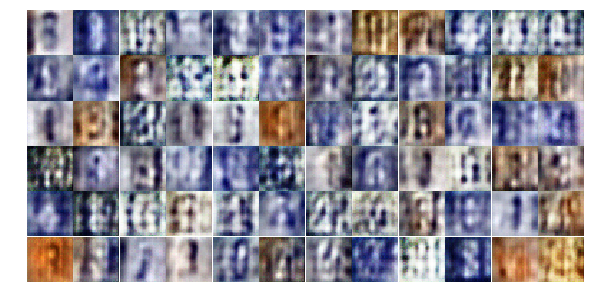

Epoch 2/25... Discriminator Loss: 1.3067... Generator Loss: 0.8377
Epoch 2/25... Discriminator Loss: 1.1285... Generator Loss: 0.9456
Epoch 2/25... Discriminator Loss: 1.0927... Generator Loss: 0.9854
Epoch 2/25... Discriminator Loss: 0.8978... Generator Loss: 1.0954
Epoch 2/25... Discriminator Loss: 0.9336... Generator Loss: 0.8668
Epoch 2/25... Discriminator Loss: 1.6084... Generator Loss: 0.6316
Epoch 2/25... Discriminator Loss: 1.3337... Generator Loss: 0.7597
Epoch 2/25... Discriminator Loss: 1.1626... Generator Loss: 1.0018
Epoch 2/25... Discriminator Loss: 1.3658... Generator Loss: 0.8104
Epoch 2/25... Discriminator Loss: 1.1617... Generator Loss: 0.8257


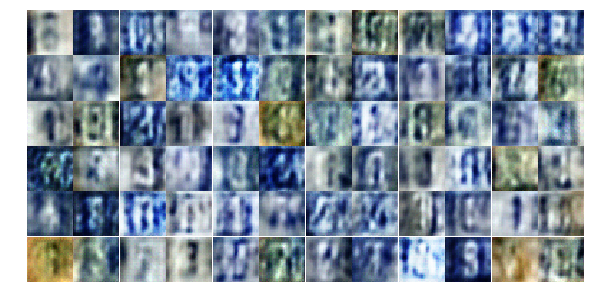

Epoch 2/25... Discriminator Loss: 0.8627... Generator Loss: 1.0080
Epoch 2/25... Discriminator Loss: 1.1673... Generator Loss: 1.1562
Epoch 2/25... Discriminator Loss: 0.8597... Generator Loss: 0.8393
Epoch 2/25... Discriminator Loss: 1.2507... Generator Loss: 0.8434
Epoch 2/25... Discriminator Loss: 1.3221... Generator Loss: 0.7735
Epoch 2/25... Discriminator Loss: 1.2440... Generator Loss: 0.7069
Epoch 2/25... Discriminator Loss: 1.1052... Generator Loss: 0.9504
Epoch 2/25... Discriminator Loss: 0.9911... Generator Loss: 0.9316
Epoch 2/25... Discriminator Loss: 0.8091... Generator Loss: 1.1263
Epoch 2/25... Discriminator Loss: 1.3337... Generator Loss: 0.8900


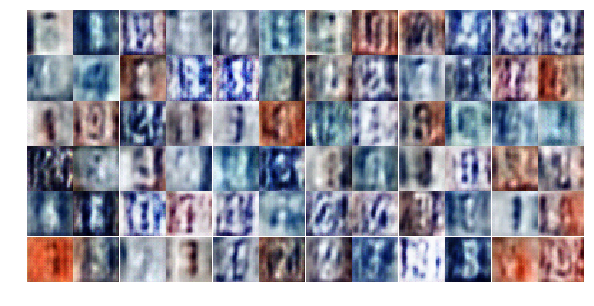

Epoch 2/25... Discriminator Loss: 1.1770... Generator Loss: 1.2809
Epoch 2/25... Discriminator Loss: 1.0246... Generator Loss: 1.2289
Epoch 2/25... Discriminator Loss: 1.2629... Generator Loss: 0.6622
Epoch 2/25... Discriminator Loss: 1.3056... Generator Loss: 0.7779
Epoch 3/25... Discriminator Loss: 0.9387... Generator Loss: 1.5183
Epoch 3/25... Discriminator Loss: 1.0536... Generator Loss: 1.0443
Epoch 3/25... Discriminator Loss: 0.8744... Generator Loss: 1.1134
Epoch 3/25... Discriminator Loss: 1.2051... Generator Loss: 0.9032
Epoch 3/25... Discriminator Loss: 0.9164... Generator Loss: 1.1959
Epoch 3/25... Discriminator Loss: 0.9366... Generator Loss: 1.1789


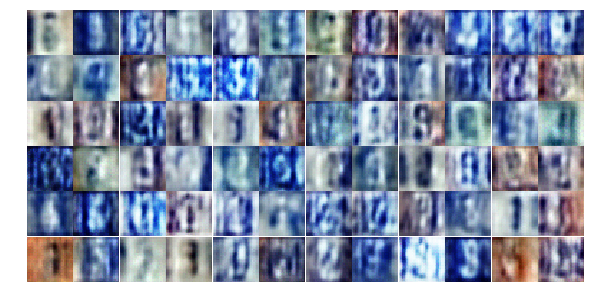

Epoch 3/25... Discriminator Loss: 1.1077... Generator Loss: 1.0920
Epoch 3/25... Discriminator Loss: 1.4668... Generator Loss: 0.4209
Epoch 3/25... Discriminator Loss: 0.7539... Generator Loss: 1.6008
Epoch 3/25... Discriminator Loss: 1.1310... Generator Loss: 1.2440
Epoch 3/25... Discriminator Loss: 0.9879... Generator Loss: 0.9830
Epoch 3/25... Discriminator Loss: 1.0191... Generator Loss: 0.8875
Epoch 3/25... Discriminator Loss: 1.0222... Generator Loss: 1.0186
Epoch 3/25... Discriminator Loss: 0.9075... Generator Loss: 1.1650
Epoch 3/25... Discriminator Loss: 1.3542... Generator Loss: 0.4150
Epoch 3/25... Discriminator Loss: 1.0441... Generator Loss: 0.6943


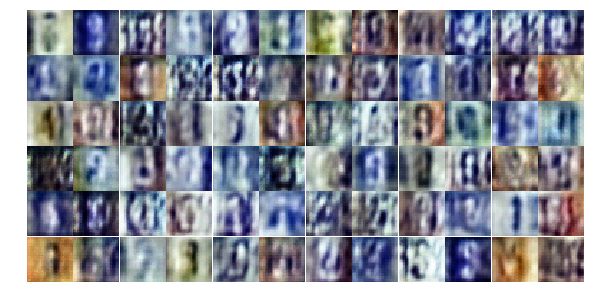

Epoch 3/25... Discriminator Loss: 1.0249... Generator Loss: 1.0151
Epoch 3/25... Discriminator Loss: 0.7362... Generator Loss: 1.2738
Epoch 3/25... Discriminator Loss: 0.7690... Generator Loss: 1.5629
Epoch 3/25... Discriminator Loss: 0.8356... Generator Loss: 1.1934
Epoch 3/25... Discriminator Loss: 1.0408... Generator Loss: 1.1227
Epoch 3/25... Discriminator Loss: 0.9028... Generator Loss: 1.4215
Epoch 3/25... Discriminator Loss: 0.9458... Generator Loss: 1.1918
Epoch 3/25... Discriminator Loss: 0.7734... Generator Loss: 1.3220
Epoch 3/25... Discriminator Loss: 0.9321... Generator Loss: 1.3187
Epoch 3/25... Discriminator Loss: 0.8287... Generator Loss: 1.0133


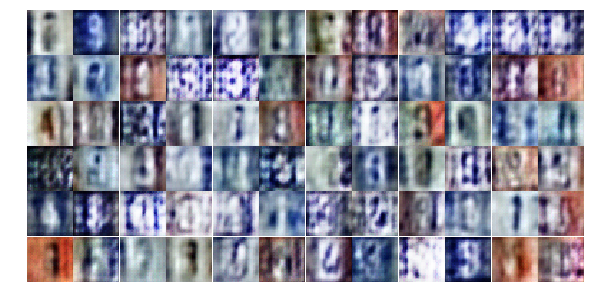

Epoch 3/25... Discriminator Loss: 0.8265... Generator Loss: 1.4975
Epoch 3/25... Discriminator Loss: 0.7274... Generator Loss: 1.3892
Epoch 3/25... Discriminator Loss: 1.2889... Generator Loss: 0.6738
Epoch 3/25... Discriminator Loss: 1.1068... Generator Loss: 0.5331
Epoch 3/25... Discriminator Loss: 0.9638... Generator Loss: 0.9152
Epoch 3/25... Discriminator Loss: 0.9096... Generator Loss: 1.2708
Epoch 3/25... Discriminator Loss: 0.7978... Generator Loss: 1.1527
Epoch 3/25... Discriminator Loss: 0.9509... Generator Loss: 0.7845
Epoch 3/25... Discriminator Loss: 0.5854... Generator Loss: 1.5793
Epoch 3/25... Discriminator Loss: 0.6385... Generator Loss: 1.3463


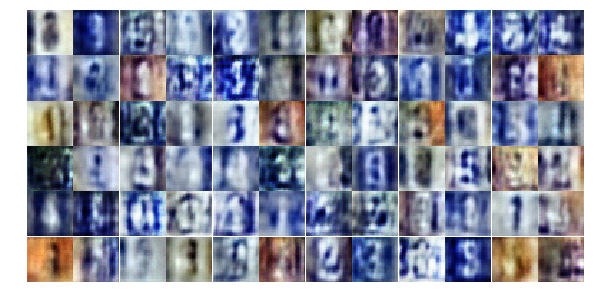

Epoch 3/25... Discriminator Loss: 0.6967... Generator Loss: 1.6753
Epoch 3/25... Discriminator Loss: 0.4390... Generator Loss: 1.9790
Epoch 3/25... Discriminator Loss: 0.4076... Generator Loss: 1.6674
Epoch 3/25... Discriminator Loss: 0.7413... Generator Loss: 0.9842
Epoch 3/25... Discriminator Loss: 0.5761... Generator Loss: 2.4431
Epoch 3/25... Discriminator Loss: 1.1380... Generator Loss: 0.6659
Epoch 3/25... Discriminator Loss: 0.8050... Generator Loss: 1.0927
Epoch 3/25... Discriminator Loss: 0.7968... Generator Loss: 1.1167
Epoch 3/25... Discriminator Loss: 0.6643... Generator Loss: 1.4112
Epoch 3/25... Discriminator Loss: 0.7168... Generator Loss: 1.3569


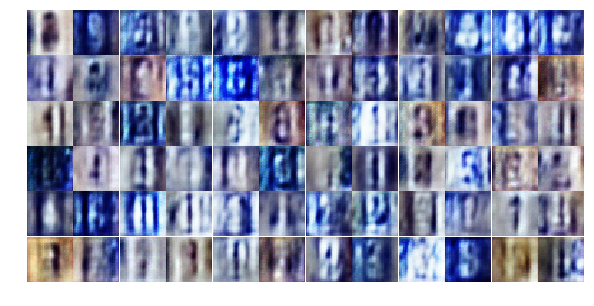

Epoch 3/25... Discriminator Loss: 0.8562... Generator Loss: 0.8944
Epoch 3/25... Discriminator Loss: 0.5035... Generator Loss: 1.4816
Epoch 3/25... Discriminator Loss: 1.2128... Generator Loss: 0.5376
Epoch 3/25... Discriminator Loss: 0.6283... Generator Loss: 1.6252
Epoch 3/25... Discriminator Loss: 0.8229... Generator Loss: 0.9203
Epoch 3/25... Discriminator Loss: 0.3853... Generator Loss: 2.4827
Epoch 3/25... Discriminator Loss: 0.7395... Generator Loss: 1.4113
Epoch 3/25... Discriminator Loss: 0.3711... Generator Loss: 2.0837
Epoch 3/25... Discriminator Loss: 0.6569... Generator Loss: 1.1367
Epoch 3/25... Discriminator Loss: 0.4730... Generator Loss: 1.5464


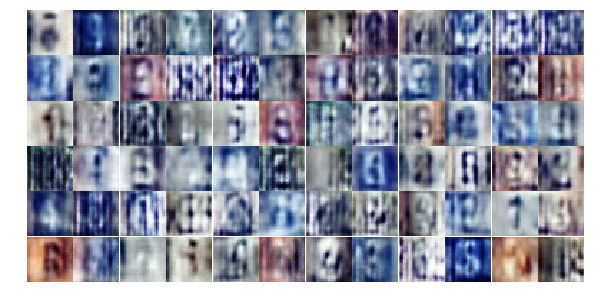

Epoch 3/25... Discriminator Loss: 0.7439... Generator Loss: 0.9396
Epoch 4/25... Discriminator Loss: 0.8316... Generator Loss: 0.8820
Epoch 4/25... Discriminator Loss: 1.0396... Generator Loss: 2.3974
Epoch 4/25... Discriminator Loss: 0.9657... Generator Loss: 0.7027
Epoch 4/25... Discriminator Loss: 0.5345... Generator Loss: 1.4006
Epoch 4/25... Discriminator Loss: 0.5447... Generator Loss: 1.3898
Epoch 4/25... Discriminator Loss: 0.4093... Generator Loss: 1.9936
Epoch 4/25... Discriminator Loss: 0.4387... Generator Loss: 2.3569
Epoch 4/25... Discriminator Loss: 0.5027... Generator Loss: 1.3558
Epoch 4/25... Discriminator Loss: 0.4674... Generator Loss: 1.4456


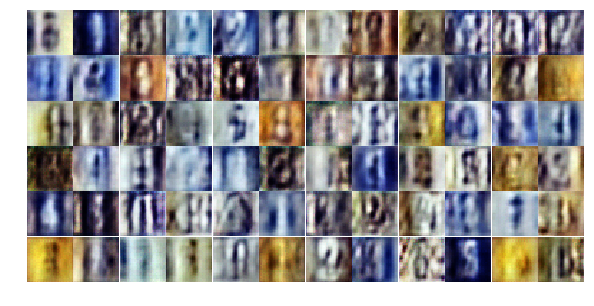

Epoch 4/25... Discriminator Loss: 0.5322... Generator Loss: 1.5158
Epoch 4/25... Discriminator Loss: 0.4900... Generator Loss: 1.6120
Epoch 4/25... Discriminator Loss: 0.9723... Generator Loss: 0.8904
Epoch 4/25... Discriminator Loss: 0.4426... Generator Loss: 1.4864
Epoch 4/25... Discriminator Loss: 1.1796... Generator Loss: 3.3796
Epoch 4/25... Discriminator Loss: 3.1020... Generator Loss: 0.0616
Epoch 4/25... Discriminator Loss: 0.8911... Generator Loss: 0.8190
Epoch 4/25... Discriminator Loss: 0.6992... Generator Loss: 1.3729
Epoch 4/25... Discriminator Loss: 0.9129... Generator Loss: 1.7864
Epoch 4/25... Discriminator Loss: 0.6956... Generator Loss: 1.9974


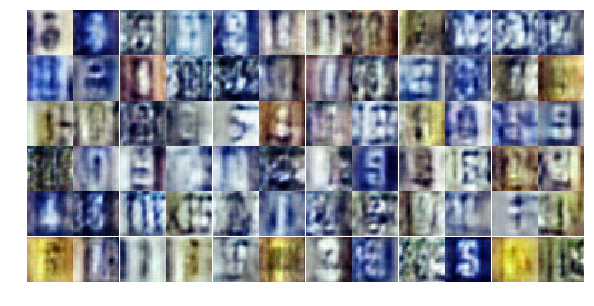

Epoch 4/25... Discriminator Loss: 0.5861... Generator Loss: 1.6576
Epoch 4/25... Discriminator Loss: 0.5992... Generator Loss: 2.0157
Epoch 4/25... Discriminator Loss: 0.9511... Generator Loss: 0.7858
Epoch 4/25... Discriminator Loss: 0.6138... Generator Loss: 1.1375
Epoch 4/25... Discriminator Loss: 0.5268... Generator Loss: 2.1928
Epoch 4/25... Discriminator Loss: 0.7769... Generator Loss: 1.1205
Epoch 4/25... Discriminator Loss: 1.0464... Generator Loss: 0.6084
Epoch 4/25... Discriminator Loss: 0.6582... Generator Loss: 1.0741
Epoch 4/25... Discriminator Loss: 0.6096... Generator Loss: 1.4588
Epoch 4/25... Discriminator Loss: 0.8257... Generator Loss: 0.8520


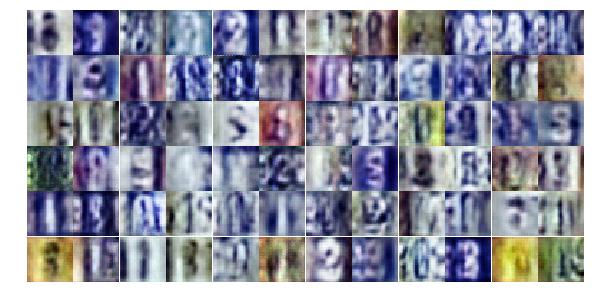

Epoch 4/25... Discriminator Loss: 0.4970... Generator Loss: 1.4426
Epoch 4/25... Discriminator Loss: 0.7413... Generator Loss: 0.9857
Epoch 4/25... Discriminator Loss: 0.7576... Generator Loss: 0.9165
Epoch 4/25... Discriminator Loss: 0.5367... Generator Loss: 2.1863
Epoch 4/25... Discriminator Loss: 0.4280... Generator Loss: 2.2793
Epoch 4/25... Discriminator Loss: 0.6895... Generator Loss: 1.4507
Epoch 4/25... Discriminator Loss: 0.8723... Generator Loss: 0.9281
Epoch 4/25... Discriminator Loss: 1.1301... Generator Loss: 0.6170
Epoch 4/25... Discriminator Loss: 0.5435... Generator Loss: 1.4676
Epoch 4/25... Discriminator Loss: 0.5714... Generator Loss: 1.4553


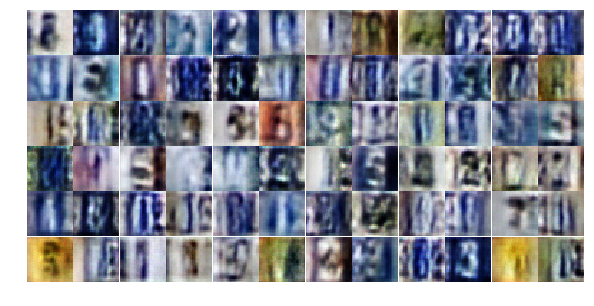

Epoch 4/25... Discriminator Loss: 0.7146... Generator Loss: 1.0382
Epoch 4/25... Discriminator Loss: 0.4691... Generator Loss: 1.4065
Epoch 4/25... Discriminator Loss: 0.6467... Generator Loss: 1.4628
Epoch 4/25... Discriminator Loss: 0.5779... Generator Loss: 1.2744
Epoch 4/25... Discriminator Loss: 0.4832... Generator Loss: 1.4654
Epoch 4/25... Discriminator Loss: 0.9617... Generator Loss: 0.8659
Epoch 4/25... Discriminator Loss: 0.7771... Generator Loss: 1.2094
Epoch 4/25... Discriminator Loss: 1.0976... Generator Loss: 0.6216
Epoch 4/25... Discriminator Loss: 0.6741... Generator Loss: 1.3098
Epoch 4/25... Discriminator Loss: 0.8965... Generator Loss: 0.8811


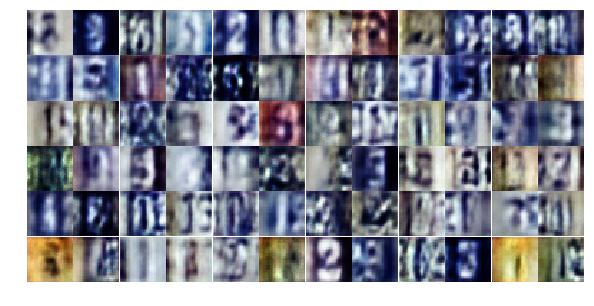

Epoch 4/25... Discriminator Loss: 0.5615... Generator Loss: 1.4017
Epoch 4/25... Discriminator Loss: 0.6326... Generator Loss: 1.4585
Epoch 4/25... Discriminator Loss: 0.3841... Generator Loss: 1.8691
Epoch 4/25... Discriminator Loss: 0.6175... Generator Loss: 1.9983
Epoch 4/25... Discriminator Loss: 1.1196... Generator Loss: 0.5827
Epoch 4/25... Discriminator Loss: 0.7883... Generator Loss: 0.9221
Epoch 4/25... Discriminator Loss: 2.0233... Generator Loss: 0.2156
Epoch 4/25... Discriminator Loss: 0.7821... Generator Loss: 0.9651
Epoch 4/25... Discriminator Loss: 0.6713... Generator Loss: 1.9352
Epoch 5/25... Discriminator Loss: 0.5659... Generator Loss: 1.4359


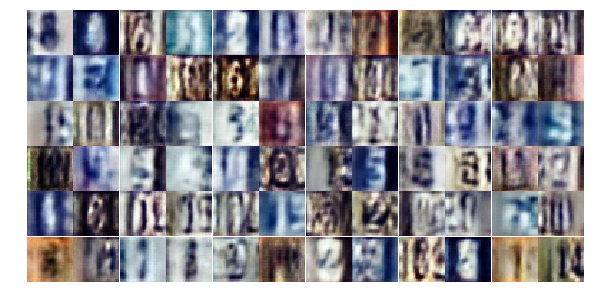

Epoch 5/25... Discriminator Loss: 0.4827... Generator Loss: 1.5544
Epoch 5/25... Discriminator Loss: 0.8009... Generator Loss: 0.8300
Epoch 5/25... Discriminator Loss: 0.5887... Generator Loss: 1.2394
Epoch 5/25... Discriminator Loss: 0.5408... Generator Loss: 1.1469
Epoch 5/25... Discriminator Loss: 0.4214... Generator Loss: 2.0966
Epoch 5/25... Discriminator Loss: 0.7441... Generator Loss: 0.8412
Epoch 5/25... Discriminator Loss: 0.6158... Generator Loss: 2.1602
Epoch 5/25... Discriminator Loss: 0.6963... Generator Loss: 1.3802
Epoch 5/25... Discriminator Loss: 0.6254... Generator Loss: 1.0389
Epoch 5/25... Discriminator Loss: 0.8413... Generator Loss: 0.8219


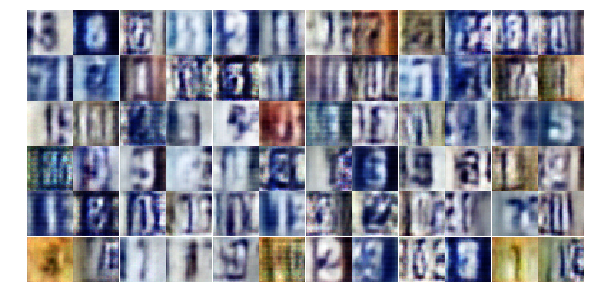

Epoch 5/25... Discriminator Loss: 0.8252... Generator Loss: 2.4901
Epoch 5/25... Discriminator Loss: 0.4957... Generator Loss: 1.6776
Epoch 5/25... Discriminator Loss: 0.5053... Generator Loss: 1.3815
Epoch 5/25... Discriminator Loss: 1.3138... Generator Loss: 0.4754
Epoch 5/25... Discriminator Loss: 0.5936... Generator Loss: 1.6966
Epoch 5/25... Discriminator Loss: 0.9768... Generator Loss: 1.3952
Epoch 5/25... Discriminator Loss: 0.4899... Generator Loss: 1.5299
Epoch 5/25... Discriminator Loss: 0.8349... Generator Loss: 0.9250
Epoch 5/25... Discriminator Loss: 0.5890... Generator Loss: 2.0451
Epoch 5/25... Discriminator Loss: 0.9645... Generator Loss: 0.6803


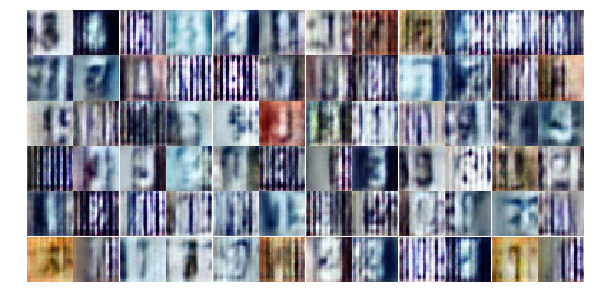

Epoch 5/25... Discriminator Loss: 0.8790... Generator Loss: 1.5165
Epoch 5/25... Discriminator Loss: 1.0018... Generator Loss: 0.8364
Epoch 5/25... Discriminator Loss: 0.8808... Generator Loss: 0.7480
Epoch 5/25... Discriminator Loss: 0.5275... Generator Loss: 1.4417
Epoch 5/25... Discriminator Loss: 0.6845... Generator Loss: 0.9883
Epoch 5/25... Discriminator Loss: 0.6721... Generator Loss: 0.9625
Epoch 5/25... Discriminator Loss: 0.8920... Generator Loss: 0.7331
Epoch 5/25... Discriminator Loss: 1.0531... Generator Loss: 0.7240
Epoch 5/25... Discriminator Loss: 0.6114... Generator Loss: 1.1926
Epoch 5/25... Discriminator Loss: 0.5119... Generator Loss: 1.4223


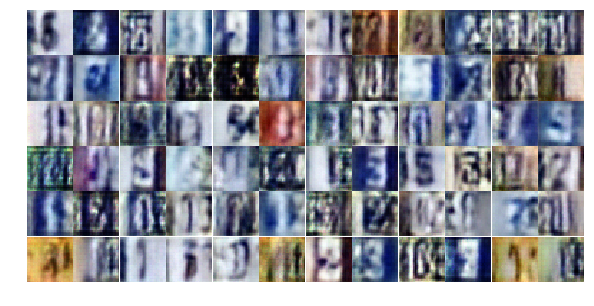

Epoch 5/25... Discriminator Loss: 0.8320... Generator Loss: 1.1916
Epoch 5/25... Discriminator Loss: 0.5578... Generator Loss: 1.3069
Epoch 5/25... Discriminator Loss: 0.4948... Generator Loss: 1.5726
Epoch 5/25... Discriminator Loss: 1.2359... Generator Loss: 3.0922
Epoch 5/25... Discriminator Loss: 1.5592... Generator Loss: 3.1994
Epoch 5/25... Discriminator Loss: 0.6818... Generator Loss: 2.1677
Epoch 5/25... Discriminator Loss: 0.7712... Generator Loss: 0.9453
Epoch 5/25... Discriminator Loss: 0.8705... Generator Loss: 0.8581
Epoch 5/25... Discriminator Loss: 1.2071... Generator Loss: 0.4919
Epoch 5/25... Discriminator Loss: 0.5536... Generator Loss: 1.3180


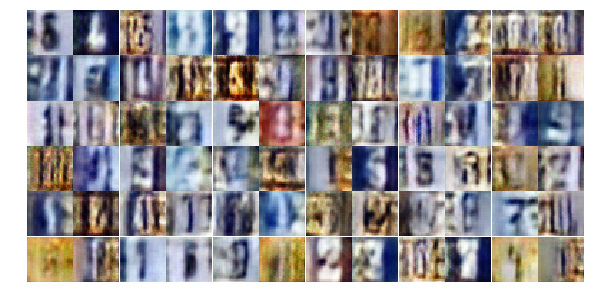

Epoch 5/25... Discriminator Loss: 0.5068... Generator Loss: 3.1391
Epoch 5/25... Discriminator Loss: 0.8971... Generator Loss: 0.7046
Epoch 5/25... Discriminator Loss: 1.2195... Generator Loss: 0.5302
Epoch 5/25... Discriminator Loss: 0.9858... Generator Loss: 0.7646
Epoch 5/25... Discriminator Loss: 0.8164... Generator Loss: 1.3106
Epoch 5/25... Discriminator Loss: 1.2310... Generator Loss: 0.5009
Epoch 5/25... Discriminator Loss: 1.0780... Generator Loss: 0.6293
Epoch 5/25... Discriminator Loss: 0.6682... Generator Loss: 1.3482
Epoch 5/25... Discriminator Loss: 0.7221... Generator Loss: 0.9146
Epoch 5/25... Discriminator Loss: 0.5470... Generator Loss: 1.4238


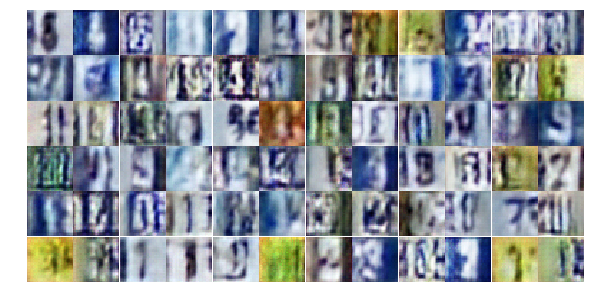

Epoch 5/25... Discriminator Loss: 0.9013... Generator Loss: 0.8063
Epoch 5/25... Discriminator Loss: 0.7377... Generator Loss: 0.9413
Epoch 5/25... Discriminator Loss: 0.6771... Generator Loss: 1.0568
Epoch 5/25... Discriminator Loss: 0.9025... Generator Loss: 0.7089
Epoch 5/25... Discriminator Loss: 0.6014... Generator Loss: 1.1256
Epoch 5/25... Discriminator Loss: 0.7006... Generator Loss: 1.4871
Epoch 6/25... Discriminator Loss: 0.9135... Generator Loss: 0.7279
Epoch 6/25... Discriminator Loss: 0.8460... Generator Loss: 0.7702
Epoch 6/25... Discriminator Loss: 0.8148... Generator Loss: 0.7828
Epoch 6/25... Discriminator Loss: 0.9025... Generator Loss: 0.7282


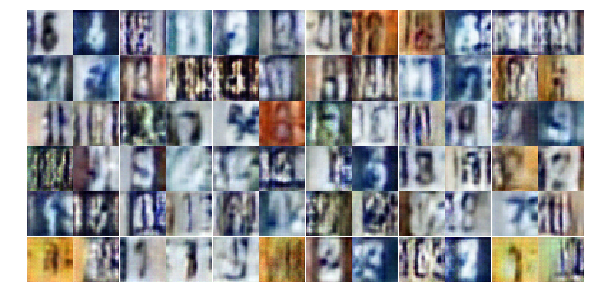

Epoch 6/25... Discriminator Loss: 0.8570... Generator Loss: 0.7796
Epoch 6/25... Discriminator Loss: 0.8887... Generator Loss: 1.2987
Epoch 6/25... Discriminator Loss: 0.6431... Generator Loss: 1.3867
Epoch 6/25... Discriminator Loss: 1.5369... Generator Loss: 0.3476
Epoch 6/25... Discriminator Loss: 1.0134... Generator Loss: 0.6248
Epoch 6/25... Discriminator Loss: 0.7777... Generator Loss: 0.7794
Epoch 6/25... Discriminator Loss: 0.5492... Generator Loss: 1.5293
Epoch 6/25... Discriminator Loss: 1.2884... Generator Loss: 0.4497
Epoch 6/25... Discriminator Loss: 1.1882... Generator Loss: 0.6057
Epoch 6/25... Discriminator Loss: 0.5732... Generator Loss: 1.3988


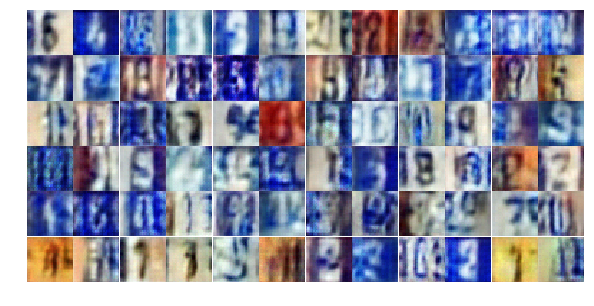

Epoch 6/25... Discriminator Loss: 0.7784... Generator Loss: 1.6978
Epoch 6/25... Discriminator Loss: 0.8506... Generator Loss: 1.0110
Epoch 6/25... Discriminator Loss: 0.8273... Generator Loss: 0.8253
Epoch 6/25... Discriminator Loss: 0.7499... Generator Loss: 1.0326
Epoch 6/25... Discriminator Loss: 0.4344... Generator Loss: 2.1649
Epoch 6/25... Discriminator Loss: 0.8366... Generator Loss: 0.7726
Epoch 6/25... Discriminator Loss: 0.7185... Generator Loss: 0.9941
Epoch 6/25... Discriminator Loss: 0.7224... Generator Loss: 1.0951
Epoch 6/25... Discriminator Loss: 0.7512... Generator Loss: 1.5934
Epoch 6/25... Discriminator Loss: 0.7655... Generator Loss: 1.0333


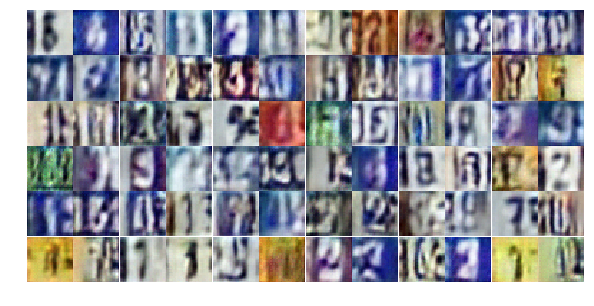

Epoch 6/25... Discriminator Loss: 0.9583... Generator Loss: 0.6910
Epoch 6/25... Discriminator Loss: 0.7129... Generator Loss: 1.0920
Epoch 6/25... Discriminator Loss: 0.8701... Generator Loss: 0.7504
Epoch 6/25... Discriminator Loss: 0.9685... Generator Loss: 0.6187
Epoch 6/25... Discriminator Loss: 0.5553... Generator Loss: 1.6788
Epoch 6/25... Discriminator Loss: 1.3368... Generator Loss: 0.4606
Epoch 6/25... Discriminator Loss: 0.6858... Generator Loss: 1.3105
Epoch 6/25... Discriminator Loss: 0.5533... Generator Loss: 1.2470
Epoch 6/25... Discriminator Loss: 0.5246... Generator Loss: 1.4979
Epoch 6/25... Discriminator Loss: 0.4715... Generator Loss: 1.6243


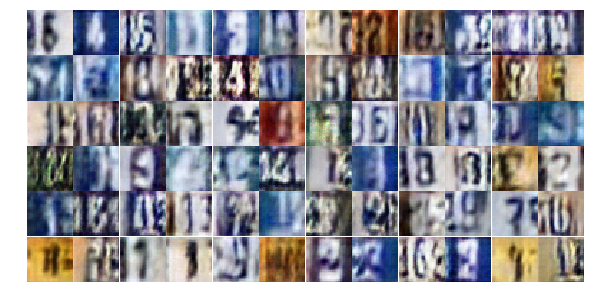

Epoch 6/25... Discriminator Loss: 0.8677... Generator Loss: 0.7682
Epoch 6/25... Discriminator Loss: 1.0693... Generator Loss: 2.7286
Epoch 6/25... Discriminator Loss: 1.0506... Generator Loss: 0.7675
Epoch 6/25... Discriminator Loss: 0.7601... Generator Loss: 0.9678
Epoch 6/25... Discriminator Loss: 1.0121... Generator Loss: 0.6047
Epoch 6/25... Discriminator Loss: 0.7950... Generator Loss: 0.9776
Epoch 6/25... Discriminator Loss: 0.6318... Generator Loss: 1.2893
Epoch 6/25... Discriminator Loss: 0.4505... Generator Loss: 1.6621
Epoch 6/25... Discriminator Loss: 0.7561... Generator Loss: 0.9025
Epoch 6/25... Discriminator Loss: 0.5298... Generator Loss: 1.1655


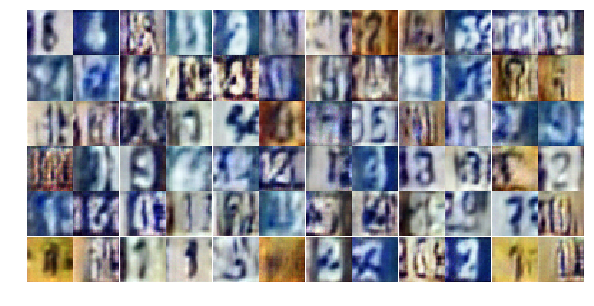

Epoch 6/25... Discriminator Loss: 0.9037... Generator Loss: 2.6701
Epoch 6/25... Discriminator Loss: 0.7072... Generator Loss: 1.0895
Epoch 6/25... Discriminator Loss: 0.8072... Generator Loss: 0.8190
Epoch 6/25... Discriminator Loss: 0.7305... Generator Loss: 0.9225
Epoch 6/25... Discriminator Loss: 0.9212... Generator Loss: 0.7403
Epoch 6/25... Discriminator Loss: 0.4923... Generator Loss: 1.6613
Epoch 6/25... Discriminator Loss: 1.0148... Generator Loss: 0.6336
Epoch 6/25... Discriminator Loss: 1.3606... Generator Loss: 0.4520
Epoch 6/25... Discriminator Loss: 0.6932... Generator Loss: 1.0584
Epoch 6/25... Discriminator Loss: 1.4191... Generator Loss: 0.3897


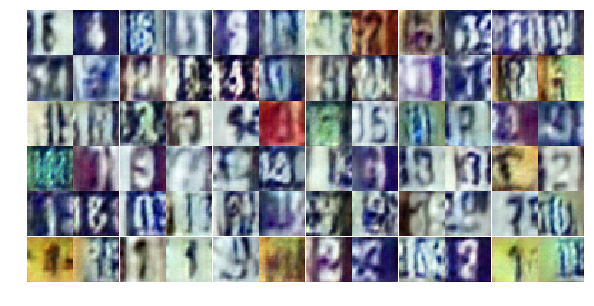

Epoch 6/25... Discriminator Loss: 0.6285... Generator Loss: 1.2905
Epoch 6/25... Discriminator Loss: 1.0825... Generator Loss: 0.5429
Epoch 6/25... Discriminator Loss: 0.5394... Generator Loss: 2.2000
Epoch 7/25... Discriminator Loss: 1.1227... Generator Loss: 0.5389
Epoch 7/25... Discriminator Loss: 0.9014... Generator Loss: 0.8624
Epoch 7/25... Discriminator Loss: 0.6591... Generator Loss: 1.1580
Epoch 7/25... Discriminator Loss: 0.5797... Generator Loss: 1.1655
Epoch 7/25... Discriminator Loss: 0.4438... Generator Loss: 1.5380
Epoch 7/25... Discriminator Loss: 0.5713... Generator Loss: 1.1674
Epoch 7/25... Discriminator Loss: 0.7951... Generator Loss: 0.8363


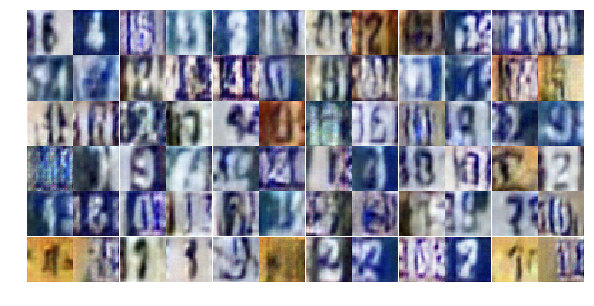

Epoch 7/25... Discriminator Loss: 0.4997... Generator Loss: 1.8362
Epoch 7/25... Discriminator Loss: 0.7153... Generator Loss: 1.3202
Epoch 7/25... Discriminator Loss: 0.9246... Generator Loss: 0.7103
Epoch 7/25... Discriminator Loss: 0.6859... Generator Loss: 1.3199
Epoch 7/25... Discriminator Loss: 0.5537... Generator Loss: 1.5085
Epoch 7/25... Discriminator Loss: 0.5859... Generator Loss: 1.1690
Epoch 7/25... Discriminator Loss: 1.2524... Generator Loss: 2.4758
Epoch 7/25... Discriminator Loss: 1.1398... Generator Loss: 1.6284
Epoch 7/25... Discriminator Loss: 0.6700... Generator Loss: 2.6386
Epoch 7/25... Discriminator Loss: 0.7923... Generator Loss: 0.8249


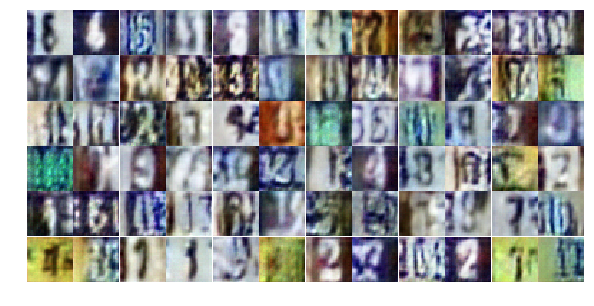

Epoch 7/25... Discriminator Loss: 0.5771... Generator Loss: 1.4266
Epoch 7/25... Discriminator Loss: 0.4919... Generator Loss: 2.3344
Epoch 7/25... Discriminator Loss: 1.7284... Generator Loss: 4.2197
Epoch 7/25... Discriminator Loss: 0.6163... Generator Loss: 1.4790
Epoch 7/25... Discriminator Loss: 0.4882... Generator Loss: 1.4168
Epoch 7/25... Discriminator Loss: 0.5751... Generator Loss: 1.1576
Epoch 7/25... Discriminator Loss: 0.4983... Generator Loss: 1.3734
Epoch 7/25... Discriminator Loss: 0.7751... Generator Loss: 0.9359
Epoch 7/25... Discriminator Loss: 0.7598... Generator Loss: 0.8659
Epoch 7/25... Discriminator Loss: 0.4841... Generator Loss: 1.9278


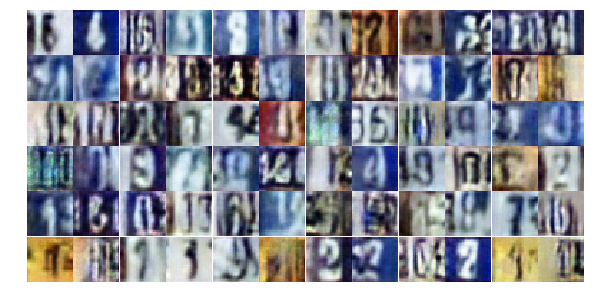

Epoch 7/25... Discriminator Loss: 0.9184... Generator Loss: 0.6750
Epoch 7/25... Discriminator Loss: 1.7545... Generator Loss: 0.3317
Epoch 7/25... Discriminator Loss: 0.5184... Generator Loss: 1.5354
Epoch 7/25... Discriminator Loss: 0.8610... Generator Loss: 0.7248
Epoch 7/25... Discriminator Loss: 0.6748... Generator Loss: 1.1550
Epoch 7/25... Discriminator Loss: 0.6256... Generator Loss: 1.1643
Epoch 7/25... Discriminator Loss: 0.5177... Generator Loss: 1.4743
Epoch 7/25... Discriminator Loss: 0.9956... Generator Loss: 0.7056
Epoch 7/25... Discriminator Loss: 1.2867... Generator Loss: 0.4529
Epoch 7/25... Discriminator Loss: 0.7008... Generator Loss: 1.9039


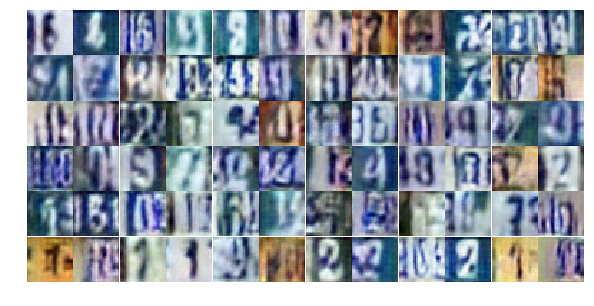

Epoch 7/25... Discriminator Loss: 1.1904... Generator Loss: 0.5296
Epoch 7/25... Discriminator Loss: 0.8320... Generator Loss: 2.0144
Epoch 7/25... Discriminator Loss: 0.8291... Generator Loss: 2.3216
Epoch 7/25... Discriminator Loss: 0.8958... Generator Loss: 0.7179
Epoch 7/25... Discriminator Loss: 0.7264... Generator Loss: 0.9580
Epoch 7/25... Discriminator Loss: 0.4936... Generator Loss: 2.2432
Epoch 7/25... Discriminator Loss: 0.4784... Generator Loss: 1.7443
Epoch 7/25... Discriminator Loss: 1.2077... Generator Loss: 0.7883
Epoch 7/25... Discriminator Loss: 0.5096... Generator Loss: 1.8042
Epoch 7/25... Discriminator Loss: 1.1346... Generator Loss: 0.5711


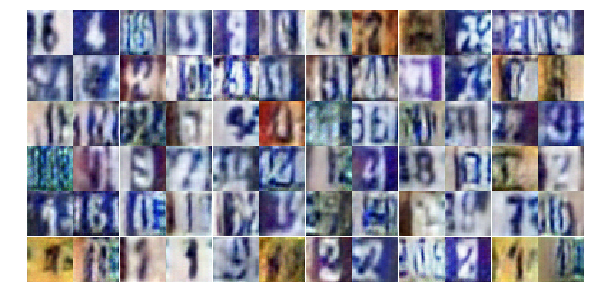

Epoch 7/25... Discriminator Loss: 0.5034... Generator Loss: 2.1267
Epoch 7/25... Discriminator Loss: 0.6060... Generator Loss: 1.2798
Epoch 7/25... Discriminator Loss: 0.8217... Generator Loss: 0.9173
Epoch 7/25... Discriminator Loss: 0.5936... Generator Loss: 1.7166
Epoch 7/25... Discriminator Loss: 0.5649... Generator Loss: 1.4898
Epoch 7/25... Discriminator Loss: 1.3344... Generator Loss: 0.3990
Epoch 7/25... Discriminator Loss: 0.9824... Generator Loss: 0.6441
Epoch 7/25... Discriminator Loss: 0.6878... Generator Loss: 1.3489
Epoch 7/25... Discriminator Loss: 0.9013... Generator Loss: 0.7878
Epoch 7/25... Discriminator Loss: 0.5939... Generator Loss: 1.5872


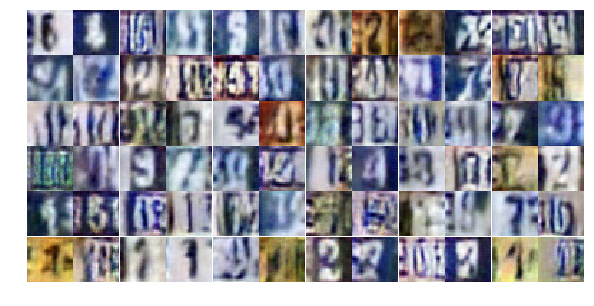

Epoch 7/25... Discriminator Loss: 0.4845... Generator Loss: 1.4500
Epoch 8/25... Discriminator Loss: 0.7127... Generator Loss: 0.9690
Epoch 8/25... Discriminator Loss: 0.7394... Generator Loss: 0.8493
Epoch 8/25... Discriminator Loss: 0.8867... Generator Loss: 0.7377
Epoch 8/25... Discriminator Loss: 0.4230... Generator Loss: 1.9387
Epoch 8/25... Discriminator Loss: 1.0843... Generator Loss: 2.3510
Epoch 8/25... Discriminator Loss: 0.5987... Generator Loss: 1.1910
Epoch 8/25... Discriminator Loss: 0.4887... Generator Loss: 1.5183
Epoch 8/25... Discriminator Loss: 1.1545... Generator Loss: 0.5306
Epoch 8/25... Discriminator Loss: 0.7236... Generator Loss: 1.1128


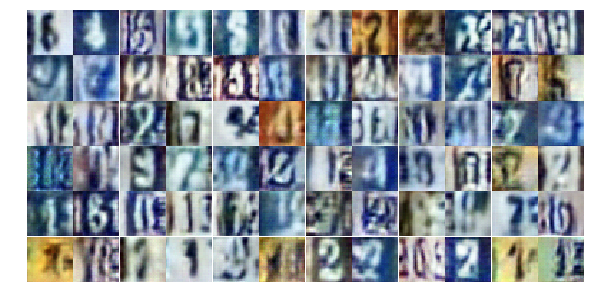

Epoch 8/25... Discriminator Loss: 0.4908... Generator Loss: 1.6391
Epoch 8/25... Discriminator Loss: 0.5471... Generator Loss: 1.5781
Epoch 8/25... Discriminator Loss: 1.1634... Generator Loss: 0.5141
Epoch 8/25... Discriminator Loss: 0.4892... Generator Loss: 2.5567
Epoch 8/25... Discriminator Loss: 0.8278... Generator Loss: 0.9640
Epoch 8/25... Discriminator Loss: 0.8062... Generator Loss: 3.1685
Epoch 8/25... Discriminator Loss: 0.4524... Generator Loss: 1.9682
Epoch 8/25... Discriminator Loss: 0.3982... Generator Loss: 1.6857
Epoch 8/25... Discriminator Loss: 0.4796... Generator Loss: 1.4292
Epoch 8/25... Discriminator Loss: 1.7541... Generator Loss: 0.2504


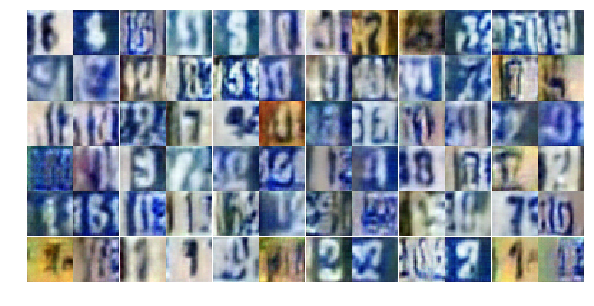

Epoch 8/25... Discriminator Loss: 0.4191... Generator Loss: 2.0018
Epoch 8/25... Discriminator Loss: 0.5712... Generator Loss: 1.2969
Epoch 8/25... Discriminator Loss: 0.5468... Generator Loss: 1.6493
Epoch 8/25... Discriminator Loss: 0.5909... Generator Loss: 2.2628
Epoch 8/25... Discriminator Loss: 0.4077... Generator Loss: 1.8652
Epoch 8/25... Discriminator Loss: 0.4813... Generator Loss: 1.3448
Epoch 8/25... Discriminator Loss: 0.6271... Generator Loss: 1.1970
Epoch 8/25... Discriminator Loss: 0.6381... Generator Loss: 1.2717
Epoch 8/25... Discriminator Loss: 0.9117... Generator Loss: 0.8255
Epoch 8/25... Discriminator Loss: 0.7663... Generator Loss: 0.9015


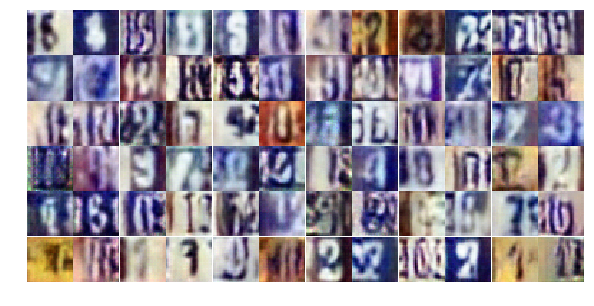

Epoch 8/25... Discriminator Loss: 0.7314... Generator Loss: 1.0537
Epoch 8/25... Discriminator Loss: 0.6825... Generator Loss: 0.9812
Epoch 8/25... Discriminator Loss: 0.4651... Generator Loss: 1.6414
Epoch 8/25... Discriminator Loss: 0.6774... Generator Loss: 1.0323
Epoch 8/25... Discriminator Loss: 1.3152... Generator Loss: 0.4019
Epoch 8/25... Discriminator Loss: 0.4995... Generator Loss: 1.3806
Epoch 8/25... Discriminator Loss: 0.6783... Generator Loss: 1.2411
Epoch 8/25... Discriminator Loss: 0.5955... Generator Loss: 1.1919
Epoch 8/25... Discriminator Loss: 0.7458... Generator Loss: 0.8578
Epoch 8/25... Discriminator Loss: 0.6694... Generator Loss: 1.0502


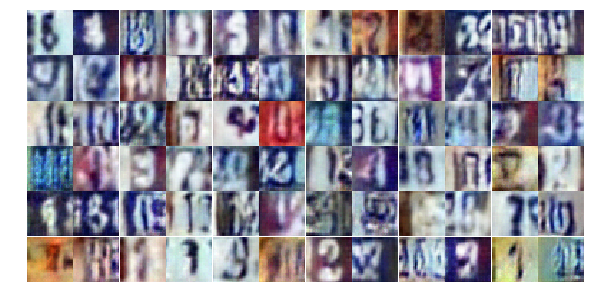

Epoch 8/25... Discriminator Loss: 0.3534... Generator Loss: 1.8010
Epoch 8/25... Discriminator Loss: 0.9336... Generator Loss: 0.7151
Epoch 8/25... Discriminator Loss: 0.6788... Generator Loss: 0.9954
Epoch 8/25... Discriminator Loss: 0.5760... Generator Loss: 1.0707
Epoch 8/25... Discriminator Loss: 1.3649... Generator Loss: 3.0896
Epoch 8/25... Discriminator Loss: 0.7486... Generator Loss: 0.9582
Epoch 8/25... Discriminator Loss: 0.9820... Generator Loss: 0.6020
Epoch 8/25... Discriminator Loss: 0.6782... Generator Loss: 1.2590
Epoch 8/25... Discriminator Loss: 0.6731... Generator Loss: 1.2688
Epoch 8/25... Discriminator Loss: 0.6738... Generator Loss: 1.0419


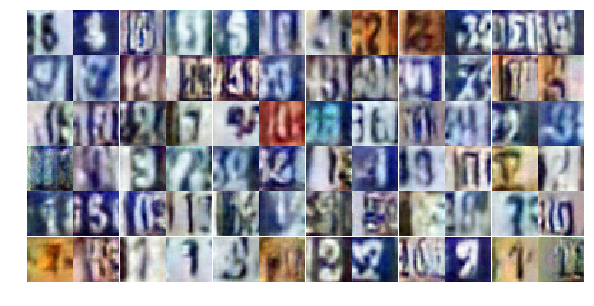

Epoch 8/25... Discriminator Loss: 1.0187... Generator Loss: 0.5562
Epoch 8/25... Discriminator Loss: 0.8883... Generator Loss: 0.7395
Epoch 8/25... Discriminator Loss: 1.5407... Generator Loss: 4.4583
Epoch 8/25... Discriminator Loss: 0.6194... Generator Loss: 1.1902
Epoch 8/25... Discriminator Loss: 0.4097... Generator Loss: 1.9312
Epoch 8/25... Discriminator Loss: 0.8459... Generator Loss: 0.8646
Epoch 8/25... Discriminator Loss: 0.6087... Generator Loss: 1.0755
Epoch 8/25... Discriminator Loss: 0.6499... Generator Loss: 2.6266
Epoch 9/25... Discriminator Loss: 1.4448... Generator Loss: 0.3770
Epoch 9/25... Discriminator Loss: 0.7585... Generator Loss: 0.9396


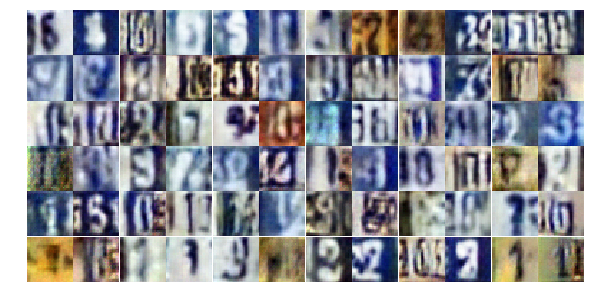

Epoch 9/25... Discriminator Loss: 0.8077... Generator Loss: 0.8911
Epoch 9/25... Discriminator Loss: 0.7142... Generator Loss: 1.7199
Epoch 9/25... Discriminator Loss: 1.1805... Generator Loss: 0.4949
Epoch 9/25... Discriminator Loss: 0.4417... Generator Loss: 1.6310
Epoch 9/25... Discriminator Loss: 0.8561... Generator Loss: 0.8312
Epoch 9/25... Discriminator Loss: 0.5176... Generator Loss: 1.8003
Epoch 9/25... Discriminator Loss: 0.5730... Generator Loss: 1.1856
Epoch 9/25... Discriminator Loss: 0.5022... Generator Loss: 1.4069
Epoch 9/25... Discriminator Loss: 1.1218... Generator Loss: 0.4991
Epoch 9/25... Discriminator Loss: 0.8584... Generator Loss: 2.0349


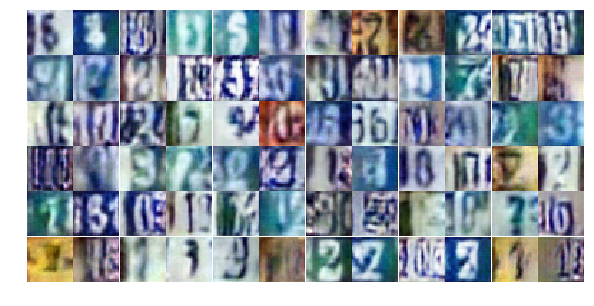

Epoch 9/25... Discriminator Loss: 0.8717... Generator Loss: 0.7791
Epoch 9/25... Discriminator Loss: 0.7121... Generator Loss: 0.9460
Epoch 9/25... Discriminator Loss: 0.7967... Generator Loss: 0.8439
Epoch 9/25... Discriminator Loss: 1.0531... Generator Loss: 0.5930
Epoch 9/25... Discriminator Loss: 0.6947... Generator Loss: 1.8321
Epoch 9/25... Discriminator Loss: 0.6586... Generator Loss: 1.2915
Epoch 9/25... Discriminator Loss: 1.1562... Generator Loss: 0.5259
Epoch 9/25... Discriminator Loss: 0.6828... Generator Loss: 1.0484
Epoch 9/25... Discriminator Loss: 1.4120... Generator Loss: 0.3874
Epoch 9/25... Discriminator Loss: 0.7381... Generator Loss: 0.9911


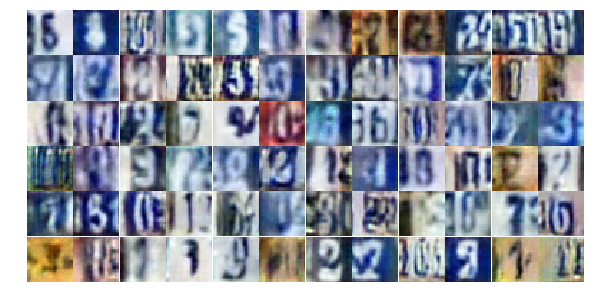

Epoch 9/25... Discriminator Loss: 1.1237... Generator Loss: 0.5594
Epoch 9/25... Discriminator Loss: 0.5926... Generator Loss: 1.1720
Epoch 9/25... Discriminator Loss: 0.6379... Generator Loss: 1.9828
Epoch 9/25... Discriminator Loss: 0.7172... Generator Loss: 1.0991
Epoch 9/25... Discriminator Loss: 0.4728... Generator Loss: 1.5972
Epoch 9/25... Discriminator Loss: 0.6140... Generator Loss: 1.4204
Epoch 9/25... Discriminator Loss: 1.2961... Generator Loss: 0.4894
Epoch 9/25... Discriminator Loss: 0.5966... Generator Loss: 1.1138
Epoch 9/25... Discriminator Loss: 0.5958... Generator Loss: 1.2568
Epoch 9/25... Discriminator Loss: 0.8259... Generator Loss: 0.7580


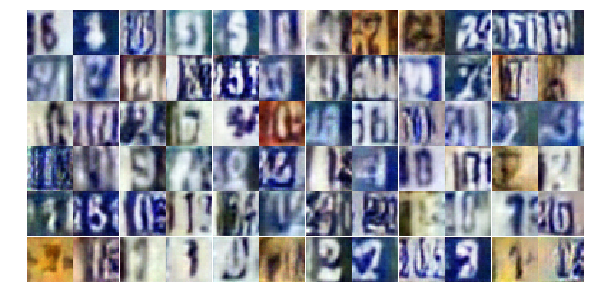

Epoch 9/25... Discriminator Loss: 0.5467... Generator Loss: 1.2059
Epoch 9/25... Discriminator Loss: 0.9040... Generator Loss: 0.7226
Epoch 9/25... Discriminator Loss: 0.8198... Generator Loss: 0.8635
Epoch 9/25... Discriminator Loss: 0.8545... Generator Loss: 0.7595
Epoch 9/25... Discriminator Loss: 0.7258... Generator Loss: 0.9780
Epoch 9/25... Discriminator Loss: 0.7795... Generator Loss: 1.8617
Epoch 9/25... Discriminator Loss: 0.7928... Generator Loss: 0.8571
Epoch 9/25... Discriminator Loss: 0.5167... Generator Loss: 1.6963
Epoch 9/25... Discriminator Loss: 0.8754... Generator Loss: 0.7853
Epoch 9/25... Discriminator Loss: 0.6970... Generator Loss: 0.9899


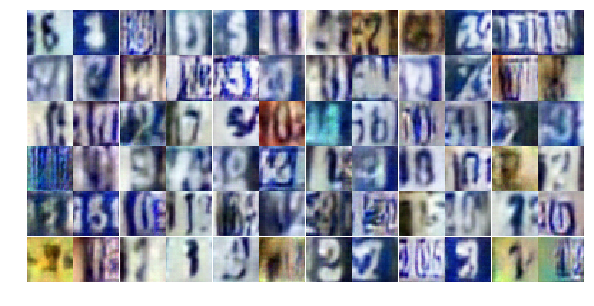

Epoch 9/25... Discriminator Loss: 0.6542... Generator Loss: 1.0108
Epoch 9/25... Discriminator Loss: 0.5917... Generator Loss: 1.1381
Epoch 9/25... Discriminator Loss: 0.6444... Generator Loss: 2.1319
Epoch 9/25... Discriminator Loss: 1.3539... Generator Loss: 3.4646
Epoch 9/25... Discriminator Loss: 0.5820... Generator Loss: 1.5501
Epoch 9/25... Discriminator Loss: 0.7581... Generator Loss: 1.0540
Epoch 9/25... Discriminator Loss: 0.8484... Generator Loss: 0.8522
Epoch 9/25... Discriminator Loss: 0.7107... Generator Loss: 1.0201
Epoch 9/25... Discriminator Loss: 0.6118... Generator Loss: 1.4126
Epoch 9/25... Discriminator Loss: 0.8916... Generator Loss: 2.7455


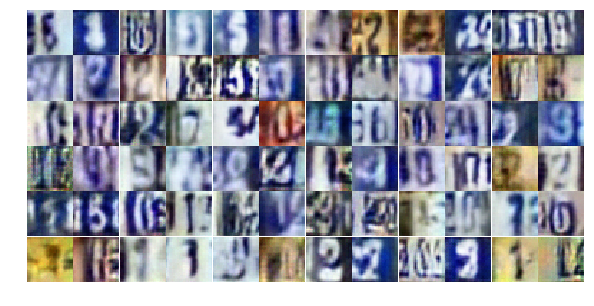

Epoch 9/25... Discriminator Loss: 1.3892... Generator Loss: 0.3719
Epoch 9/25... Discriminator Loss: 0.6287... Generator Loss: 2.1955
Epoch 9/25... Discriminator Loss: 0.6116... Generator Loss: 1.1329
Epoch 9/25... Discriminator Loss: 1.1718... Generator Loss: 0.4825
Epoch 9/25... Discriminator Loss: 0.4923... Generator Loss: 1.3837
Epoch 10/25... Discriminator Loss: 0.8873... Generator Loss: 0.7197
Epoch 10/25... Discriminator Loss: 0.4751... Generator Loss: 1.4103
Epoch 10/25... Discriminator Loss: 0.6507... Generator Loss: 1.0521
Epoch 10/25... Discriminator Loss: 0.7625... Generator Loss: 1.2017
Epoch 10/25... Discriminator Loss: 1.2039... Generator Loss: 0.4828


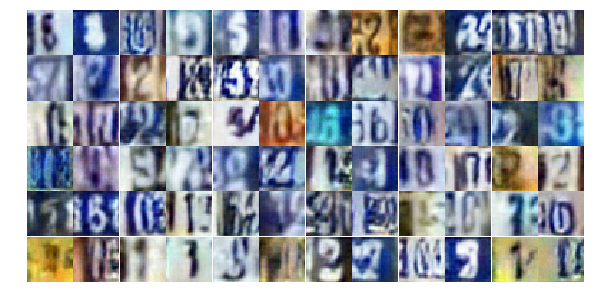

Epoch 10/25... Discriminator Loss: 0.7123... Generator Loss: 0.9620
Epoch 10/25... Discriminator Loss: 0.4267... Generator Loss: 1.6941
Epoch 10/25... Discriminator Loss: 0.8289... Generator Loss: 1.0356
Epoch 10/25... Discriminator Loss: 0.5816... Generator Loss: 1.8153
Epoch 10/25... Discriminator Loss: 0.6952... Generator Loss: 0.9809
Epoch 10/25... Discriminator Loss: 1.0198... Generator Loss: 0.6279
Epoch 10/25... Discriminator Loss: 0.5874... Generator Loss: 1.2055
Epoch 10/25... Discriminator Loss: 1.0134... Generator Loss: 0.6282
Epoch 10/25... Discriminator Loss: 0.7277... Generator Loss: 1.4823
Epoch 10/25... Discriminator Loss: 0.6027... Generator Loss: 1.1813


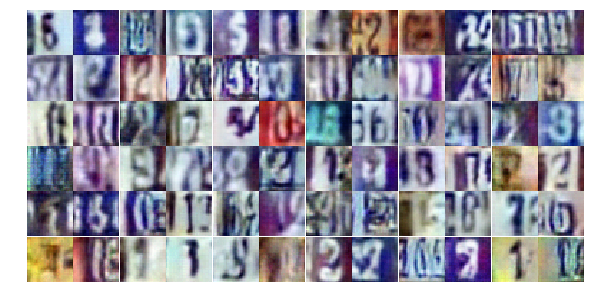

Epoch 10/25... Discriminator Loss: 0.7167... Generator Loss: 1.0422
Epoch 10/25... Discriminator Loss: 1.0061... Generator Loss: 0.6448
Epoch 10/25... Discriminator Loss: 0.9028... Generator Loss: 0.7038
Epoch 10/25... Discriminator Loss: 1.1202... Generator Loss: 0.5930
Epoch 10/25... Discriminator Loss: 0.6321... Generator Loss: 1.1210
Epoch 10/25... Discriminator Loss: 0.5997... Generator Loss: 1.2458
Epoch 10/25... Discriminator Loss: 0.9240... Generator Loss: 0.7054
Epoch 10/25... Discriminator Loss: 0.6962... Generator Loss: 1.0227
Epoch 10/25... Discriminator Loss: 0.7362... Generator Loss: 0.9919
Epoch 10/25... Discriminator Loss: 0.4100... Generator Loss: 2.1605


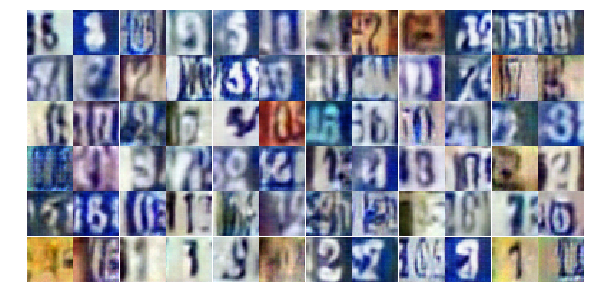

Epoch 10/25... Discriminator Loss: 1.3304... Generator Loss: 0.4067
Epoch 10/25... Discriminator Loss: 0.9045... Generator Loss: 0.7989
Epoch 10/25... Discriminator Loss: 0.4552... Generator Loss: 1.3468
Epoch 10/25... Discriminator Loss: 0.4948... Generator Loss: 2.0250
Epoch 10/25... Discriminator Loss: 1.4705... Generator Loss: 0.3290
Epoch 10/25... Discriminator Loss: 0.6427... Generator Loss: 1.0057
Epoch 10/25... Discriminator Loss: 0.3831... Generator Loss: 1.6408
Epoch 10/25... Discriminator Loss: 0.9461... Generator Loss: 0.7144
Epoch 10/25... Discriminator Loss: 0.9795... Generator Loss: 0.6713
Epoch 10/25... Discriminator Loss: 0.7778... Generator Loss: 1.7192


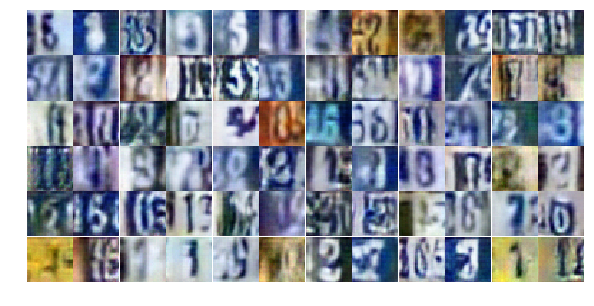

Epoch 10/25... Discriminator Loss: 0.5866... Generator Loss: 1.4993
Epoch 10/25... Discriminator Loss: 0.9085... Generator Loss: 0.7431
Epoch 10/25... Discriminator Loss: 0.7436... Generator Loss: 2.3274
Epoch 10/25... Discriminator Loss: 0.6652... Generator Loss: 1.4230
Epoch 10/25... Discriminator Loss: 0.6150... Generator Loss: 1.2046
Epoch 10/25... Discriminator Loss: 0.8319... Generator Loss: 0.8296
Epoch 10/25... Discriminator Loss: 0.8471... Generator Loss: 0.8102
Epoch 10/25... Discriminator Loss: 0.9755... Generator Loss: 0.7265
Epoch 10/25... Discriminator Loss: 0.7610... Generator Loss: 0.8555
Epoch 10/25... Discriminator Loss: 0.4658... Generator Loss: 1.8127


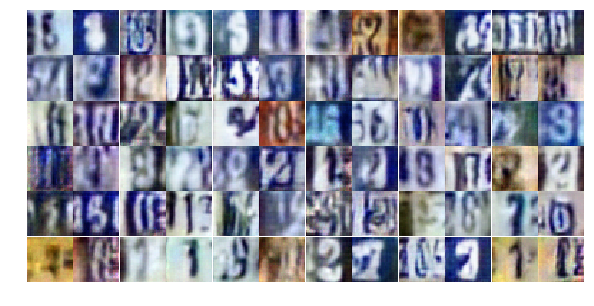

Epoch 10/25... Discriminator Loss: 0.5915... Generator Loss: 1.1455
Epoch 10/25... Discriminator Loss: 0.6814... Generator Loss: 1.1686
Epoch 10/25... Discriminator Loss: 0.6865... Generator Loss: 0.9330
Epoch 10/25... Discriminator Loss: 0.6843... Generator Loss: 1.0535
Epoch 10/25... Discriminator Loss: 0.5022... Generator Loss: 1.3831
Epoch 10/25... Discriminator Loss: 0.7636... Generator Loss: 0.9014
Epoch 10/25... Discriminator Loss: 0.6122... Generator Loss: 1.1528
Epoch 10/25... Discriminator Loss: 0.4785... Generator Loss: 1.7986
Epoch 10/25... Discriminator Loss: 0.6298... Generator Loss: 2.4862
Epoch 10/25... Discriminator Loss: 0.5098... Generator Loss: 1.7564


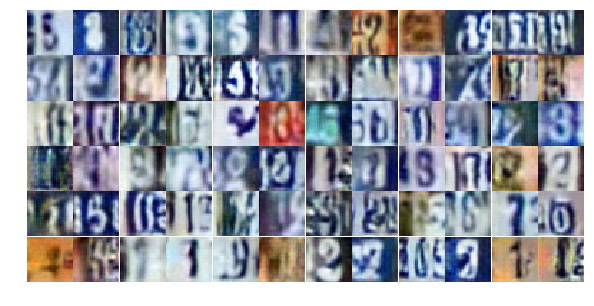

Epoch 10/25... Discriminator Loss: 0.9697... Generator Loss: 1.0905
Epoch 10/25... Discriminator Loss: 0.5157... Generator Loss: 1.6251
Epoch 10/25... Discriminator Loss: 0.4665... Generator Loss: 1.3802
Epoch 11/25... Discriminator Loss: 0.8060... Generator Loss: 1.1837
Epoch 11/25... Discriminator Loss: 0.6890... Generator Loss: 0.9615
Epoch 11/25... Discriminator Loss: 1.1654... Generator Loss: 0.7096
Epoch 11/25... Discriminator Loss: 0.6752... Generator Loss: 1.0532
Epoch 11/25... Discriminator Loss: 0.6198... Generator Loss: 1.0625
Epoch 11/25... Discriminator Loss: 1.7279... Generator Loss: 0.2874
Epoch 11/25... Discriminator Loss: 0.3720... Generator Loss: 1.7133


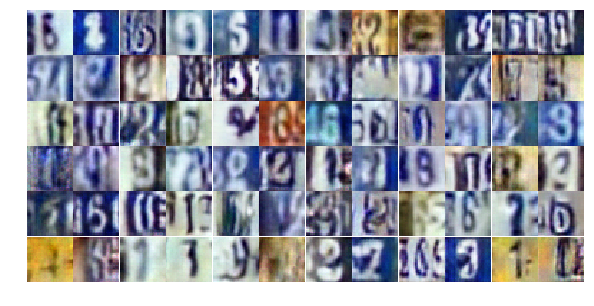

Epoch 11/25... Discriminator Loss: 0.4196... Generator Loss: 1.9928
Epoch 11/25... Discriminator Loss: 0.6252... Generator Loss: 1.1154
Epoch 11/25... Discriminator Loss: 0.3757... Generator Loss: 1.6457
Epoch 11/25... Discriminator Loss: 0.5088... Generator Loss: 1.3809
Epoch 11/25... Discriminator Loss: 0.8721... Generator Loss: 0.9815
Epoch 11/25... Discriminator Loss: 0.4066... Generator Loss: 1.9091
Epoch 11/25... Discriminator Loss: 0.7728... Generator Loss: 1.4484
Epoch 11/25... Discriminator Loss: 0.4063... Generator Loss: 2.0043
Epoch 11/25... Discriminator Loss: 0.7083... Generator Loss: 0.9651
Epoch 11/25... Discriminator Loss: 1.2042... Generator Loss: 0.5881


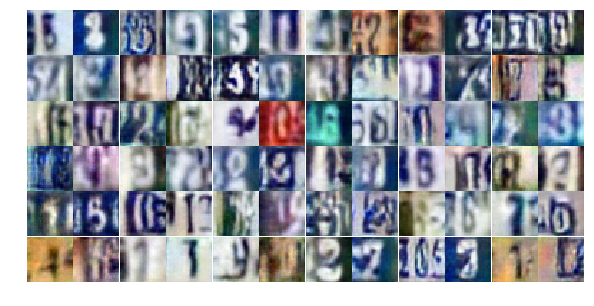

Epoch 11/25... Discriminator Loss: 0.8037... Generator Loss: 0.9609
Epoch 11/25... Discriminator Loss: 0.3539... Generator Loss: 2.2853
Epoch 11/25... Discriminator Loss: 0.9286... Generator Loss: 0.6850
Epoch 11/25... Discriminator Loss: 0.8062... Generator Loss: 0.8651
Epoch 11/25... Discriminator Loss: 0.2519... Generator Loss: 2.4329
Epoch 11/25... Discriminator Loss: 0.3393... Generator Loss: 2.1439
Epoch 11/25... Discriminator Loss: 0.6788... Generator Loss: 1.1829
Epoch 11/25... Discriminator Loss: 0.9514... Generator Loss: 0.6696
Epoch 11/25... Discriminator Loss: 0.4459... Generator Loss: 2.0324
Epoch 11/25... Discriminator Loss: 0.7726... Generator Loss: 0.9081


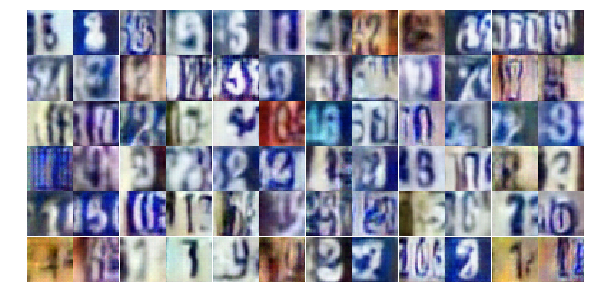

Epoch 11/25... Discriminator Loss: 1.3864... Generator Loss: 0.4293
Epoch 11/25... Discriminator Loss: 0.8871... Generator Loss: 1.6381
Epoch 11/25... Discriminator Loss: 0.8507... Generator Loss: 1.0116
Epoch 11/25... Discriminator Loss: 0.5779... Generator Loss: 1.0984
Epoch 11/25... Discriminator Loss: 0.7048... Generator Loss: 1.0269
Epoch 11/25... Discriminator Loss: 1.2262... Generator Loss: 0.4445
Epoch 11/25... Discriminator Loss: 1.3993... Generator Loss: 0.3961
Epoch 11/25... Discriminator Loss: 1.0063... Generator Loss: 0.6395
Epoch 11/25... Discriminator Loss: 0.6662... Generator Loss: 1.0660
Epoch 11/25... Discriminator Loss: 1.2617... Generator Loss: 0.4519


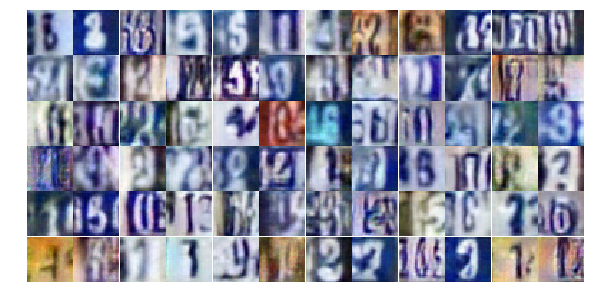

Epoch 11/25... Discriminator Loss: 0.5074... Generator Loss: 1.3242
Epoch 11/25... Discriminator Loss: 0.6675... Generator Loss: 1.0889
Epoch 11/25... Discriminator Loss: 0.7941... Generator Loss: 0.8244
Epoch 11/25... Discriminator Loss: 0.7966... Generator Loss: 0.8216
Epoch 11/25... Discriminator Loss: 0.8741... Generator Loss: 0.7625
Epoch 11/25... Discriminator Loss: 0.5195... Generator Loss: 1.3979
Epoch 11/25... Discriminator Loss: 1.6600... Generator Loss: 0.4420
Epoch 11/25... Discriminator Loss: 0.6914... Generator Loss: 1.4409
Epoch 11/25... Discriminator Loss: 1.3935... Generator Loss: 0.4023
Epoch 11/25... Discriminator Loss: 0.3975... Generator Loss: 1.5030


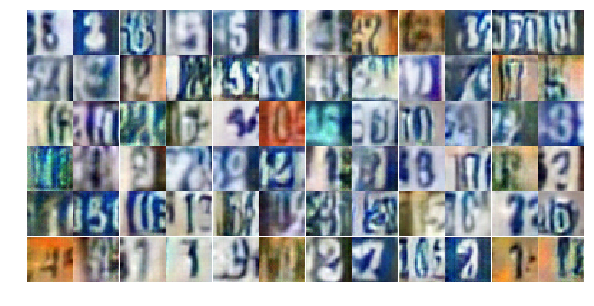

Epoch 11/25... Discriminator Loss: 0.6723... Generator Loss: 1.3444
Epoch 11/25... Discriminator Loss: 0.3845... Generator Loss: 1.8683
Epoch 11/25... Discriminator Loss: 0.6577... Generator Loss: 1.0836
Epoch 11/25... Discriminator Loss: 0.5954... Generator Loss: 1.0726
Epoch 11/25... Discriminator Loss: 1.4343... Generator Loss: 0.4090
Epoch 11/25... Discriminator Loss: 0.5742... Generator Loss: 1.9435
Epoch 11/25... Discriminator Loss: 1.0118... Generator Loss: 0.6719
Epoch 11/25... Discriminator Loss: 0.5306... Generator Loss: 1.4126
Epoch 11/25... Discriminator Loss: 0.6509... Generator Loss: 1.2552
Epoch 11/25... Discriminator Loss: 1.0025... Generator Loss: 0.6618


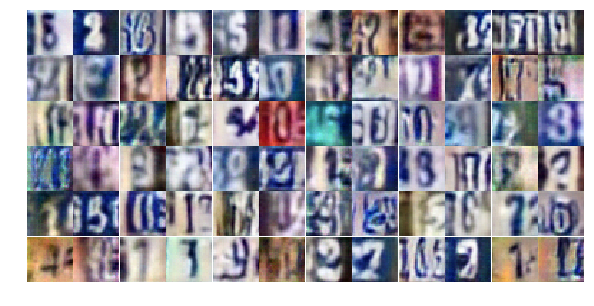

Epoch 12/25... Discriminator Loss: 0.5787... Generator Loss: 1.3415
Epoch 12/25... Discriminator Loss: 0.6631... Generator Loss: 1.1351
Epoch 12/25... Discriminator Loss: 0.8139... Generator Loss: 1.2734
Epoch 12/25... Discriminator Loss: 0.5345... Generator Loss: 1.3490
Epoch 12/25... Discriminator Loss: 0.4843... Generator Loss: 1.4429
Epoch 12/25... Discriminator Loss: 0.8248... Generator Loss: 0.7574
Epoch 12/25... Discriminator Loss: 0.7465... Generator Loss: 1.2772
Epoch 12/25... Discriminator Loss: 0.5154... Generator Loss: 1.4807
Epoch 12/25... Discriminator Loss: 0.7069... Generator Loss: 1.6871
Epoch 12/25... Discriminator Loss: 1.3221... Generator Loss: 0.4554


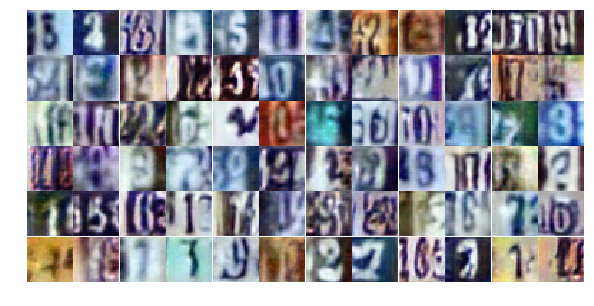

Epoch 12/25... Discriminator Loss: 0.5074... Generator Loss: 1.2889
Epoch 12/25... Discriminator Loss: 0.8070... Generator Loss: 0.9181
Epoch 12/25... Discriminator Loss: 0.5884... Generator Loss: 2.0261
Epoch 12/25... Discriminator Loss: 1.6194... Generator Loss: 0.9653
Epoch 12/25... Discriminator Loss: 0.5554... Generator Loss: 1.7538
Epoch 12/25... Discriminator Loss: 0.8317... Generator Loss: 0.8451
Epoch 12/25... Discriminator Loss: 1.8578... Generator Loss: 0.2225
Epoch 12/25... Discriminator Loss: 0.4675... Generator Loss: 1.5954
Epoch 12/25... Discriminator Loss: 0.6353... Generator Loss: 1.2797
Epoch 12/25... Discriminator Loss: 0.8685... Generator Loss: 0.7654


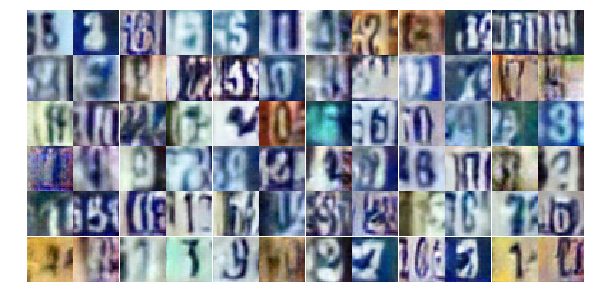

Epoch 12/25... Discriminator Loss: 0.4384... Generator Loss: 1.8295
Epoch 12/25... Discriminator Loss: 0.5003... Generator Loss: 1.3646
Epoch 12/25... Discriminator Loss: 0.5289... Generator Loss: 1.5101
Epoch 12/25... Discriminator Loss: 0.4599... Generator Loss: 1.9115
Epoch 12/25... Discriminator Loss: 0.5437... Generator Loss: 1.6871
Epoch 12/25... Discriminator Loss: 0.4909... Generator Loss: 1.7752
Epoch 12/25... Discriminator Loss: 0.6926... Generator Loss: 1.0313
Epoch 12/25... Discriminator Loss: 0.2940... Generator Loss: 2.0479
Epoch 12/25... Discriminator Loss: 0.6136... Generator Loss: 1.0952
Epoch 12/25... Discriminator Loss: 0.8694... Generator Loss: 0.8194


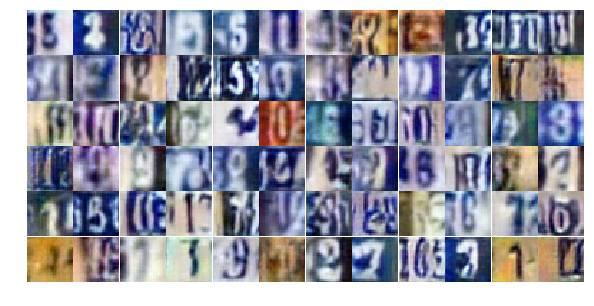

Epoch 12/25... Discriminator Loss: 0.7454... Generator Loss: 0.9432
Epoch 12/25... Discriminator Loss: 0.7304... Generator Loss: 1.5997
Epoch 12/25... Discriminator Loss: 0.7724... Generator Loss: 0.8729
Epoch 12/25... Discriminator Loss: 1.8117... Generator Loss: 0.2503
Epoch 12/25... Discriminator Loss: 0.6251... Generator Loss: 1.2558
Epoch 12/25... Discriminator Loss: 0.7282... Generator Loss: 1.0128
Epoch 12/25... Discriminator Loss: 1.0989... Generator Loss: 0.5732
Epoch 12/25... Discriminator Loss: 0.7573... Generator Loss: 0.9550
Epoch 12/25... Discriminator Loss: 0.6328... Generator Loss: 1.0394
Epoch 12/25... Discriminator Loss: 0.3012... Generator Loss: 1.9325


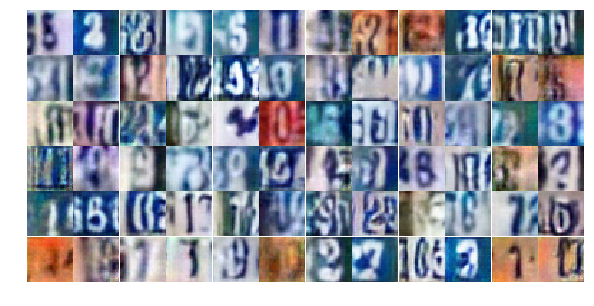

Epoch 12/25... Discriminator Loss: 0.6557... Generator Loss: 1.1176
Epoch 12/25... Discriminator Loss: 0.4404... Generator Loss: 1.3888
Epoch 12/25... Discriminator Loss: 0.3686... Generator Loss: 1.8405
Epoch 12/25... Discriminator Loss: 0.7740... Generator Loss: 1.0032
Epoch 12/25... Discriminator Loss: 1.1990... Generator Loss: 0.5599
Epoch 12/25... Discriminator Loss: 1.1040... Generator Loss: 0.5789
Epoch 12/25... Discriminator Loss: 0.9575... Generator Loss: 0.6733
Epoch 12/25... Discriminator Loss: 0.7854... Generator Loss: 0.9503
Epoch 12/25... Discriminator Loss: 0.4882... Generator Loss: 1.4281
Epoch 12/25... Discriminator Loss: 0.4460... Generator Loss: 1.4565


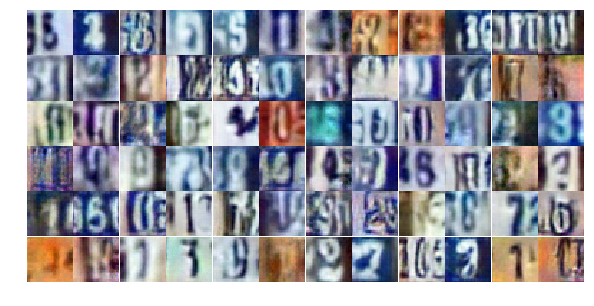

Epoch 12/25... Discriminator Loss: 0.8978... Generator Loss: 0.7570
Epoch 12/25... Discriminator Loss: 0.7612... Generator Loss: 0.9187
Epoch 12/25... Discriminator Loss: 0.8812... Generator Loss: 2.5461
Epoch 12/25... Discriminator Loss: 1.2265... Generator Loss: 0.4887
Epoch 12/25... Discriminator Loss: 0.6512... Generator Loss: 0.9739
Epoch 12/25... Discriminator Loss: 0.6893... Generator Loss: 1.8766
Epoch 12/25... Discriminator Loss: 1.0280... Generator Loss: 0.7203
Epoch 13/25... Discriminator Loss: 0.6287... Generator Loss: 1.1751
Epoch 13/25... Discriminator Loss: 0.4337... Generator Loss: 1.6449
Epoch 13/25... Discriminator Loss: 0.6989... Generator Loss: 1.0138


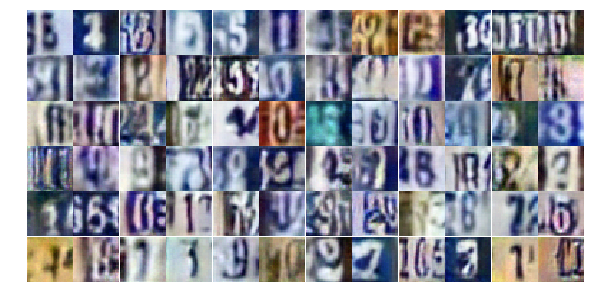

Epoch 13/25... Discriminator Loss: 0.6184... Generator Loss: 1.4142
Epoch 13/25... Discriminator Loss: 0.5595... Generator Loss: 1.2522
Epoch 13/25... Discriminator Loss: 1.4559... Generator Loss: 0.3665
Epoch 13/25... Discriminator Loss: 1.1523... Generator Loss: 0.5840
Epoch 13/25... Discriminator Loss: 0.5884... Generator Loss: 1.2325
Epoch 13/25... Discriminator Loss: 0.4729... Generator Loss: 1.6776
Epoch 13/25... Discriminator Loss: 0.4179... Generator Loss: 1.8116
Epoch 13/25... Discriminator Loss: 0.8422... Generator Loss: 0.7642
Epoch 13/25... Discriminator Loss: 0.5646... Generator Loss: 1.1584
Epoch 13/25... Discriminator Loss: 0.5722... Generator Loss: 1.2056


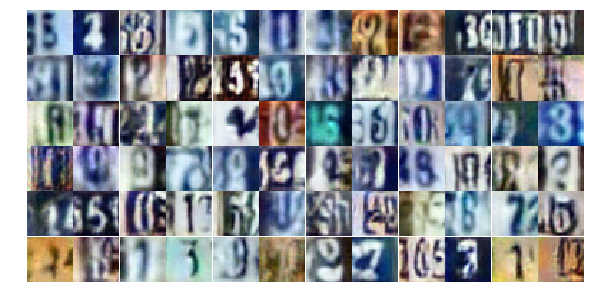

Epoch 13/25... Discriminator Loss: 0.8431... Generator Loss: 0.8050
Epoch 13/25... Discriminator Loss: 0.9230... Generator Loss: 0.6692
Epoch 13/25... Discriminator Loss: 0.9685... Generator Loss: 0.8032
Epoch 13/25... Discriminator Loss: 0.6671... Generator Loss: 1.2832
Epoch 13/25... Discriminator Loss: 0.6236... Generator Loss: 1.1368
Epoch 13/25... Discriminator Loss: 0.8555... Generator Loss: 0.7646
Epoch 13/25... Discriminator Loss: 0.6767... Generator Loss: 1.0633
Epoch 13/25... Discriminator Loss: 1.0508... Generator Loss: 0.5879
Epoch 13/25... Discriminator Loss: 0.7530... Generator Loss: 0.8613
Epoch 13/25... Discriminator Loss: 0.8360... Generator Loss: 0.8163


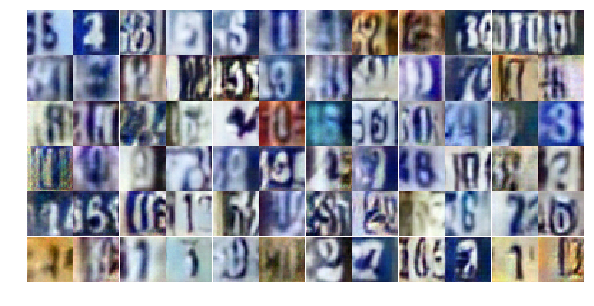

Epoch 13/25... Discriminator Loss: 0.6604... Generator Loss: 1.0291
Epoch 13/25... Discriminator Loss: 0.6374... Generator Loss: 1.1810
Epoch 13/25... Discriminator Loss: 0.5770... Generator Loss: 1.6233
Epoch 13/25... Discriminator Loss: 0.6946... Generator Loss: 0.9320
Epoch 13/25... Discriminator Loss: 0.6574... Generator Loss: 1.1105
Epoch 13/25... Discriminator Loss: 5.1060... Generator Loss: 0.0148
Epoch 13/25... Discriminator Loss: 2.0397... Generator Loss: 1.0434
Epoch 13/25... Discriminator Loss: 0.6733... Generator Loss: 1.1293
Epoch 13/25... Discriminator Loss: 0.6101... Generator Loss: 1.2291
Epoch 13/25... Discriminator Loss: 0.6191... Generator Loss: 1.3489


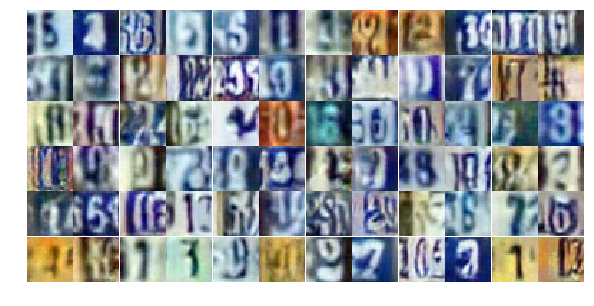

Epoch 13/25... Discriminator Loss: 1.3197... Generator Loss: 0.4012
Epoch 13/25... Discriminator Loss: 1.0471... Generator Loss: 0.8581
Epoch 13/25... Discriminator Loss: 1.4924... Generator Loss: 0.3571
Epoch 13/25... Discriminator Loss: 1.3279... Generator Loss: 0.4411
Epoch 13/25... Discriminator Loss: 0.5853... Generator Loss: 1.4157
Epoch 13/25... Discriminator Loss: 0.5739... Generator Loss: 1.2968
Epoch 13/25... Discriminator Loss: 0.6668... Generator Loss: 0.9978
Epoch 13/25... Discriminator Loss: 0.8262... Generator Loss: 0.9113
Epoch 13/25... Discriminator Loss: 0.6193... Generator Loss: 1.1312
Epoch 13/25... Discriminator Loss: 0.9265... Generator Loss: 0.6768


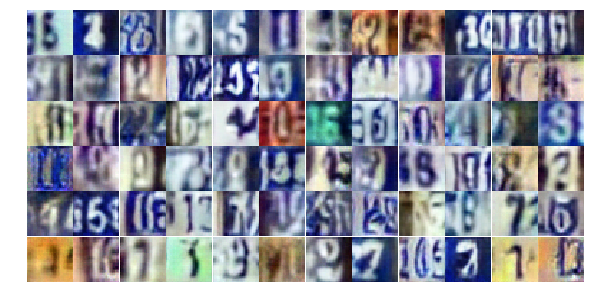

Epoch 13/25... Discriminator Loss: 0.4634... Generator Loss: 1.5463
Epoch 13/25... Discriminator Loss: 0.6775... Generator Loss: 1.0303
Epoch 13/25... Discriminator Loss: 1.0117... Generator Loss: 0.7034
Epoch 13/25... Discriminator Loss: 0.6454... Generator Loss: 1.0307
Epoch 13/25... Discriminator Loss: 1.0378... Generator Loss: 0.6353
Epoch 13/25... Discriminator Loss: 0.7017... Generator Loss: 1.1109
Epoch 13/25... Discriminator Loss: 0.6218... Generator Loss: 1.2905
Epoch 13/25... Discriminator Loss: 0.6300... Generator Loss: 1.3904
Epoch 13/25... Discriminator Loss: 0.8670... Generator Loss: 0.7046
Epoch 13/25... Discriminator Loss: 0.8421... Generator Loss: 0.7725


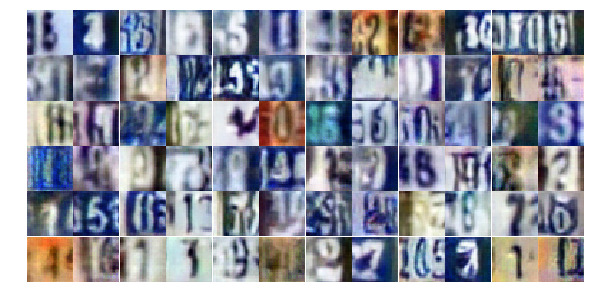

Epoch 13/25... Discriminator Loss: 0.3848... Generator Loss: 2.1925
Epoch 13/25... Discriminator Loss: 1.3636... Generator Loss: 0.4228
Epoch 13/25... Discriminator Loss: 0.6912... Generator Loss: 1.6632
Epoch 13/25... Discriminator Loss: 0.8549... Generator Loss: 0.7931
Epoch 14/25... Discriminator Loss: 0.9413... Generator Loss: 0.6662
Epoch 14/25... Discriminator Loss: 0.6083... Generator Loss: 1.5717
Epoch 14/25... Discriminator Loss: 0.9995... Generator Loss: 0.6926
Epoch 14/25... Discriminator Loss: 0.6666... Generator Loss: 1.8661
Epoch 14/25... Discriminator Loss: 0.5802... Generator Loss: 1.2074
Epoch 14/25... Discriminator Loss: 0.6880... Generator Loss: 1.0065


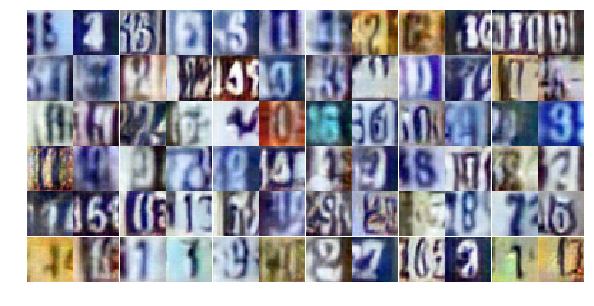

Epoch 14/25... Discriminator Loss: 1.2140... Generator Loss: 3.0519
Epoch 14/25... Discriminator Loss: 0.8982... Generator Loss: 0.7060
Epoch 14/25... Discriminator Loss: 0.5623... Generator Loss: 1.2917
Epoch 14/25... Discriminator Loss: 0.6285... Generator Loss: 1.2720
Epoch 14/25... Discriminator Loss: 0.9908... Generator Loss: 0.6769
Epoch 14/25... Discriminator Loss: 0.5025... Generator Loss: 1.2596
Epoch 14/25... Discriminator Loss: 0.4406... Generator Loss: 1.6250
Epoch 14/25... Discriminator Loss: 1.4164... Generator Loss: 0.3826
Epoch 14/25... Discriminator Loss: 1.0901... Generator Loss: 0.6516
Epoch 14/25... Discriminator Loss: 1.1316... Generator Loss: 0.5374


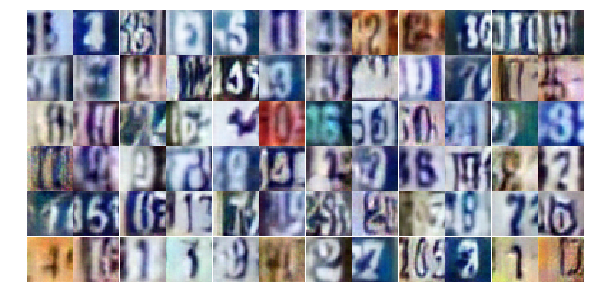

Epoch 14/25... Discriminator Loss: 0.6648... Generator Loss: 0.9991
Epoch 14/25... Discriminator Loss: 1.9704... Generator Loss: 4.9086
Epoch 14/25... Discriminator Loss: 0.9443... Generator Loss: 0.8383
Epoch 14/25... Discriminator Loss: 0.5238... Generator Loss: 1.4073
Epoch 14/25... Discriminator Loss: 0.9449... Generator Loss: 0.7156
Epoch 14/25... Discriminator Loss: 0.6928... Generator Loss: 1.0029
Epoch 14/25... Discriminator Loss: 0.8714... Generator Loss: 0.7678
Epoch 14/25... Discriminator Loss: 0.6156... Generator Loss: 1.1662
Epoch 14/25... Discriminator Loss: 0.6653... Generator Loss: 1.0989
Epoch 14/25... Discriminator Loss: 0.5843... Generator Loss: 1.3013


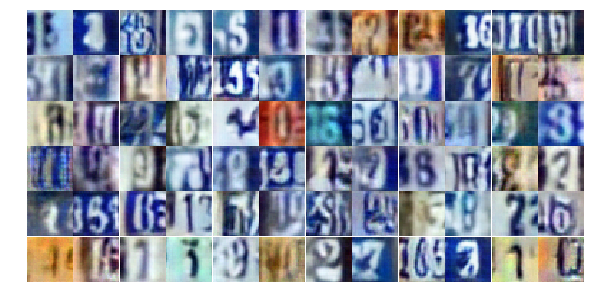

Epoch 14/25... Discriminator Loss: 1.2973... Generator Loss: 0.4242
Epoch 14/25... Discriminator Loss: 0.5526... Generator Loss: 1.4746
Epoch 14/25... Discriminator Loss: 0.4704... Generator Loss: 1.4429
Epoch 14/25... Discriminator Loss: 0.4075... Generator Loss: 1.5430
Epoch 14/25... Discriminator Loss: 0.6435... Generator Loss: 1.1435
Epoch 14/25... Discriminator Loss: 0.7303... Generator Loss: 0.9244
Epoch 14/25... Discriminator Loss: 0.6833... Generator Loss: 1.0711
Epoch 14/25... Discriminator Loss: 0.4499... Generator Loss: 1.5500
Epoch 14/25... Discriminator Loss: 0.5310... Generator Loss: 2.8251
Epoch 14/25... Discriminator Loss: 0.7130... Generator Loss: 1.1090


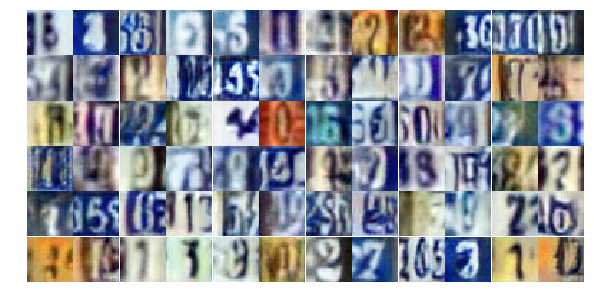

Epoch 14/25... Discriminator Loss: 1.1076... Generator Loss: 0.5704
Epoch 14/25... Discriminator Loss: 0.7489... Generator Loss: 0.9541
Epoch 14/25... Discriminator Loss: 0.9832... Generator Loss: 0.6451
Epoch 14/25... Discriminator Loss: 1.1680... Generator Loss: 0.5154
Epoch 14/25... Discriminator Loss: 1.0901... Generator Loss: 0.5888
Epoch 14/25... Discriminator Loss: 0.6692... Generator Loss: 1.4112
Epoch 14/25... Discriminator Loss: 0.5974... Generator Loss: 1.2207
Epoch 14/25... Discriminator Loss: 0.6525... Generator Loss: 1.0992
Epoch 14/25... Discriminator Loss: 1.3928... Generator Loss: 0.4161
Epoch 14/25... Discriminator Loss: 0.8988... Generator Loss: 0.8172


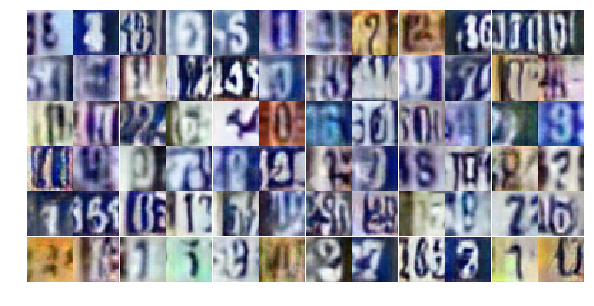

Epoch 14/25... Discriminator Loss: 2.1687... Generator Loss: 3.4887
Epoch 14/25... Discriminator Loss: 1.6799... Generator Loss: 0.3533
Epoch 14/25... Discriminator Loss: 0.6597... Generator Loss: 1.3084
Epoch 14/25... Discriminator Loss: 1.1439... Generator Loss: 0.5406
Epoch 14/25... Discriminator Loss: 0.6210... Generator Loss: 1.1684
Epoch 14/25... Discriminator Loss: 0.7163... Generator Loss: 1.2269
Epoch 14/25... Discriminator Loss: 0.8096... Generator Loss: 1.0491
Epoch 14/25... Discriminator Loss: 0.7143... Generator Loss: 1.0567
Epoch 14/25... Discriminator Loss: 0.9120... Generator Loss: 0.8765
Epoch 14/25... Discriminator Loss: 1.5311... Generator Loss: 0.3667


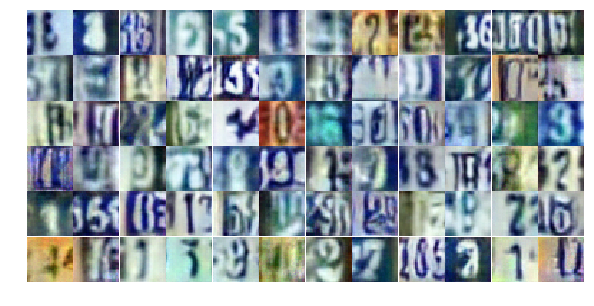

Epoch 14/25... Discriminator Loss: 1.4618... Generator Loss: 0.3786
Epoch 14/25... Discriminator Loss: 1.3356... Generator Loss: 0.4272
Epoch 15/25... Discriminator Loss: 0.7278... Generator Loss: 1.6179
Epoch 15/25... Discriminator Loss: 0.5278... Generator Loss: 1.4868
Epoch 15/25... Discriminator Loss: 0.6009... Generator Loss: 1.1723
Epoch 15/25... Discriminator Loss: 0.9020... Generator Loss: 0.8685
Epoch 15/25... Discriminator Loss: 0.7277... Generator Loss: 0.8586
Epoch 15/25... Discriminator Loss: 0.6430... Generator Loss: 1.1734
Epoch 15/25... Discriminator Loss: 1.3346... Generator Loss: 0.4376
Epoch 15/25... Discriminator Loss: 0.5299... Generator Loss: 1.2827


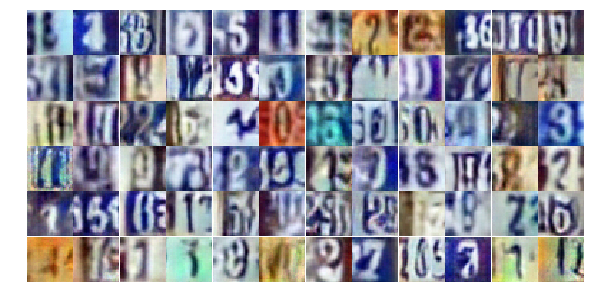

Epoch 15/25... Discriminator Loss: 0.7662... Generator Loss: 0.9468
Epoch 15/25... Discriminator Loss: 0.8490... Generator Loss: 1.4291
Epoch 15/25... Discriminator Loss: 0.7396... Generator Loss: 1.0557
Epoch 15/25... Discriminator Loss: 0.8730... Generator Loss: 0.7626
Epoch 15/25... Discriminator Loss: 0.9174... Generator Loss: 0.8836
Epoch 15/25... Discriminator Loss: 0.4819... Generator Loss: 1.4996
Epoch 15/25... Discriminator Loss: 1.3188... Generator Loss: 0.4671
Epoch 15/25... Discriminator Loss: 0.8047... Generator Loss: 1.5675
Epoch 15/25... Discriminator Loss: 0.5988... Generator Loss: 2.1663
Epoch 15/25... Discriminator Loss: 1.1210... Generator Loss: 0.5915


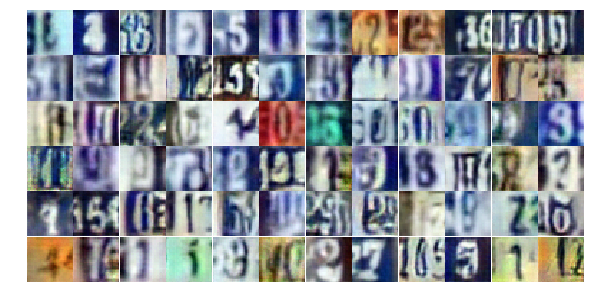

Epoch 15/25... Discriminator Loss: 0.8813... Generator Loss: 0.9523
Epoch 15/25... Discriminator Loss: 0.6410... Generator Loss: 1.0807
Epoch 15/25... Discriminator Loss: 0.5699... Generator Loss: 1.3708
Epoch 15/25... Discriminator Loss: 1.1755... Generator Loss: 0.5319
Epoch 15/25... Discriminator Loss: 1.1573... Generator Loss: 0.7229
Epoch 15/25... Discriminator Loss: 0.6224... Generator Loss: 1.1085
Epoch 15/25... Discriminator Loss: 1.0141... Generator Loss: 0.8105
Epoch 15/25... Discriminator Loss: 1.0886... Generator Loss: 0.6577
Epoch 15/25... Discriminator Loss: 0.5565... Generator Loss: 1.2700
Epoch 15/25... Discriminator Loss: 1.2917... Generator Loss: 0.5230


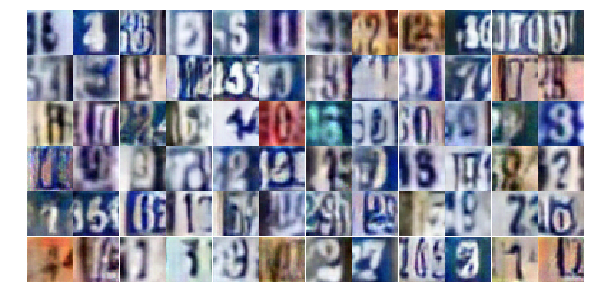

Epoch 15/25... Discriminator Loss: 0.7879... Generator Loss: 0.9240
Epoch 15/25... Discriminator Loss: 0.6287... Generator Loss: 1.6114
Epoch 15/25... Discriminator Loss: 0.4554... Generator Loss: 1.4039
Epoch 15/25... Discriminator Loss: 0.6781... Generator Loss: 1.3347
Epoch 15/25... Discriminator Loss: 0.5432... Generator Loss: 1.2601
Epoch 15/25... Discriminator Loss: 2.5269... Generator Loss: 4.7286
Epoch 15/25... Discriminator Loss: 0.8305... Generator Loss: 1.0169
Epoch 15/25... Discriminator Loss: 0.8407... Generator Loss: 0.8610
Epoch 15/25... Discriminator Loss: 0.5358... Generator Loss: 1.7652
Epoch 15/25... Discriminator Loss: 0.8257... Generator Loss: 1.3528


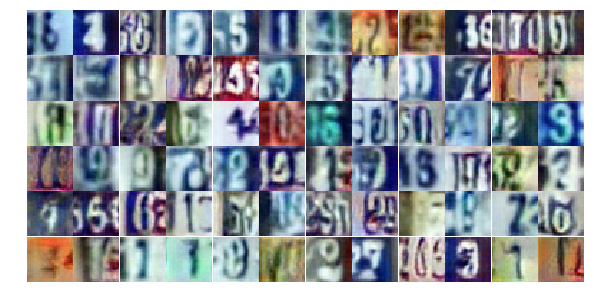

Epoch 15/25... Discriminator Loss: 0.6303... Generator Loss: 1.1276
Epoch 15/25... Discriminator Loss: 1.3001... Generator Loss: 0.4363
Epoch 15/25... Discriminator Loss: 0.8061... Generator Loss: 0.8095
Epoch 15/25... Discriminator Loss: 0.4432... Generator Loss: 1.5042
Epoch 15/25... Discriminator Loss: 0.5809... Generator Loss: 1.1697
Epoch 15/25... Discriminator Loss: 1.5796... Generator Loss: 0.3083
Epoch 15/25... Discriminator Loss: 0.5552... Generator Loss: 1.2256
Epoch 15/25... Discriminator Loss: 0.6629... Generator Loss: 1.1818
Epoch 15/25... Discriminator Loss: 0.6880... Generator Loss: 0.9525
Epoch 15/25... Discriminator Loss: 0.9982... Generator Loss: 0.7476


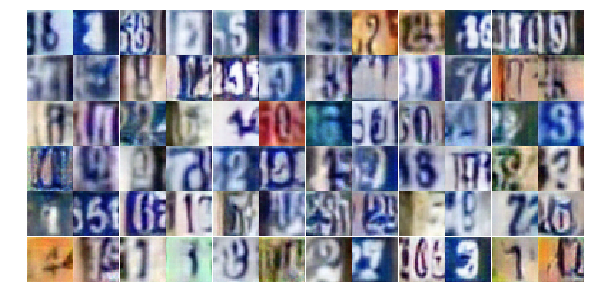

Epoch 15/25... Discriminator Loss: 1.0760... Generator Loss: 0.5618
Epoch 15/25... Discriminator Loss: 1.1321... Generator Loss: 0.6267
Epoch 15/25... Discriminator Loss: 0.4781... Generator Loss: 1.5682
Epoch 15/25... Discriminator Loss: 1.8933... Generator Loss: 0.2559
Epoch 15/25... Discriminator Loss: 1.1266... Generator Loss: 0.7824
Epoch 15/25... Discriminator Loss: 0.9974... Generator Loss: 0.7612
Epoch 15/25... Discriminator Loss: 1.0643... Generator Loss: 0.6870
Epoch 15/25... Discriminator Loss: 0.5522... Generator Loss: 1.4677
Epoch 15/25... Discriminator Loss: 1.3912... Generator Loss: 0.4181
Epoch 16/25... Discriminator Loss: 0.9296... Generator Loss: 0.7252


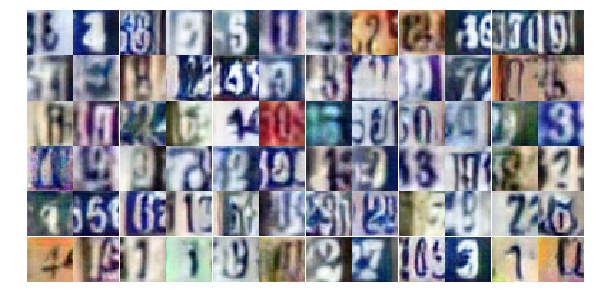

Epoch 16/25... Discriminator Loss: 0.5848... Generator Loss: 1.2013
Epoch 16/25... Discriminator Loss: 0.8360... Generator Loss: 0.9661
Epoch 16/25... Discriminator Loss: 0.8470... Generator Loss: 0.8751
Epoch 16/25... Discriminator Loss: 0.7308... Generator Loss: 1.0720
Epoch 16/25... Discriminator Loss: 0.5295... Generator Loss: 1.6067
Epoch 16/25... Discriminator Loss: 0.7007... Generator Loss: 1.6418
Epoch 16/25... Discriminator Loss: 1.3545... Generator Loss: 0.4383
Epoch 16/25... Discriminator Loss: 0.9910... Generator Loss: 0.5884
Epoch 16/25... Discriminator Loss: 0.8965... Generator Loss: 0.7419
Epoch 16/25... Discriminator Loss: 0.6696... Generator Loss: 1.0399


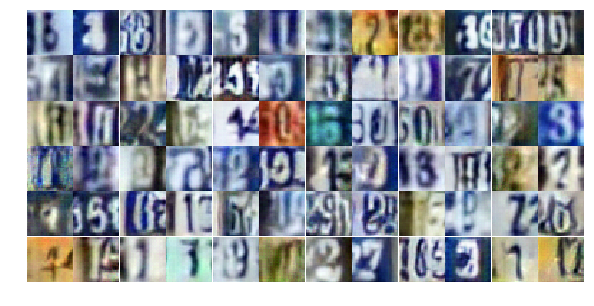

Epoch 16/25... Discriminator Loss: 1.3443... Generator Loss: 0.3955
Epoch 16/25... Discriminator Loss: 0.5508... Generator Loss: 1.3432
Epoch 16/25... Discriminator Loss: 0.8873... Generator Loss: 0.9009
Epoch 16/25... Discriminator Loss: 1.0987... Generator Loss: 0.5376
Epoch 16/25... Discriminator Loss: 0.5084... Generator Loss: 1.2429
Epoch 16/25... Discriminator Loss: 0.8638... Generator Loss: 0.8350
Epoch 16/25... Discriminator Loss: 1.6628... Generator Loss: 0.3117
Epoch 16/25... Discriminator Loss: 0.7976... Generator Loss: 1.2016
Epoch 16/25... Discriminator Loss: 0.5798... Generator Loss: 1.2922
Epoch 16/25... Discriminator Loss: 0.6573... Generator Loss: 1.3727


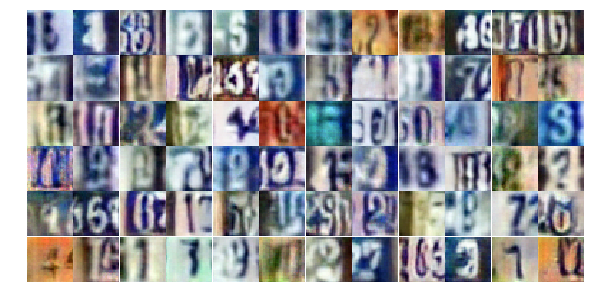

Epoch 16/25... Discriminator Loss: 0.6342... Generator Loss: 1.2957
Epoch 16/25... Discriminator Loss: 0.6217... Generator Loss: 1.1483
Epoch 16/25... Discriminator Loss: 0.7926... Generator Loss: 0.7825
Epoch 16/25... Discriminator Loss: 1.1160... Generator Loss: 0.5605
Epoch 16/25... Discriminator Loss: 0.8136... Generator Loss: 1.0399
Epoch 16/25... Discriminator Loss: 0.9538... Generator Loss: 0.7209
Epoch 16/25... Discriminator Loss: 0.7987... Generator Loss: 0.8255
Epoch 16/25... Discriminator Loss: 0.4906... Generator Loss: 1.2840
Epoch 16/25... Discriminator Loss: 1.1143... Generator Loss: 2.3389
Epoch 16/25... Discriminator Loss: 0.5988... Generator Loss: 1.1308


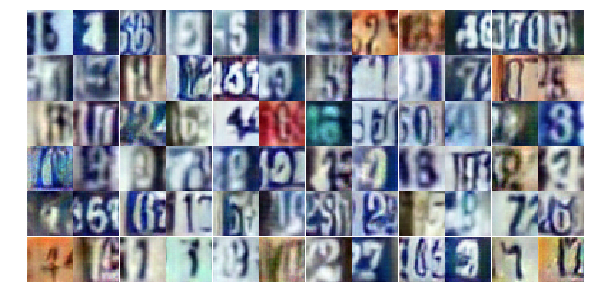

Epoch 16/25... Discriminator Loss: 0.7136... Generator Loss: 0.9113
Epoch 16/25... Discriminator Loss: 0.4892... Generator Loss: 1.3891
Epoch 16/25... Discriminator Loss: 0.8135... Generator Loss: 3.0083
Epoch 16/25... Discriminator Loss: 0.8105... Generator Loss: 0.8074
Epoch 16/25... Discriminator Loss: 0.8647... Generator Loss: 0.9829
Epoch 16/25... Discriminator Loss: 0.6398... Generator Loss: 1.9106
Epoch 16/25... Discriminator Loss: 0.9722... Generator Loss: 0.6395
Epoch 16/25... Discriminator Loss: 1.0483... Generator Loss: 0.6481
Epoch 16/25... Discriminator Loss: 0.6323... Generator Loss: 1.0713
Epoch 16/25... Discriminator Loss: 0.3952... Generator Loss: 1.6186


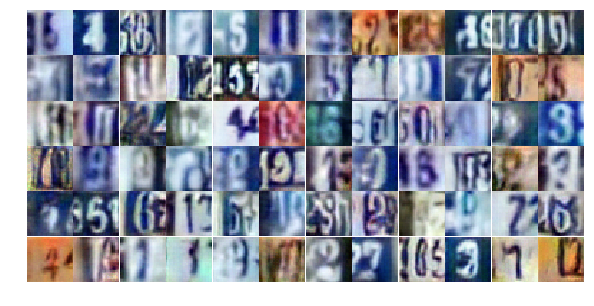

Epoch 16/25... Discriminator Loss: 0.5220... Generator Loss: 1.3791
Epoch 16/25... Discriminator Loss: 0.7352... Generator Loss: 0.9719
Epoch 16/25... Discriminator Loss: 0.9491... Generator Loss: 0.6476
Epoch 16/25... Discriminator Loss: 1.2186... Generator Loss: 0.5726
Epoch 16/25... Discriminator Loss: 0.7286... Generator Loss: 1.0736
Epoch 16/25... Discriminator Loss: 1.1523... Generator Loss: 0.4936
Epoch 16/25... Discriminator Loss: 0.6175... Generator Loss: 1.6995
Epoch 16/25... Discriminator Loss: 1.0758... Generator Loss: 0.6148
Epoch 16/25... Discriminator Loss: 0.5310... Generator Loss: 1.2857
Epoch 16/25... Discriminator Loss: 0.8094... Generator Loss: 0.8295


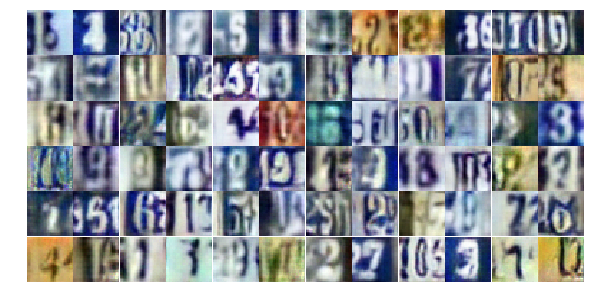

Epoch 16/25... Discriminator Loss: 1.4464... Generator Loss: 0.4370
Epoch 16/25... Discriminator Loss: 0.6757... Generator Loss: 0.9724
Epoch 16/25... Discriminator Loss: 1.7297... Generator Loss: 0.3129
Epoch 16/25... Discriminator Loss: 0.4836... Generator Loss: 2.3995
Epoch 16/25... Discriminator Loss: 0.5803... Generator Loss: 1.4046
Epoch 16/25... Discriminator Loss: 0.8664... Generator Loss: 0.8256
Epoch 17/25... Discriminator Loss: 0.6236... Generator Loss: 1.8966
Epoch 17/25... Discriminator Loss: 0.8864... Generator Loss: 0.7564
Epoch 17/25... Discriminator Loss: 0.7648... Generator Loss: 0.9497
Epoch 17/25... Discriminator Loss: 0.8192... Generator Loss: 0.9324


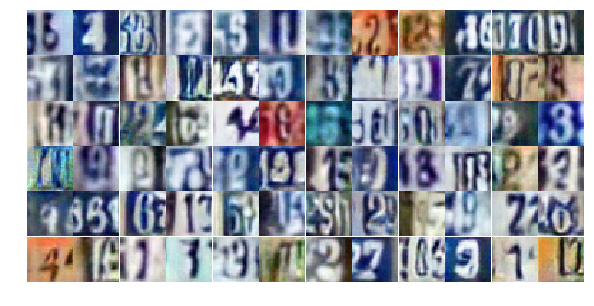

Epoch 17/25... Discriminator Loss: 0.5492... Generator Loss: 1.3660
Epoch 17/25... Discriminator Loss: 0.3296... Generator Loss: 1.7282
Epoch 17/25... Discriminator Loss: 0.8013... Generator Loss: 1.0462
Epoch 17/25... Discriminator Loss: 1.0468... Generator Loss: 0.6244
Epoch 17/25... Discriminator Loss: 1.2878... Generator Loss: 0.4977
Epoch 17/25... Discriminator Loss: 1.0890... Generator Loss: 0.5938
Epoch 17/25... Discriminator Loss: 0.7021... Generator Loss: 1.0805
Epoch 17/25... Discriminator Loss: 0.5645... Generator Loss: 1.2047
Epoch 17/25... Discriminator Loss: 0.4172... Generator Loss: 1.5160
Epoch 17/25... Discriminator Loss: 0.5975... Generator Loss: 1.3457


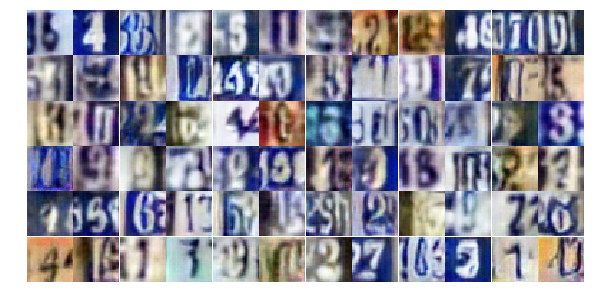

Epoch 17/25... Discriminator Loss: 0.9121... Generator Loss: 0.8159
Epoch 17/25... Discriminator Loss: 0.7580... Generator Loss: 1.0267
Epoch 17/25... Discriminator Loss: 0.4795... Generator Loss: 1.6234
Epoch 17/25... Discriminator Loss: 0.7145... Generator Loss: 1.0528
Epoch 17/25... Discriminator Loss: 0.5169... Generator Loss: 2.4052
Epoch 17/25... Discriminator Loss: 0.9933... Generator Loss: 0.7277
Epoch 17/25... Discriminator Loss: 0.4992... Generator Loss: 1.7959
Epoch 17/25... Discriminator Loss: 0.6766... Generator Loss: 0.9970
Epoch 17/25... Discriminator Loss: 0.7719... Generator Loss: 0.9085
Epoch 17/25... Discriminator Loss: 0.5769... Generator Loss: 1.1051


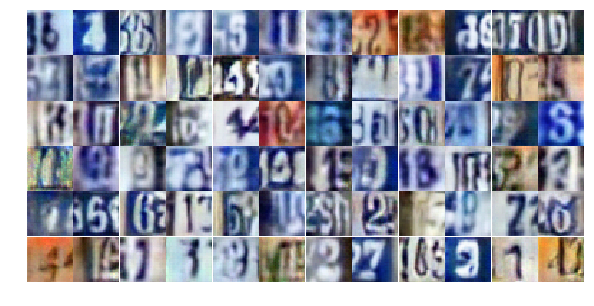

Epoch 17/25... Discriminator Loss: 1.5407... Generator Loss: 0.3587
Epoch 17/25... Discriminator Loss: 0.4231... Generator Loss: 1.9463
Epoch 17/25... Discriminator Loss: 0.6210... Generator Loss: 2.3275
Epoch 17/25... Discriminator Loss: 1.1856... Generator Loss: 0.5470
Epoch 17/25... Discriminator Loss: 1.0817... Generator Loss: 0.6475
Epoch 17/25... Discriminator Loss: 0.4030... Generator Loss: 1.5140
Epoch 17/25... Discriminator Loss: 0.5873... Generator Loss: 1.1317
Epoch 17/25... Discriminator Loss: 0.6794... Generator Loss: 1.0282
Epoch 17/25... Discriminator Loss: 0.8331... Generator Loss: 0.8999
Epoch 17/25... Discriminator Loss: 0.3673... Generator Loss: 2.1393


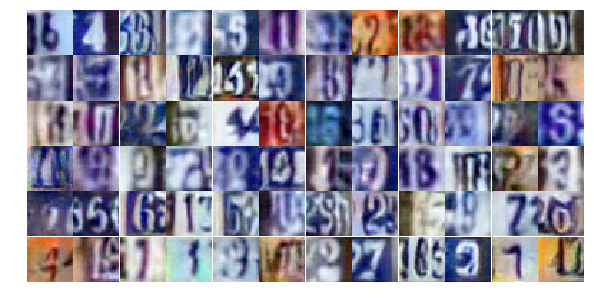

Epoch 17/25... Discriminator Loss: 1.2022... Generator Loss: 0.5499
Epoch 17/25... Discriminator Loss: 1.1252... Generator Loss: 0.9270
Epoch 17/25... Discriminator Loss: 0.6184... Generator Loss: 1.2421
Epoch 17/25... Discriminator Loss: 0.9773... Generator Loss: 0.7557
Epoch 17/25... Discriminator Loss: 1.0184... Generator Loss: 0.6648
Epoch 17/25... Discriminator Loss: 0.6549... Generator Loss: 1.1799
Epoch 17/25... Discriminator Loss: 0.8465... Generator Loss: 0.7914
Epoch 17/25... Discriminator Loss: 0.5374... Generator Loss: 1.3160
Epoch 17/25... Discriminator Loss: 0.3226... Generator Loss: 1.9883
Epoch 17/25... Discriminator Loss: 0.9989... Generator Loss: 0.6416


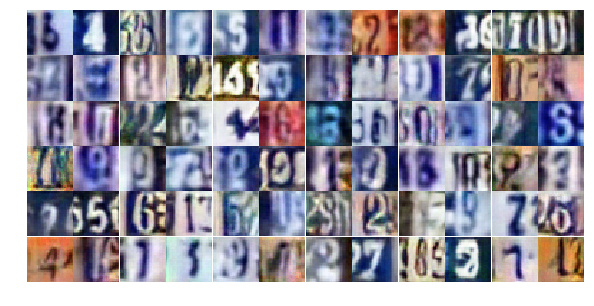

Epoch 17/25... Discriminator Loss: 1.6139... Generator Loss: 0.9126
Epoch 17/25... Discriminator Loss: 0.3865... Generator Loss: 2.3369
Epoch 17/25... Discriminator Loss: 0.6806... Generator Loss: 1.7535
Epoch 17/25... Discriminator Loss: 0.3289... Generator Loss: 1.7343
Epoch 17/25... Discriminator Loss: 0.7686... Generator Loss: 0.8894
Epoch 17/25... Discriminator Loss: 0.7834... Generator Loss: 0.9867
Epoch 17/25... Discriminator Loss: 1.1894... Generator Loss: 0.5486
Epoch 17/25... Discriminator Loss: 0.6767... Generator Loss: 1.1667
Epoch 17/25... Discriminator Loss: 0.7084... Generator Loss: 0.9481
Epoch 17/25... Discriminator Loss: 1.4207... Generator Loss: 0.4014


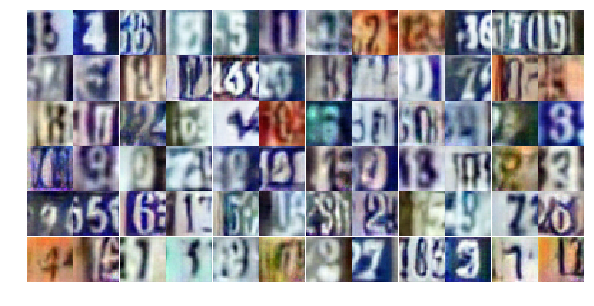

Epoch 17/25... Discriminator Loss: 0.7417... Generator Loss: 0.9817
Epoch 17/25... Discriminator Loss: 0.9828... Generator Loss: 0.6733
Epoch 17/25... Discriminator Loss: 0.6108... Generator Loss: 1.1561
Epoch 17/25... Discriminator Loss: 0.8220... Generator Loss: 0.8049
Epoch 18/25... Discriminator Loss: 0.8194... Generator Loss: 0.7962
Epoch 18/25... Discriminator Loss: 1.2187... Generator Loss: 0.4617
Epoch 18/25... Discriminator Loss: 0.6853... Generator Loss: 1.0175
Epoch 18/25... Discriminator Loss: 0.8725... Generator Loss: 0.7230
Epoch 18/25... Discriminator Loss: 1.3808... Generator Loss: 0.4709
Epoch 18/25... Discriminator Loss: 0.6762... Generator Loss: 1.1261


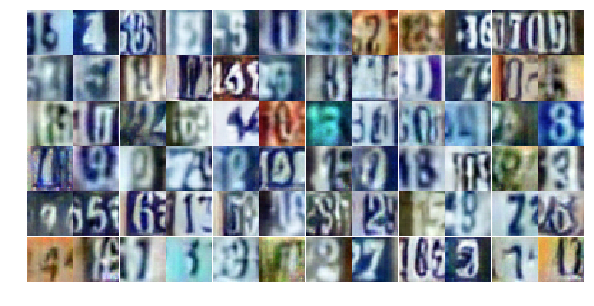

Epoch 18/25... Discriminator Loss: 0.5213... Generator Loss: 1.9694
Epoch 18/25... Discriminator Loss: 0.8718... Generator Loss: 0.7790
Epoch 18/25... Discriminator Loss: 0.8724... Generator Loss: 0.7363
Epoch 18/25... Discriminator Loss: 0.4607... Generator Loss: 1.8921
Epoch 18/25... Discriminator Loss: 1.1738... Generator Loss: 0.5164
Epoch 18/25... Discriminator Loss: 1.1176... Generator Loss: 0.5562
Epoch 18/25... Discriminator Loss: 0.5531... Generator Loss: 1.2416
Epoch 18/25... Discriminator Loss: 0.8332... Generator Loss: 0.8141
Epoch 18/25... Discriminator Loss: 0.8030... Generator Loss: 0.9677
Epoch 18/25... Discriminator Loss: 0.3512... Generator Loss: 2.1898


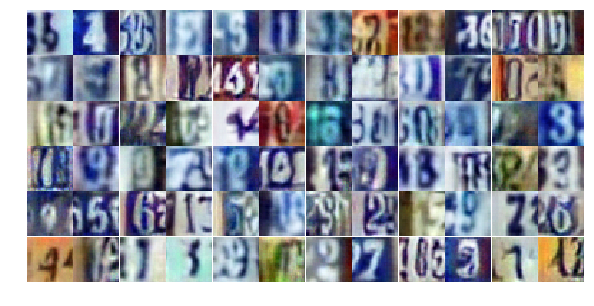

Epoch 18/25... Discriminator Loss: 0.4621... Generator Loss: 1.6703
Epoch 18/25... Discriminator Loss: 0.5506... Generator Loss: 1.7385
Epoch 18/25... Discriminator Loss: 1.2370... Generator Loss: 0.4959
Epoch 18/25... Discriminator Loss: 0.5665... Generator Loss: 1.2314
Epoch 18/25... Discriminator Loss: 1.2744... Generator Loss: 0.5082
Epoch 18/25... Discriminator Loss: 1.4005... Generator Loss: 0.3983
Epoch 18/25... Discriminator Loss: 1.2528... Generator Loss: 0.5192
Epoch 18/25... Discriminator Loss: 1.1652... Generator Loss: 0.5351
Epoch 18/25... Discriminator Loss: 0.9331... Generator Loss: 0.7379
Epoch 18/25... Discriminator Loss: 0.5258... Generator Loss: 1.5405


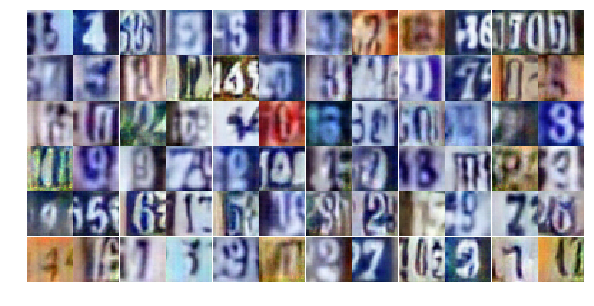

Epoch 18/25... Discriminator Loss: 0.4614... Generator Loss: 1.7150
Epoch 18/25... Discriminator Loss: 0.8004... Generator Loss: 2.4497
Epoch 18/25... Discriminator Loss: 1.2734... Generator Loss: 0.4833
Epoch 18/25... Discriminator Loss: 0.8133... Generator Loss: 0.8673
Epoch 18/25... Discriminator Loss: 0.7343... Generator Loss: 0.9303
Epoch 18/25... Discriminator Loss: 0.6799... Generator Loss: 1.0047
Epoch 18/25... Discriminator Loss: 0.6815... Generator Loss: 0.9715
Epoch 18/25... Discriminator Loss: 0.5891... Generator Loss: 1.2346
Epoch 18/25... Discriminator Loss: 0.6332... Generator Loss: 1.0069
Epoch 18/25... Discriminator Loss: 0.6460... Generator Loss: 1.3583


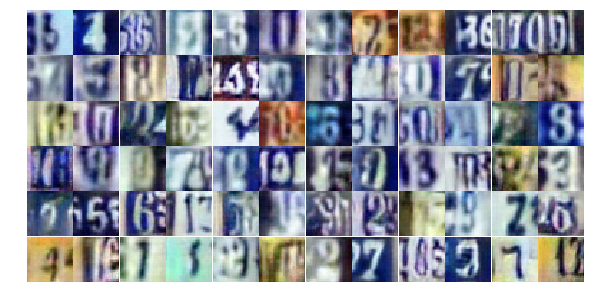

Epoch 18/25... Discriminator Loss: 1.0124... Generator Loss: 0.6983
Epoch 18/25... Discriminator Loss: 0.6272... Generator Loss: 1.1407
Epoch 18/25... Discriminator Loss: 0.7112... Generator Loss: 1.0153
Epoch 18/25... Discriminator Loss: 0.5187... Generator Loss: 1.3044
Epoch 18/25... Discriminator Loss: 0.9243... Generator Loss: 0.7101
Epoch 18/25... Discriminator Loss: 0.5164... Generator Loss: 1.1883
Epoch 18/25... Discriminator Loss: 1.0243... Generator Loss: 0.6876
Epoch 18/25... Discriminator Loss: 1.3501... Generator Loss: 0.4657
Epoch 18/25... Discriminator Loss: 0.6579... Generator Loss: 1.2990
Epoch 18/25... Discriminator Loss: 0.3077... Generator Loss: 2.2643


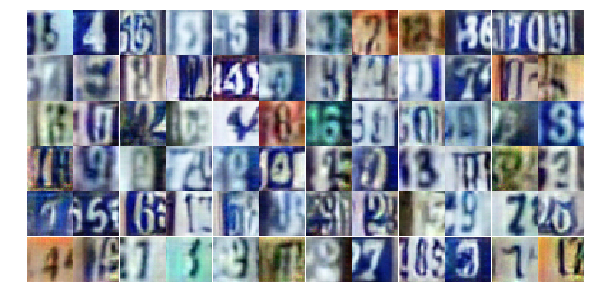

Epoch 18/25... Discriminator Loss: 0.5816... Generator Loss: 1.3193
Epoch 18/25... Discriminator Loss: 0.6654... Generator Loss: 1.6770
Epoch 18/25... Discriminator Loss: 0.7210... Generator Loss: 0.9900
Epoch 18/25... Discriminator Loss: 0.9712... Generator Loss: 0.8387
Epoch 18/25... Discriminator Loss: 0.4970... Generator Loss: 1.3405
Epoch 18/25... Discriminator Loss: 0.4926... Generator Loss: 1.7059
Epoch 18/25... Discriminator Loss: 0.6199... Generator Loss: 1.0290
Epoch 18/25... Discriminator Loss: 0.5304... Generator Loss: 1.7192
Epoch 18/25... Discriminator Loss: 1.2538... Generator Loss: 0.5893
Epoch 18/25... Discriminator Loss: 0.9994... Generator Loss: 0.6209


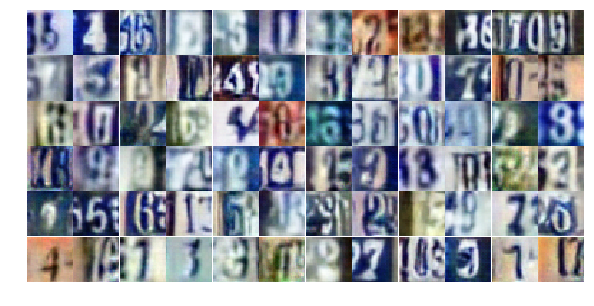

Epoch 18/25... Discriminator Loss: 0.5495... Generator Loss: 1.8780
Epoch 19/25... Discriminator Loss: 0.7758... Generator Loss: 1.5177
Epoch 19/25... Discriminator Loss: 1.2564... Generator Loss: 0.4906
Epoch 19/25... Discriminator Loss: 0.6684... Generator Loss: 1.0924
Epoch 19/25... Discriminator Loss: 0.6110... Generator Loss: 1.1266
Epoch 19/25... Discriminator Loss: 1.0659... Generator Loss: 0.6098
Epoch 19/25... Discriminator Loss: 0.6170... Generator Loss: 1.1865
Epoch 19/25... Discriminator Loss: 1.1094... Generator Loss: 0.6005
Epoch 19/25... Discriminator Loss: 0.8449... Generator Loss: 2.6694
Epoch 19/25... Discriminator Loss: 0.8118... Generator Loss: 1.0099


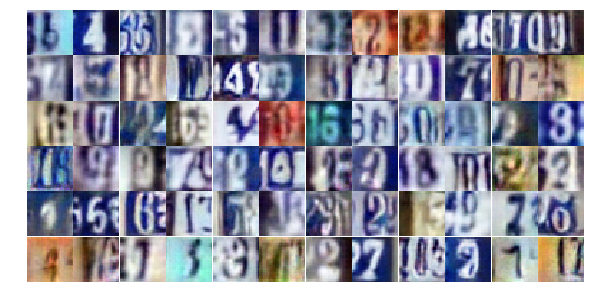

Epoch 19/25... Discriminator Loss: 0.5371... Generator Loss: 1.2094
Epoch 19/25... Discriminator Loss: 0.8384... Generator Loss: 0.9092
Epoch 19/25... Discriminator Loss: 0.9354... Generator Loss: 2.3726
Epoch 19/25... Discriminator Loss: 3.9962... Generator Loss: 5.6261
Epoch 19/25... Discriminator Loss: 3.2712... Generator Loss: 0.1001
Epoch 19/25... Discriminator Loss: 1.7606... Generator Loss: 1.1990
Epoch 19/25... Discriminator Loss: 1.6752... Generator Loss: 0.7005
Epoch 19/25... Discriminator Loss: 1.4026... Generator Loss: 0.9509
Epoch 19/25... Discriminator Loss: 1.3373... Generator Loss: 0.7873
Epoch 19/25... Discriminator Loss: 1.2999... Generator Loss: 0.9236


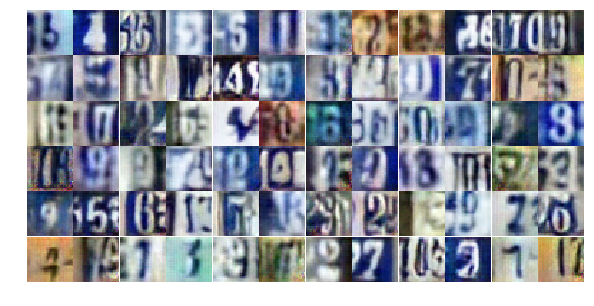

Epoch 19/25... Discriminator Loss: 1.3008... Generator Loss: 0.5603
Epoch 19/25... Discriminator Loss: 1.5153... Generator Loss: 1.1110
Epoch 19/25... Discriminator Loss: 2.4076... Generator Loss: 2.9667
Epoch 19/25... Discriminator Loss: 0.8373... Generator Loss: 0.9560
Epoch 19/25... Discriminator Loss: 0.9015... Generator Loss: 0.9619
Epoch 19/25... Discriminator Loss: 1.2374... Generator Loss: 0.7406
Epoch 19/25... Discriminator Loss: 0.9993... Generator Loss: 0.7396
Epoch 19/25... Discriminator Loss: 0.8015... Generator Loss: 1.8478
Epoch 19/25... Discriminator Loss: 0.8762... Generator Loss: 0.8129
Epoch 19/25... Discriminator Loss: 1.1324... Generator Loss: 0.5855


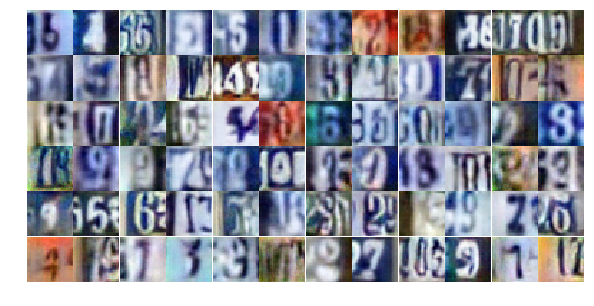

Epoch 19/25... Discriminator Loss: 0.8612... Generator Loss: 0.8640
Epoch 19/25... Discriminator Loss: 0.6195... Generator Loss: 1.1167
Epoch 19/25... Discriminator Loss: 1.0133... Generator Loss: 0.6538
Epoch 19/25... Discriminator Loss: 0.6843... Generator Loss: 1.0067
Epoch 19/25... Discriminator Loss: 0.7307... Generator Loss: 1.1844
Epoch 19/25... Discriminator Loss: 1.1415... Generator Loss: 0.5865
Epoch 19/25... Discriminator Loss: 0.7256... Generator Loss: 1.1970
Epoch 19/25... Discriminator Loss: 0.5409... Generator Loss: 1.6345
Epoch 19/25... Discriminator Loss: 0.7651... Generator Loss: 0.8733
Epoch 19/25... Discriminator Loss: 0.6953... Generator Loss: 1.0106


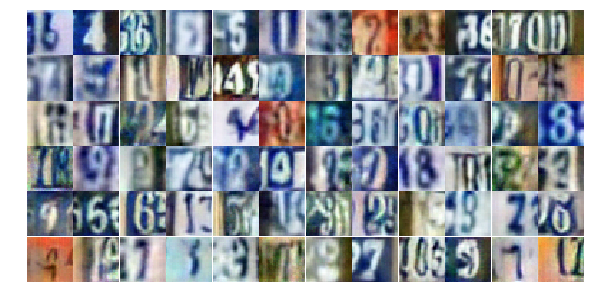

Epoch 19/25... Discriminator Loss: 0.6476... Generator Loss: 1.0247
Epoch 19/25... Discriminator Loss: 0.6401... Generator Loss: 1.1205
Epoch 19/25... Discriminator Loss: 1.0457... Generator Loss: 0.6350
Epoch 19/25... Discriminator Loss: 0.5244... Generator Loss: 1.3414
Epoch 19/25... Discriminator Loss: 0.9085... Generator Loss: 0.7239
Epoch 19/25... Discriminator Loss: 0.5633... Generator Loss: 1.9624
Epoch 19/25... Discriminator Loss: 0.7515... Generator Loss: 0.9585
Epoch 19/25... Discriminator Loss: 0.5071... Generator Loss: 1.4297
Epoch 19/25... Discriminator Loss: 0.7572... Generator Loss: 0.9764
Epoch 19/25... Discriminator Loss: 0.9273... Generator Loss: 0.7310


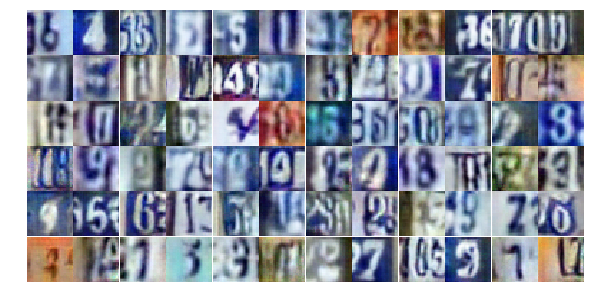

Epoch 19/25... Discriminator Loss: 1.0108... Generator Loss: 0.6562
Epoch 19/25... Discriminator Loss: 0.7642... Generator Loss: 0.9998
Epoch 19/25... Discriminator Loss: 0.8945... Generator Loss: 2.9627
Epoch 19/25... Discriminator Loss: 1.0410... Generator Loss: 0.6462
Epoch 19/25... Discriminator Loss: 0.6819... Generator Loss: 1.2485
Epoch 19/25... Discriminator Loss: 0.7563... Generator Loss: 1.1664
Epoch 19/25... Discriminator Loss: 1.5818... Generator Loss: 0.3589
Epoch 19/25... Discriminator Loss: 0.7983... Generator Loss: 0.8213
Epoch 20/25... Discriminator Loss: 0.5663... Generator Loss: 1.6701
Epoch 20/25... Discriminator Loss: 0.8378... Generator Loss: 0.7675


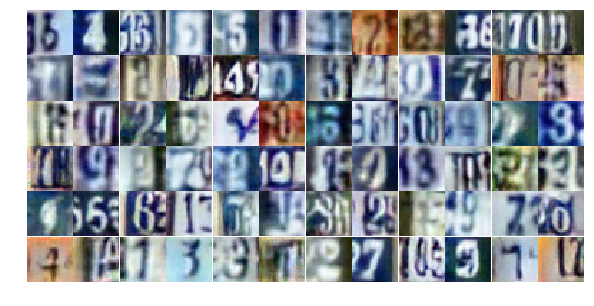

Epoch 20/25... Discriminator Loss: 0.5396... Generator Loss: 1.1812
Epoch 20/25... Discriminator Loss: 1.0156... Generator Loss: 0.7097
Epoch 20/25... Discriminator Loss: 1.1803... Generator Loss: 0.5885
Epoch 20/25... Discriminator Loss: 1.3156... Generator Loss: 0.4243
Epoch 20/25... Discriminator Loss: 0.5729... Generator Loss: 1.2045
Epoch 20/25... Discriminator Loss: 0.7858... Generator Loss: 0.8151
Epoch 20/25... Discriminator Loss: 0.7707... Generator Loss: 0.8365
Epoch 20/25... Discriminator Loss: 0.7270... Generator Loss: 0.9882
Epoch 20/25... Discriminator Loss: 1.1725... Generator Loss: 0.6011
Epoch 20/25... Discriminator Loss: 0.5129... Generator Loss: 1.3031


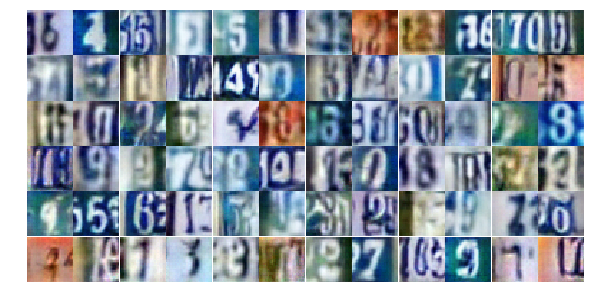

Epoch 20/25... Discriminator Loss: 1.0138... Generator Loss: 0.6946
Epoch 20/25... Discriminator Loss: 1.8200... Generator Loss: 0.2520
Epoch 20/25... Discriminator Loss: 0.6798... Generator Loss: 1.4413
Epoch 20/25... Discriminator Loss: 1.0896... Generator Loss: 0.6438
Epoch 20/25... Discriminator Loss: 0.8851... Generator Loss: 0.7726
Epoch 20/25... Discriminator Loss: 1.3748... Generator Loss: 0.5502
Epoch 20/25... Discriminator Loss: 1.7794... Generator Loss: 0.2850
Epoch 20/25... Discriminator Loss: 0.4800... Generator Loss: 1.8189
Epoch 20/25... Discriminator Loss: 0.6924... Generator Loss: 1.2902
Epoch 20/25... Discriminator Loss: 1.1591... Generator Loss: 0.5476


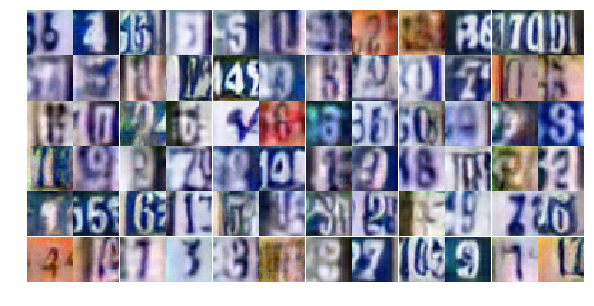

Epoch 20/25... Discriminator Loss: 0.6792... Generator Loss: 1.8833
Epoch 20/25... Discriminator Loss: 0.9349... Generator Loss: 0.7641
Epoch 20/25... Discriminator Loss: 0.4171... Generator Loss: 1.4783
Epoch 20/25... Discriminator Loss: 1.3109... Generator Loss: 0.5171
Epoch 20/25... Discriminator Loss: 0.8049... Generator Loss: 0.9404
Epoch 20/25... Discriminator Loss: 0.4461... Generator Loss: 1.8647
Epoch 20/25... Discriminator Loss: 0.8365... Generator Loss: 0.8545
Epoch 20/25... Discriminator Loss: 1.5907... Generator Loss: 0.3706
Epoch 20/25... Discriminator Loss: 0.9090... Generator Loss: 0.7301
Epoch 20/25... Discriminator Loss: 0.3317... Generator Loss: 1.8149


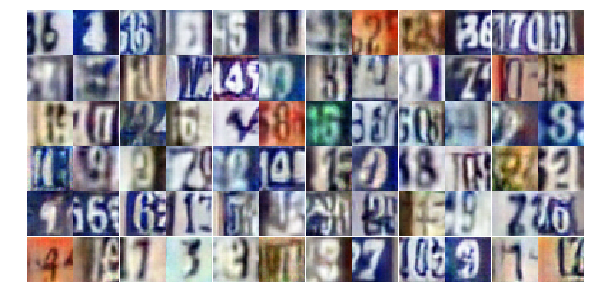

Epoch 20/25... Discriminator Loss: 0.6972... Generator Loss: 1.0554
Epoch 20/25... Discriminator Loss: 0.5584... Generator Loss: 1.2875
Epoch 20/25... Discriminator Loss: 1.0300... Generator Loss: 0.6427
Epoch 20/25... Discriminator Loss: 0.8061... Generator Loss: 1.0056
Epoch 20/25... Discriminator Loss: 0.8525... Generator Loss: 0.9039
Epoch 20/25... Discriminator Loss: 0.6201... Generator Loss: 1.3072
Epoch 20/25... Discriminator Loss: 0.7707... Generator Loss: 1.0985
Epoch 20/25... Discriminator Loss: 0.6896... Generator Loss: 1.1366
Epoch 20/25... Discriminator Loss: 1.0251... Generator Loss: 0.6883
Epoch 20/25... Discriminator Loss: 1.2313... Generator Loss: 0.5206


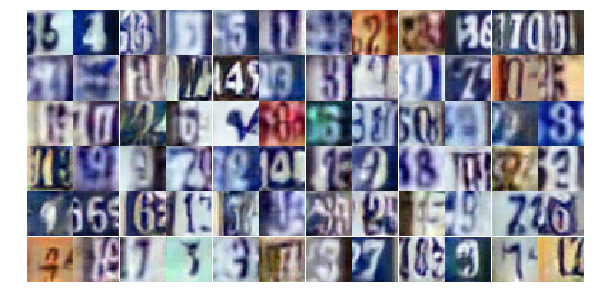

Epoch 20/25... Discriminator Loss: 1.2240... Generator Loss: 0.5268
Epoch 20/25... Discriminator Loss: 0.9911... Generator Loss: 0.6962
Epoch 20/25... Discriminator Loss: 0.5621... Generator Loss: 2.1901
Epoch 20/25... Discriminator Loss: 1.0225... Generator Loss: 0.7205
Epoch 20/25... Discriminator Loss: 1.0447... Generator Loss: 2.9235
Epoch 20/25... Discriminator Loss: 0.8375... Generator Loss: 1.0981
Epoch 20/25... Discriminator Loss: 1.5889... Generator Loss: 0.3355
Epoch 20/25... Discriminator Loss: 0.4897... Generator Loss: 1.7224
Epoch 20/25... Discriminator Loss: 0.7253... Generator Loss: 0.9744
Epoch 20/25... Discriminator Loss: 0.6177... Generator Loss: 1.1661


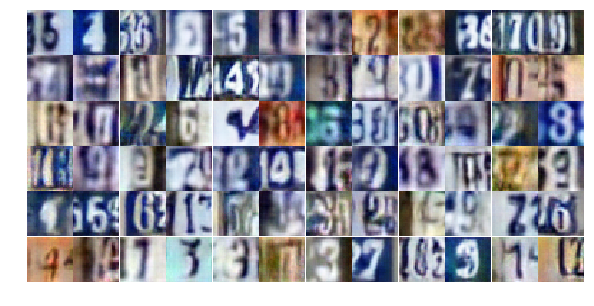

Epoch 20/25... Discriminator Loss: 0.6029... Generator Loss: 1.1927
Epoch 20/25... Discriminator Loss: 0.7290... Generator Loss: 0.9523
Epoch 20/25... Discriminator Loss: 0.4944... Generator Loss: 2.0705
Epoch 20/25... Discriminator Loss: 1.1024... Generator Loss: 1.3056
Epoch 20/25... Discriminator Loss: 0.5912... Generator Loss: 1.1382
Epoch 20/25... Discriminator Loss: 0.6688... Generator Loss: 0.9975
Epoch 21/25... Discriminator Loss: 1.0628... Generator Loss: 0.6841
Epoch 21/25... Discriminator Loss: 0.7422... Generator Loss: 0.9585
Epoch 21/25... Discriminator Loss: 1.4170... Generator Loss: 0.4168
Epoch 21/25... Discriminator Loss: 1.2521... Generator Loss: 0.4867


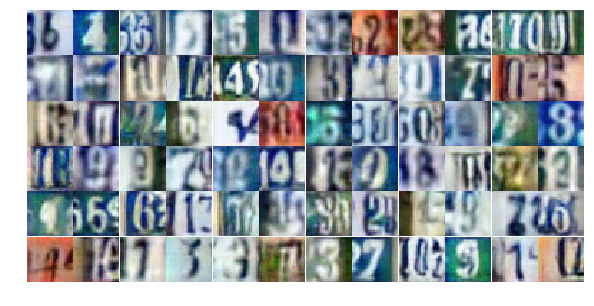

Epoch 21/25... Discriminator Loss: 0.8287... Generator Loss: 0.8542
Epoch 21/25... Discriminator Loss: 1.7512... Generator Loss: 0.2671
Epoch 21/25... Discriminator Loss: 0.5021... Generator Loss: 1.4467
Epoch 21/25... Discriminator Loss: 0.3759... Generator Loss: 2.6678
Epoch 21/25... Discriminator Loss: 0.6983... Generator Loss: 1.3956
Epoch 21/25... Discriminator Loss: 0.4066... Generator Loss: 1.7170
Epoch 21/25... Discriminator Loss: 1.1601... Generator Loss: 0.5020
Epoch 21/25... Discriminator Loss: 1.1023... Generator Loss: 0.5951
Epoch 21/25... Discriminator Loss: 0.5663... Generator Loss: 1.3826
Epoch 21/25... Discriminator Loss: 1.1724... Generator Loss: 0.5640


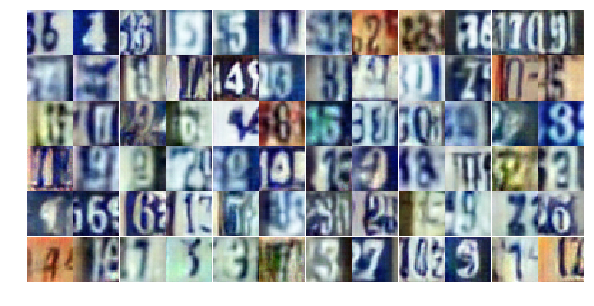

Epoch 21/25... Discriminator Loss: 0.3111... Generator Loss: 2.2625
Epoch 21/25... Discriminator Loss: 0.9856... Generator Loss: 0.7387
Epoch 21/25... Discriminator Loss: 1.6838... Generator Loss: 0.3142
Epoch 21/25... Discriminator Loss: 0.7280... Generator Loss: 1.0034
Epoch 21/25... Discriminator Loss: 0.7631... Generator Loss: 0.8998
Epoch 21/25... Discriminator Loss: 1.1316... Generator Loss: 0.5927
Epoch 21/25... Discriminator Loss: 1.0136... Generator Loss: 0.6974
Epoch 21/25... Discriminator Loss: 0.4498... Generator Loss: 1.5258
Epoch 21/25... Discriminator Loss: 0.5261... Generator Loss: 1.5131
Epoch 21/25... Discriminator Loss: 1.0259... Generator Loss: 0.6522


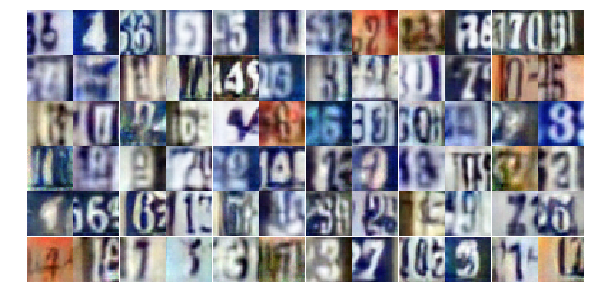

Epoch 21/25... Discriminator Loss: 1.4814... Generator Loss: 0.3691
Epoch 21/25... Discriminator Loss: 0.4046... Generator Loss: 1.6152
Epoch 21/25... Discriminator Loss: 1.4395... Generator Loss: 0.3704
Epoch 21/25... Discriminator Loss: 0.7028... Generator Loss: 1.3116
Epoch 21/25... Discriminator Loss: 1.0196... Generator Loss: 0.6581
Epoch 21/25... Discriminator Loss: 0.9827... Generator Loss: 0.6949
Epoch 21/25... Discriminator Loss: 0.6882... Generator Loss: 0.9465
Epoch 21/25... Discriminator Loss: 0.9178... Generator Loss: 0.7836
Epoch 21/25... Discriminator Loss: 1.4015... Generator Loss: 0.4451
Epoch 21/25... Discriminator Loss: 2.0717... Generator Loss: 0.2278


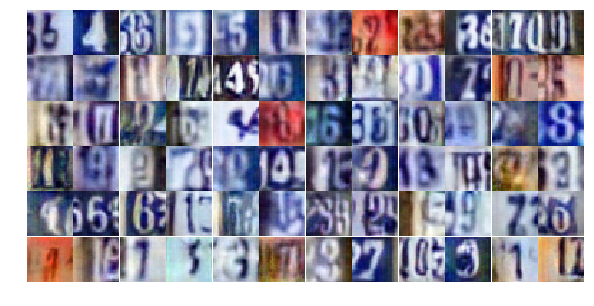

Epoch 21/25... Discriminator Loss: 0.9814... Generator Loss: 0.7397
Epoch 21/25... Discriminator Loss: 0.8485... Generator Loss: 0.8189
Epoch 21/25... Discriminator Loss: 1.2464... Generator Loss: 0.4828
Epoch 21/25... Discriminator Loss: 0.6230... Generator Loss: 1.0364
Epoch 21/25... Discriminator Loss: 0.7087... Generator Loss: 0.9790
Epoch 21/25... Discriminator Loss: 0.7000... Generator Loss: 0.9777
Epoch 21/25... Discriminator Loss: 0.7897... Generator Loss: 0.9365
Epoch 21/25... Discriminator Loss: 2.1291... Generator Loss: 0.1813
Epoch 21/25... Discriminator Loss: 1.3857... Generator Loss: 0.5352
Epoch 21/25... Discriminator Loss: 0.5238... Generator Loss: 3.2676


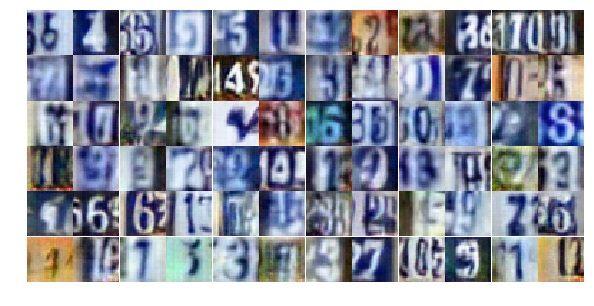

Epoch 21/25... Discriminator Loss: 0.7762... Generator Loss: 0.9393
Epoch 21/25... Discriminator Loss: 1.0758... Generator Loss: 0.6461
Epoch 21/25... Discriminator Loss: 0.5729... Generator Loss: 1.1791
Epoch 21/25... Discriminator Loss: 0.8272... Generator Loss: 0.9213
Epoch 21/25... Discriminator Loss: 0.3890... Generator Loss: 1.6325
Epoch 21/25... Discriminator Loss: 0.6891... Generator Loss: 1.0748
Epoch 21/25... Discriminator Loss: 1.1177... Generator Loss: 0.5901
Epoch 21/25... Discriminator Loss: 1.0343... Generator Loss: 0.7177
Epoch 21/25... Discriminator Loss: 1.0110... Generator Loss: 0.6647
Epoch 21/25... Discriminator Loss: 0.7813... Generator Loss: 0.9705


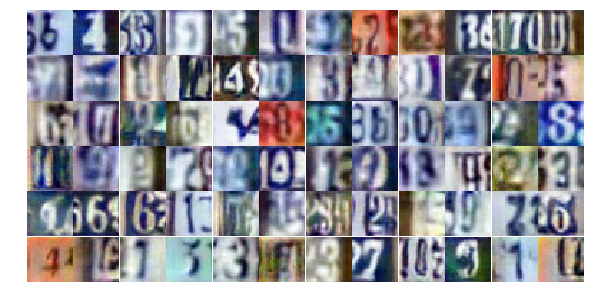

Epoch 21/25... Discriminator Loss: 0.6112... Generator Loss: 1.5047
Epoch 21/25... Discriminator Loss: 1.2093... Generator Loss: 0.5515
Epoch 21/25... Discriminator Loss: 0.6825... Generator Loss: 1.1326
Epoch 22/25... Discriminator Loss: 0.9672... Generator Loss: 2.5275
Epoch 22/25... Discriminator Loss: 0.8383... Generator Loss: 1.1479
Epoch 22/25... Discriminator Loss: 0.9982... Generator Loss: 0.6462
Epoch 22/25... Discriminator Loss: 0.5705... Generator Loss: 1.1699
Epoch 22/25... Discriminator Loss: 0.5275... Generator Loss: 1.2350
Epoch 22/25... Discriminator Loss: 1.0013... Generator Loss: 0.6703
Epoch 22/25... Discriminator Loss: 0.8475... Generator Loss: 0.8245


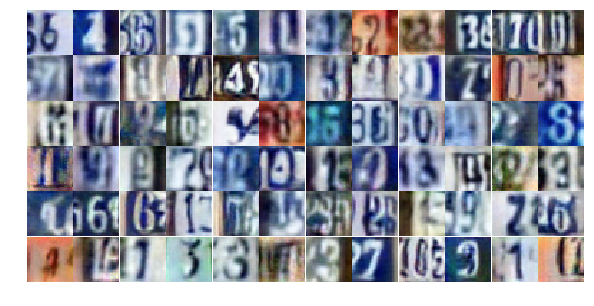

Epoch 22/25... Discriminator Loss: 0.4306... Generator Loss: 1.9193
Epoch 22/25... Discriminator Loss: 0.5948... Generator Loss: 1.2314
Epoch 22/25... Discriminator Loss: 1.5818... Generator Loss: 0.3760
Epoch 22/25... Discriminator Loss: 1.0444... Generator Loss: 0.6716
Epoch 22/25... Discriminator Loss: 1.1585... Generator Loss: 0.5114
Epoch 22/25... Discriminator Loss: 0.5592... Generator Loss: 2.8620
Epoch 22/25... Discriminator Loss: 0.7664... Generator Loss: 1.0127
Epoch 22/25... Discriminator Loss: 0.6866... Generator Loss: 0.9663
Epoch 22/25... Discriminator Loss: 0.7892... Generator Loss: 1.1237
Epoch 22/25... Discriminator Loss: 1.8901... Generator Loss: 0.2745


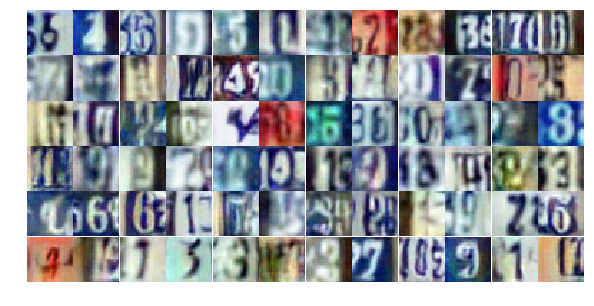

Epoch 22/25... Discriminator Loss: 0.7394... Generator Loss: 1.3735
Epoch 22/25... Discriminator Loss: 0.5452... Generator Loss: 1.4977
Epoch 22/25... Discriminator Loss: 0.8686... Generator Loss: 0.7947
Epoch 22/25... Discriminator Loss: 0.4414... Generator Loss: 2.6832
Epoch 22/25... Discriminator Loss: 0.4263... Generator Loss: 1.4689
Epoch 22/25... Discriminator Loss: 1.1021... Generator Loss: 0.6330
Epoch 22/25... Discriminator Loss: 0.6184... Generator Loss: 1.2101
Epoch 22/25... Discriminator Loss: 0.4029... Generator Loss: 1.6946
Epoch 22/25... Discriminator Loss: 0.5754... Generator Loss: 1.1717
Epoch 22/25... Discriminator Loss: 0.9927... Generator Loss: 0.7114


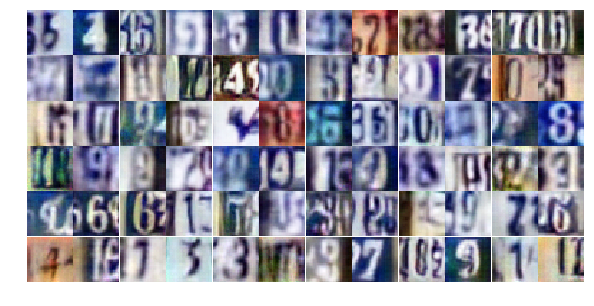

Epoch 22/25... Discriminator Loss: 0.3956... Generator Loss: 1.6849
Epoch 22/25... Discriminator Loss: 0.4488... Generator Loss: 2.0610
Epoch 22/25... Discriminator Loss: 0.8692... Generator Loss: 0.8939
Epoch 22/25... Discriminator Loss: 1.0408... Generator Loss: 0.6492
Epoch 22/25... Discriminator Loss: 1.0028... Generator Loss: 0.7241
Epoch 22/25... Discriminator Loss: 1.0527... Generator Loss: 0.6314
Epoch 22/25... Discriminator Loss: 1.9117... Generator Loss: 0.2258
Epoch 22/25... Discriminator Loss: 4.4345... Generator Loss: 0.0603
Epoch 22/25... Discriminator Loss: 1.1187... Generator Loss: 1.3206
Epoch 22/25... Discriminator Loss: 1.0083... Generator Loss: 0.9264


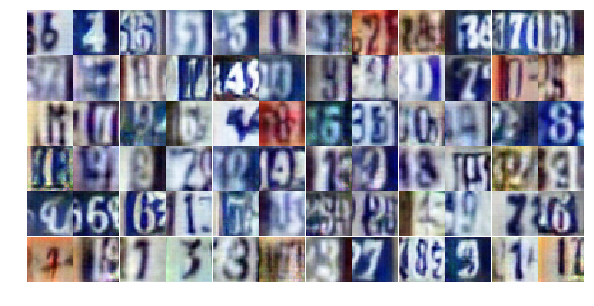

Epoch 22/25... Discriminator Loss: 0.8300... Generator Loss: 1.1571
Epoch 22/25... Discriminator Loss: 0.6091... Generator Loss: 1.3581
Epoch 22/25... Discriminator Loss: 0.4957... Generator Loss: 1.4190
Epoch 22/25... Discriminator Loss: 0.9195... Generator Loss: 0.7100
Epoch 22/25... Discriminator Loss: 0.5631... Generator Loss: 1.2119
Epoch 22/25... Discriminator Loss: 0.5855... Generator Loss: 1.1797
Epoch 22/25... Discriminator Loss: 0.7670... Generator Loss: 0.9039
Epoch 22/25... Discriminator Loss: 0.9518... Generator Loss: 0.7844
Epoch 22/25... Discriminator Loss: 1.0475... Generator Loss: 0.6996
Epoch 22/25... Discriminator Loss: 0.9405... Generator Loss: 0.7268


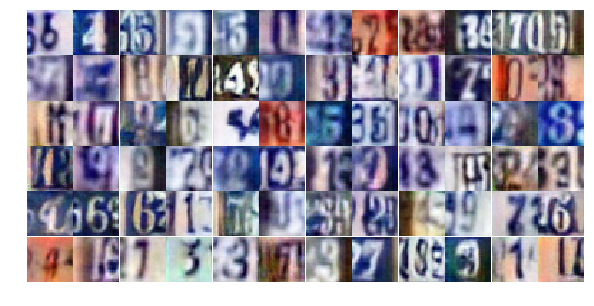

Epoch 22/25... Discriminator Loss: 1.2648... Generator Loss: 0.5327
Epoch 22/25... Discriminator Loss: 0.7257... Generator Loss: 0.9818
Epoch 22/25... Discriminator Loss: 0.9651... Generator Loss: 0.6689
Epoch 22/25... Discriminator Loss: 0.7645... Generator Loss: 1.0481
Epoch 22/25... Discriminator Loss: 1.0417... Generator Loss: 0.6311
Epoch 22/25... Discriminator Loss: 0.9229... Generator Loss: 0.7535
Epoch 22/25... Discriminator Loss: 0.8620... Generator Loss: 1.1510
Epoch 22/25... Discriminator Loss: 0.4882... Generator Loss: 1.3885
Epoch 22/25... Discriminator Loss: 1.5012... Generator Loss: 3.2360
Epoch 22/25... Discriminator Loss: 1.1717... Generator Loss: 0.6333


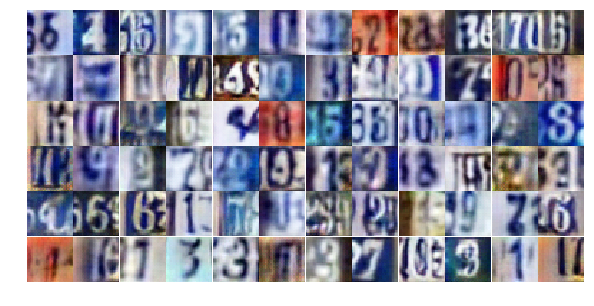

Epoch 23/25... Discriminator Loss: 0.6313... Generator Loss: 1.1119
Epoch 23/25... Discriminator Loss: 0.5028... Generator Loss: 1.2620
Epoch 23/25... Discriminator Loss: 1.1380... Generator Loss: 0.6060
Epoch 23/25... Discriminator Loss: 0.7527... Generator Loss: 0.8636
Epoch 23/25... Discriminator Loss: 0.6343... Generator Loss: 1.2357
Epoch 23/25... Discriminator Loss: 1.0280... Generator Loss: 1.1213
Epoch 23/25... Discriminator Loss: 1.4362... Generator Loss: 0.4046
Epoch 23/25... Discriminator Loss: 0.7340... Generator Loss: 1.0096
Epoch 23/25... Discriminator Loss: 0.4905... Generator Loss: 1.4759
Epoch 23/25... Discriminator Loss: 0.3477... Generator Loss: 1.8462


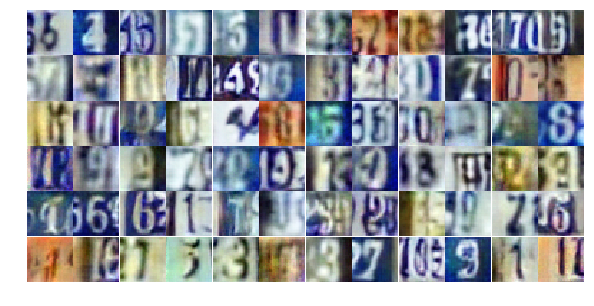

Epoch 23/25... Discriminator Loss: 0.5213... Generator Loss: 1.2559
Epoch 23/25... Discriminator Loss: 0.8033... Generator Loss: 0.7850
Epoch 23/25... Discriminator Loss: 0.5950... Generator Loss: 1.7359
Epoch 23/25... Discriminator Loss: 0.6331... Generator Loss: 1.2157
Epoch 23/25... Discriminator Loss: 0.5405... Generator Loss: 1.1857
Epoch 23/25... Discriminator Loss: 0.8439... Generator Loss: 0.8749
Epoch 23/25... Discriminator Loss: 0.7961... Generator Loss: 1.0610
Epoch 23/25... Discriminator Loss: 2.9250... Generator Loss: 0.1610
Epoch 23/25... Discriminator Loss: 1.2629... Generator Loss: 0.8286
Epoch 23/25... Discriminator Loss: 1.1420... Generator Loss: 0.5653


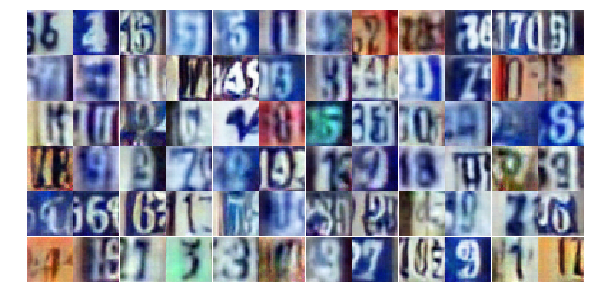

Epoch 23/25... Discriminator Loss: 1.0229... Generator Loss: 0.6737
Epoch 23/25... Discriminator Loss: 0.8909... Generator Loss: 0.8715
Epoch 23/25... Discriminator Loss: 0.9647... Generator Loss: 0.7371
Epoch 23/25... Discriminator Loss: 1.0203... Generator Loss: 0.6521
Epoch 23/25... Discriminator Loss: 0.9109... Generator Loss: 0.7715
Epoch 23/25... Discriminator Loss: 0.7357... Generator Loss: 1.0409
Epoch 23/25... Discriminator Loss: 0.6626... Generator Loss: 1.1269
Epoch 23/25... Discriminator Loss: 0.6219... Generator Loss: 1.1890
Epoch 23/25... Discriminator Loss: 0.6645... Generator Loss: 1.3820
Epoch 23/25... Discriminator Loss: 1.1212... Generator Loss: 0.7704


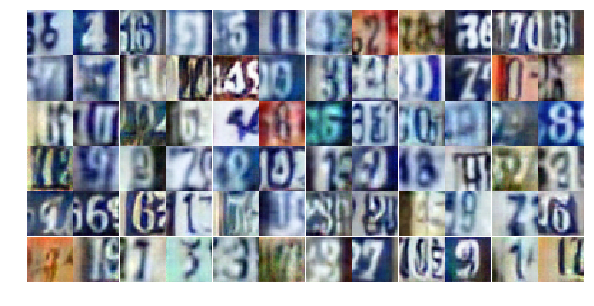

Epoch 23/25... Discriminator Loss: 0.5897... Generator Loss: 1.2279
Epoch 23/25... Discriminator Loss: 0.6470... Generator Loss: 1.0392
Epoch 23/25... Discriminator Loss: 0.6425... Generator Loss: 1.2507
Epoch 23/25... Discriminator Loss: 1.3666... Generator Loss: 0.4424
Epoch 23/25... Discriminator Loss: 0.7418... Generator Loss: 1.1327
Epoch 23/25... Discriminator Loss: 0.9402... Generator Loss: 0.7680
Epoch 23/25... Discriminator Loss: 1.3855... Generator Loss: 0.4408
Epoch 23/25... Discriminator Loss: 0.6635... Generator Loss: 1.0670
Epoch 23/25... Discriminator Loss: 0.4154... Generator Loss: 1.7979
Epoch 23/25... Discriminator Loss: 0.5808... Generator Loss: 1.3973


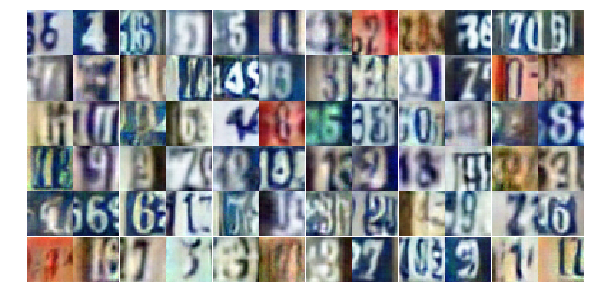

Epoch 23/25... Discriminator Loss: 0.8596... Generator Loss: 0.8401
Epoch 23/25... Discriminator Loss: 0.7975... Generator Loss: 0.8523
Epoch 23/25... Discriminator Loss: 1.0981... Generator Loss: 0.5801
Epoch 23/25... Discriminator Loss: 0.6045... Generator Loss: 1.2507
Epoch 23/25... Discriminator Loss: 0.6938... Generator Loss: 1.1937
Epoch 23/25... Discriminator Loss: 1.0440... Generator Loss: 0.7542
Epoch 23/25... Discriminator Loss: 0.6844... Generator Loss: 0.9958
Epoch 23/25... Discriminator Loss: 1.0673... Generator Loss: 0.5717
Epoch 23/25... Discriminator Loss: 0.6175... Generator Loss: 1.1969
Epoch 23/25... Discriminator Loss: 0.5645... Generator Loss: 1.2478


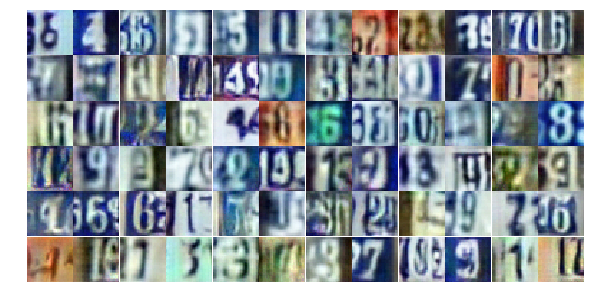

Epoch 23/25... Discriminator Loss: 0.6730... Generator Loss: 1.0597
Epoch 23/25... Discriminator Loss: 1.2710... Generator Loss: 0.4898
Epoch 23/25... Discriminator Loss: 1.3544... Generator Loss: 0.4740
Epoch 23/25... Discriminator Loss: 0.4273... Generator Loss: 1.4627
Epoch 23/25... Discriminator Loss: 1.4625... Generator Loss: 0.4380
Epoch 23/25... Discriminator Loss: 0.6289... Generator Loss: 1.3226
Epoch 23/25... Discriminator Loss: 0.8529... Generator Loss: 0.7681
Epoch 24/25... Discriminator Loss: 1.0539... Generator Loss: 0.6764
Epoch 24/25... Discriminator Loss: 0.7378... Generator Loss: 1.0313
Epoch 24/25... Discriminator Loss: 1.2560... Generator Loss: 0.4624


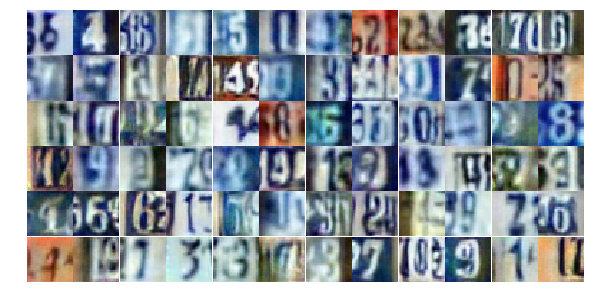

Epoch 24/25... Discriminator Loss: 0.5233... Generator Loss: 1.4293
Epoch 24/25... Discriminator Loss: 0.6937... Generator Loss: 0.9930
Epoch 24/25... Discriminator Loss: 0.5156... Generator Loss: 1.3930
Epoch 24/25... Discriminator Loss: 0.7727... Generator Loss: 1.1779
Epoch 24/25... Discriminator Loss: 0.6785... Generator Loss: 0.9991
Epoch 24/25... Discriminator Loss: 0.5249... Generator Loss: 1.4917
Epoch 24/25... Discriminator Loss: 0.8297... Generator Loss: 0.9126
Epoch 24/25... Discriminator Loss: 1.1867... Generator Loss: 0.4901
Epoch 24/25... Discriminator Loss: 0.3988... Generator Loss: 1.5461
Epoch 24/25... Discriminator Loss: 0.3875... Generator Loss: 1.7750


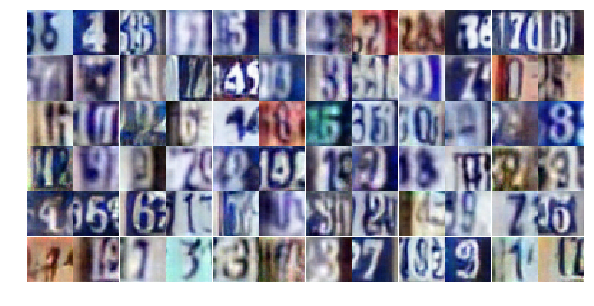

Epoch 24/25... Discriminator Loss: 0.9533... Generator Loss: 0.8053
Epoch 24/25... Discriminator Loss: 1.0310... Generator Loss: 0.7305
Epoch 24/25... Discriminator Loss: 1.7584... Generator Loss: 0.3325
Epoch 24/25... Discriminator Loss: 0.9595... Generator Loss: 0.6432
Epoch 24/25... Discriminator Loss: 0.6542... Generator Loss: 1.9565
Epoch 24/25... Discriminator Loss: 1.1832... Generator Loss: 0.5612
Epoch 24/25... Discriminator Loss: 0.4698... Generator Loss: 1.7762
Epoch 24/25... Discriminator Loss: 1.3343... Generator Loss: 0.4926
Epoch 24/25... Discriminator Loss: 0.6355... Generator Loss: 1.3611
Epoch 24/25... Discriminator Loss: 0.7225... Generator Loss: 1.0406


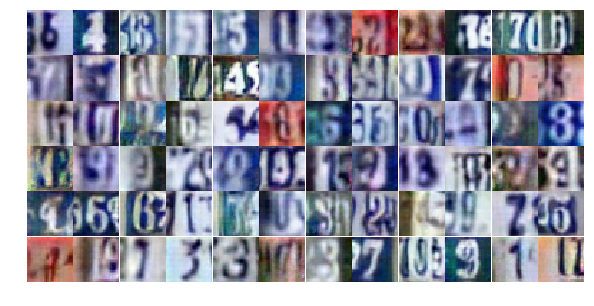

Epoch 24/25... Discriminator Loss: 1.2560... Generator Loss: 0.5400
Epoch 24/25... Discriminator Loss: 0.7761... Generator Loss: 0.9106
Epoch 24/25... Discriminator Loss: 0.6404... Generator Loss: 1.3788
Epoch 24/25... Discriminator Loss: 1.4786... Generator Loss: 0.5648
Epoch 24/25... Discriminator Loss: 0.6880... Generator Loss: 0.9441
Epoch 24/25... Discriminator Loss: 0.6046... Generator Loss: 1.1321
Epoch 24/25... Discriminator Loss: 0.5607... Generator Loss: 1.1460
Epoch 24/25... Discriminator Loss: 0.6773... Generator Loss: 1.0679
Epoch 24/25... Discriminator Loss: 0.9756... Generator Loss: 0.6977
Epoch 24/25... Discriminator Loss: 0.8384... Generator Loss: 0.8044


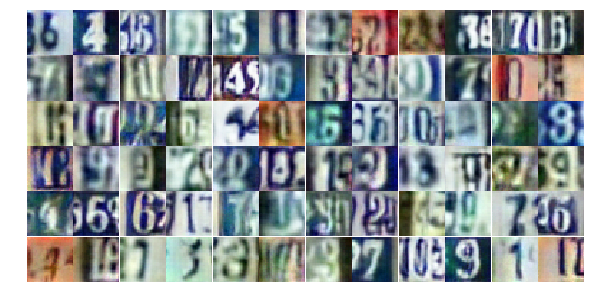

Epoch 24/25... Discriminator Loss: 0.5999... Generator Loss: 3.3465
Epoch 24/25... Discriminator Loss: 0.4214... Generator Loss: 3.3265
Epoch 24/25... Discriminator Loss: 0.9389... Generator Loss: 0.7574
Epoch 24/25... Discriminator Loss: 1.9981... Generator Loss: 0.2478
Epoch 24/25... Discriminator Loss: 0.8285... Generator Loss: 1.0072
Epoch 24/25... Discriminator Loss: 0.6381... Generator Loss: 1.0101
Epoch 24/25... Discriminator Loss: 1.1966... Generator Loss: 0.5784
Epoch 24/25... Discriminator Loss: 1.5753... Generator Loss: 0.4266
Epoch 24/25... Discriminator Loss: 0.7355... Generator Loss: 1.0454
Epoch 24/25... Discriminator Loss: 0.5495... Generator Loss: 1.4650


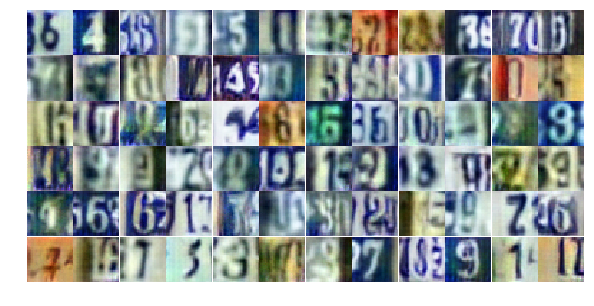

Epoch 24/25... Discriminator Loss: 0.9311... Generator Loss: 0.7219
Epoch 24/25... Discriminator Loss: 1.9165... Generator Loss: 0.3084
Epoch 24/25... Discriminator Loss: 3.6583... Generator Loss: 0.0940
Epoch 24/25... Discriminator Loss: 2.4434... Generator Loss: 3.8856
Epoch 24/25... Discriminator Loss: 1.7651... Generator Loss: 0.3328
Epoch 24/25... Discriminator Loss: 0.7681... Generator Loss: 1.3231
Epoch 24/25... Discriminator Loss: 1.0452... Generator Loss: 0.6635
Epoch 24/25... Discriminator Loss: 0.6268... Generator Loss: 1.2227
Epoch 24/25... Discriminator Loss: 1.0529... Generator Loss: 0.6044
Epoch 24/25... Discriminator Loss: 1.2178... Generator Loss: 0.5847


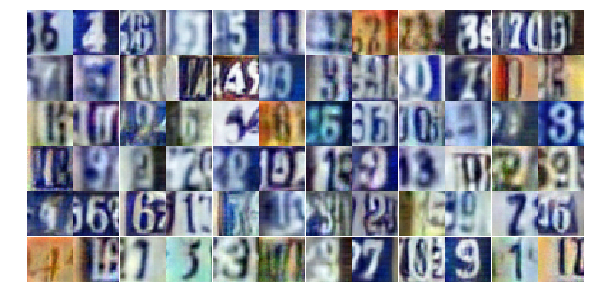

Epoch 24/25... Discriminator Loss: 1.1036... Generator Loss: 0.5798
Epoch 24/25... Discriminator Loss: 1.5237... Generator Loss: 0.4103
Epoch 24/25... Discriminator Loss: 0.8861... Generator Loss: 0.8469
Epoch 24/25... Discriminator Loss: 0.8297... Generator Loss: 0.8931
Epoch 24/25... Discriminator Loss: 1.3447... Generator Loss: 0.4368
Epoch 25/25... Discriminator Loss: 1.1234... Generator Loss: 0.6707
Epoch 25/25... Discriminator Loss: 0.5645... Generator Loss: 1.7040
Epoch 25/25... Discriminator Loss: 1.1358... Generator Loss: 0.5411
Epoch 25/25... Discriminator Loss: 0.8405... Generator Loss: 0.8583
Epoch 25/25... Discriminator Loss: 0.8828... Generator Loss: 0.7857


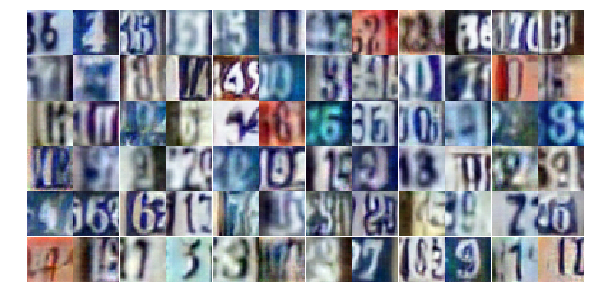

Epoch 25/25... Discriminator Loss: 1.1050... Generator Loss: 0.6119
Epoch 25/25... Discriminator Loss: 1.1357... Generator Loss: 0.5511
Epoch 25/25... Discriminator Loss: 0.5559... Generator Loss: 1.2699
Epoch 25/25... Discriminator Loss: 0.6735... Generator Loss: 1.0207
Epoch 25/25... Discriminator Loss: 0.9481... Generator Loss: 2.0515
Epoch 25/25... Discriminator Loss: 1.1020... Generator Loss: 0.5636
Epoch 25/25... Discriminator Loss: 0.8776... Generator Loss: 0.7867
Epoch 25/25... Discriminator Loss: 0.5503... Generator Loss: 1.6697
Epoch 25/25... Discriminator Loss: 0.5370... Generator Loss: 1.2638
Epoch 25/25... Discriminator Loss: 1.0839... Generator Loss: 0.6200


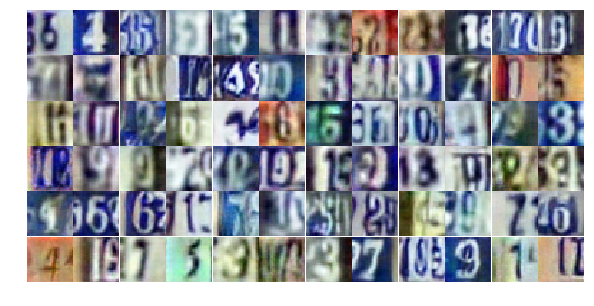

Epoch 25/25... Discriminator Loss: 0.7762... Generator Loss: 1.3741
Epoch 25/25... Discriminator Loss: 0.3930... Generator Loss: 1.7821
Epoch 25/25... Discriminator Loss: 1.1962... Generator Loss: 0.5922
Epoch 25/25... Discriminator Loss: 0.7888... Generator Loss: 0.8784
Epoch 25/25... Discriminator Loss: 0.7574... Generator Loss: 1.5478
Epoch 25/25... Discriminator Loss: 0.5969... Generator Loss: 1.2087
Epoch 25/25... Discriminator Loss: 0.9292... Generator Loss: 1.1447
Epoch 25/25... Discriminator Loss: 1.3541... Generator Loss: 0.4601
Epoch 25/25... Discriminator Loss: 0.4837... Generator Loss: 1.5863
Epoch 25/25... Discriminator Loss: 0.8978... Generator Loss: 0.8211


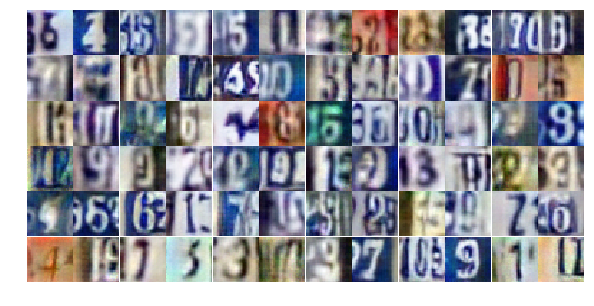

Epoch 25/25... Discriminator Loss: 0.7718... Generator Loss: 0.9255
Epoch 25/25... Discriminator Loss: 0.7702... Generator Loss: 0.8377
Epoch 25/25... Discriminator Loss: 1.5205... Generator Loss: 0.5479
Epoch 25/25... Discriminator Loss: 1.2057... Generator Loss: 0.5198
Epoch 25/25... Discriminator Loss: 0.8770... Generator Loss: 0.9404
Epoch 25/25... Discriminator Loss: 0.5461... Generator Loss: 1.2501
Epoch 25/25... Discriminator Loss: 0.8892... Generator Loss: 0.8112
Epoch 25/25... Discriminator Loss: 0.6629... Generator Loss: 1.1149
Epoch 25/25... Discriminator Loss: 0.9244... Generator Loss: 0.9575
Epoch 25/25... Discriminator Loss: 0.4746... Generator Loss: 1.6206


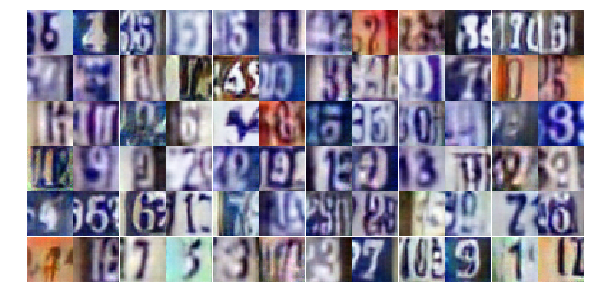

Epoch 25/25... Discriminator Loss: 1.0246... Generator Loss: 0.6579
Epoch 25/25... Discriminator Loss: 0.8221... Generator Loss: 0.7982
Epoch 25/25... Discriminator Loss: 0.7291... Generator Loss: 1.2509
Epoch 25/25... Discriminator Loss: 0.8479... Generator Loss: 0.7649
Epoch 25/25... Discriminator Loss: 1.4131... Generator Loss: 0.5023
Epoch 25/25... Discriminator Loss: 0.9118... Generator Loss: 0.7222
Epoch 25/25... Discriminator Loss: 0.6738... Generator Loss: 1.0431
Epoch 25/25... Discriminator Loss: 0.5216... Generator Loss: 1.3852
Epoch 25/25... Discriminator Loss: 1.7778... Generator Loss: 0.2984
Epoch 25/25... Discriminator Loss: 0.3812... Generator Loss: 2.2682


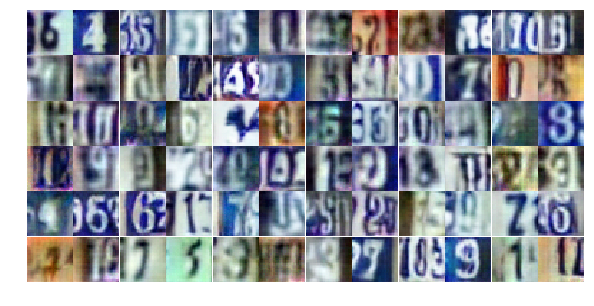

Epoch 25/25... Discriminator Loss: 0.8325... Generator Loss: 1.5604
Epoch 25/25... Discriminator Loss: 0.7370... Generator Loss: 0.9279
Epoch 25/25... Discriminator Loss: 0.9295... Generator Loss: 0.6617
Epoch 25/25... Discriminator Loss: 1.0038... Generator Loss: 0.6455
Epoch 25/25... Discriminator Loss: 0.9924... Generator Loss: 0.7168
Epoch 25/25... Discriminator Loss: 0.4866... Generator Loss: 1.3517
Epoch 25/25... Discriminator Loss: 1.2236... Generator Loss: 0.4963
Epoch 25/25... Discriminator Loss: 0.8052... Generator Loss: 0.9249
Epoch 25/25... Discriminator Loss: 0.8404... Generator Loss: 0.8268
Epoch 25/25... Discriminator Loss: 1.0509... Generator Loss: 0.6288


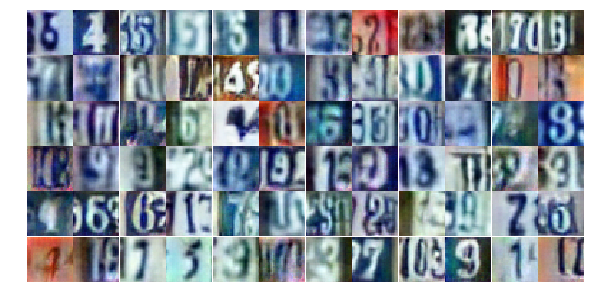

Epoch 25/25... Discriminator Loss: 0.4531... Generator Loss: 1.4990
Epoch 25/25... Discriminator Loss: 1.5291... Generator Loss: 0.3725


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

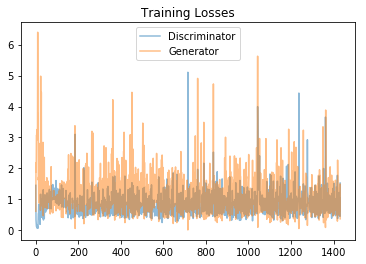

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

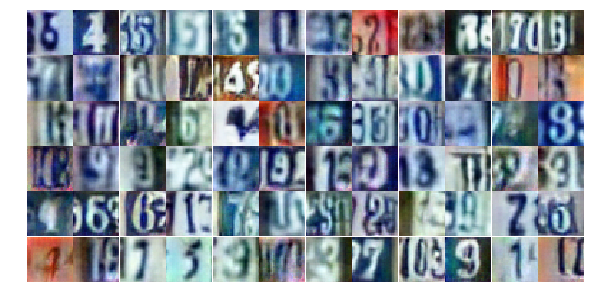

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))